In [1]:
import xarray as xr
import xarray.ufuncs as xu

import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

import rasterio

In [2]:

%matplotlib notebook


In [3]:
fn = '/media/rag110/RGFell_UC1/RGF/RGF_phd/Results/Borchgrevink_north/Parker_IT/parkerIT_ice_vel.nc'
ds = xr.open_dataset(fn)

/home/UOCNT/rag110/anaconda3/envs/GIS/lib/python3.6/site-packages/xarray/backends/plugins.py:61: RuntimeWarning: Engine 'rasterio' loading failed:
module 'contextlib' has no attribute 'nullcontext'
  warnings.warn(f"Engine {name!r} loading failed:\n{ex}", RuntimeWarning)


In [4]:
print(ds)

<xarray.Dataset>
Dimensions:   (easting: 230, northing: 125, time: 101)
Coordinates:
  * time      (time) datetime64[ns] 2017-02-05 2017-02-17 ... 2020-07-19
  * northing  (northing) float32 -1.707e+06 -1.707e+06 ... -1.719e+06 -1.719e+06
  * easting   (easting) float32 4.208e+05 4.209e+05 ... 4.436e+05 4.437e+05
Data variables:
    gr        (time, northing, easting) float32 ...
    az        (time, northing, easting) float32 ...
    vel       (time, northing, easting) float32 ...
Attributes:
    subtitle:  Parker_IT surface velocity data
    info:      Data has been smooth passing a 8x8 median filter twice, resamp...


In [5]:
ds.time.sel(time='2020-02')

<xarray.DataArray 'time' (time: 3)>
array(['2020-02-02T00:00:00.000000000', '2020-02-14T00:00:00.000000000',
       '2020-02-26T00:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 2020-02-02 2020-02-14 2020-02-26
Attributes:
    long_name:  time

In [6]:
ds.time.tail()

<xarray.DataArray 'time' (time: 5)>
array(['2020-04-02T00:00:00.000000000', '2020-04-14T00:00:00.000000000',
       '2020-06-25T00:00:00.000000000', '2020-07-07T00:00:00.000000000',
       '2020-07-19T00:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 2020-04-02 2020-04-14 ... 2020-07-19
Attributes:
    long_name:  time

In [7]:
ds.vel[:,:,:] = xu.sqrt(ds.gr**2+ds.az**2)

<IPython.core.display.Javascript object>


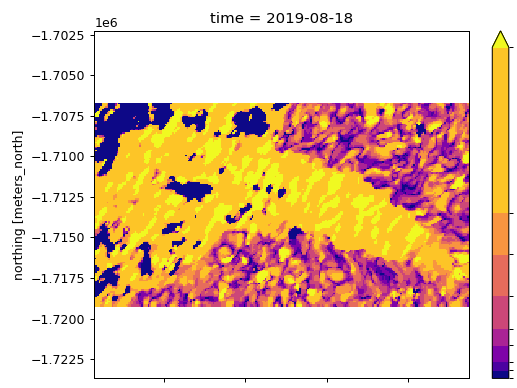

In [8]:
cmap = mpl.cm.plasma
levels = [0,5,10,20,30,50,75,100,200]

fig= plt.figure()

ax = plt.gca()
ds.vel.isel(time=77).plot(levels=levels,
                         cmap = cmap,
                         cbar_kwargs={'ticks': levels,
                                     'spacing': 'proportional',
                                     'label':'Velocity meters/year'})

plt.axis('equal')
plt.tight_layout()

plt.show()

<IPython.core.display.Javascript object>


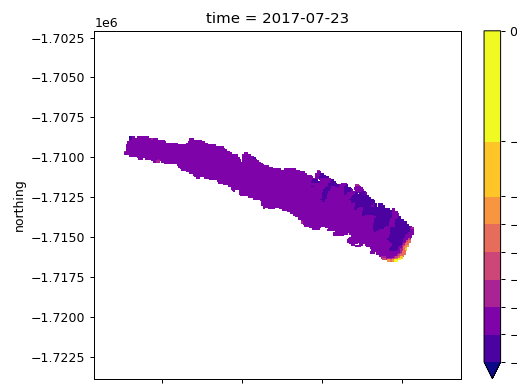

In [9]:

vfn = '/home/UOCNT/rag110/Dropbox/UC_files/VLC_images/polygons/Parker_IT_2018.geojson'
mfn = '/mnt/data1/masks/Parker_IT_mask.tif'

img = rasterio.open(mfn)
raster = img.read(1)
raster_masked = np.ma.masked_where(raster==0, raster)
ds_masked = ds*raster
ds_masked = xr.where(ds_masked.gr == 0, np.nan, ds_masked)
ds_masked = xr.where(ds_masked.az == 0, np.nan, ds_masked)
ds_masked = xr.where(ds_masked.vel == 0, np.nan, ds_masked)

cmap = mpl.cm.plasma
levels = [0,-80,-120,-140,-160,-180,-200,-220,-240]

fig= plt.figure()

ax = plt.gca()
ds_masked.gr.isel(time=14).plot(levels=levels,
                         cmap = cmap,
                         cbar_kwargs={'ticks': levels,
                                     'spacing': 'proportional',
                                     'label':'Velocity meters/year'})

plt.axis('equal')
plt.tight_layout()

plt.show()

In [22]:
ds_masked.to_netcdf("PIT_surface_velocities_2017-02_2020-02.nc")

<IPython.core.display.Javascript object>


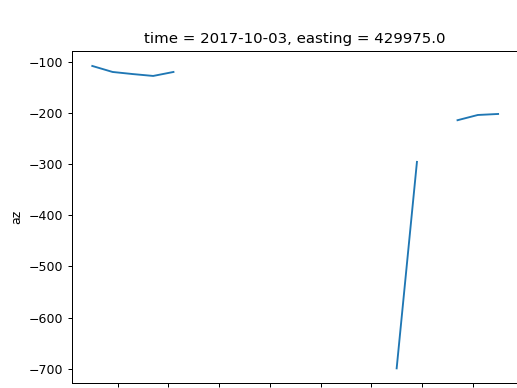

In [10]:
fig= plt.figure()

ds_masked.isel(time=20).sel(easting=430000, method='nearest').az.plot()
plt.show()

In [13]:
ds_masked.sel(easting=430000, northing=-1712200, method='nearest').vel.rolling(time=4).mean().plot()

ValueError: Date ordinal -1820180.0 converts to -3014-07-08T00:00:00.000000 (using epoch 1970-01-01T00:00:00), but Matplotlib dates must be between year 0001 and 9999.

In [18]:
np.datetime_as_string(ds.time[0].values)[0:10]

'2017-02-05'

In [19]:
for i, img in enumerate(ds.time):
    date = np.datetime_as_string(img.values)[0:10]

    cmap = mpl.cm.viridis
    levels = [0,50,100,120,140,160,180,200,220,240]
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N, extend='both')

    fig= plt.figure(figsize=(12,6))

    ax = plt.gca()
    ds.vel.isel(time=i).plot(levels=levels, cbar_kwargs={'ticks': levels,
                                                   'spacing': 'proportional',
                                                         'label':'Velocity meters/year'})

    plt.axis('equal')
    plt.tight_layout()

    
    plt.savefig(f'/media/rag110/RGFell_UC1/RGF/RGF_phd/Results/Borchgrevink_north/Parker_IT/{date}_velocity_Parker_IT.png')

NameError: name 'bounds' is not defined

<IPython.core.display.Javascript object>


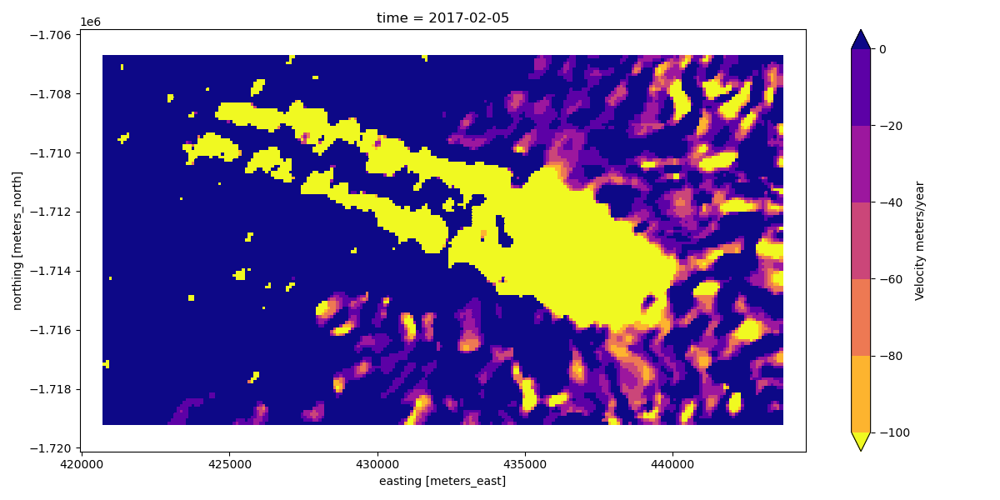

<IPython.core.display.Javascript object>


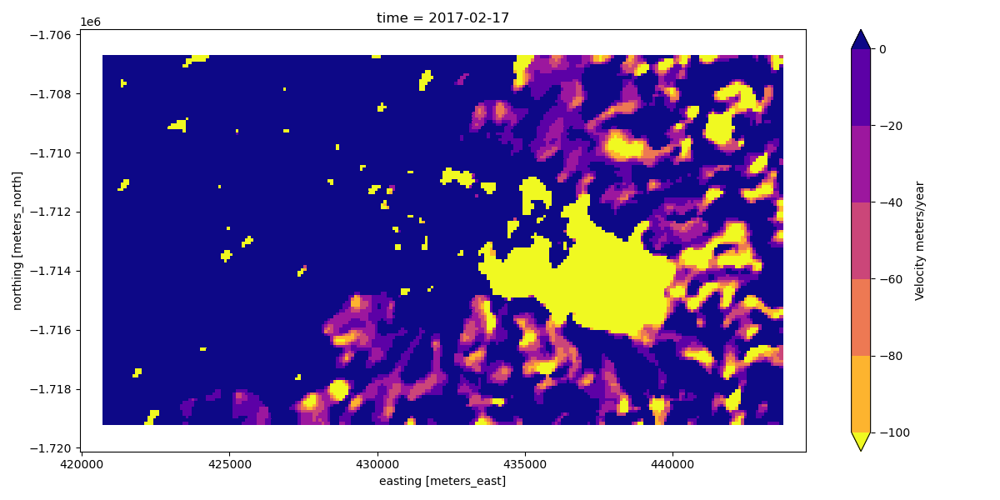

<IPython.core.display.Javascript object>


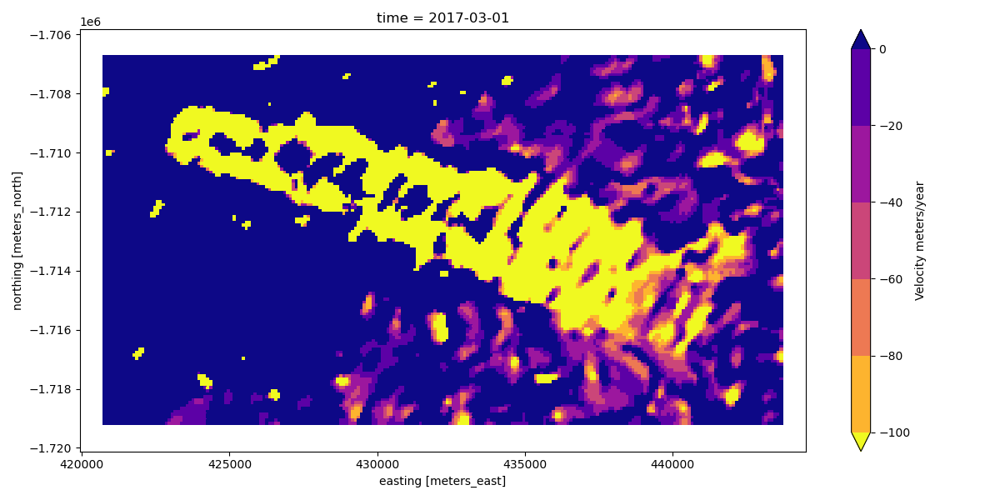

<IPython.core.display.Javascript object>


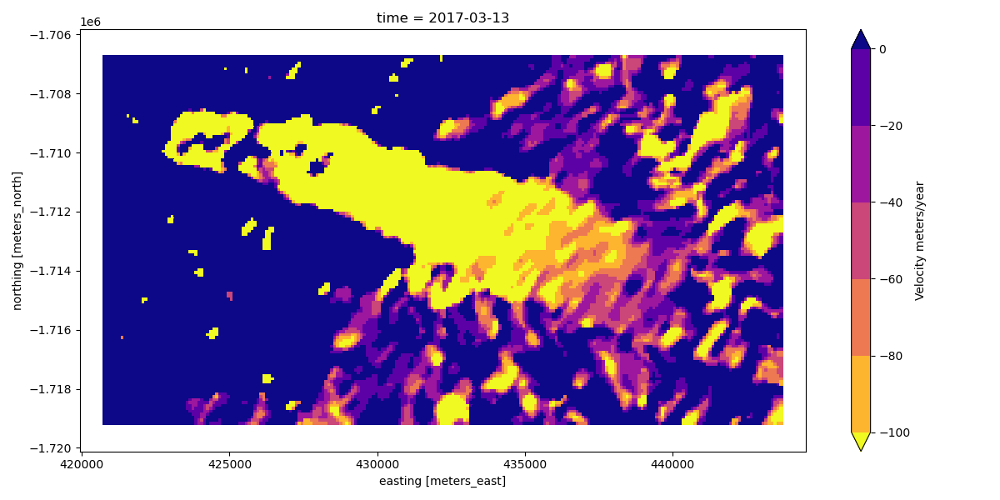

<IPython.core.display.Javascript object>


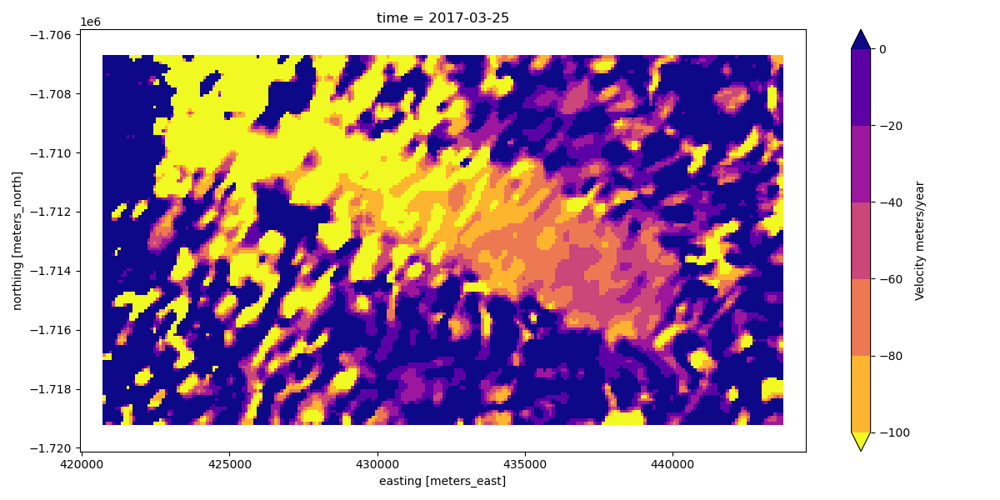

<IPython.core.display.Javascript object>


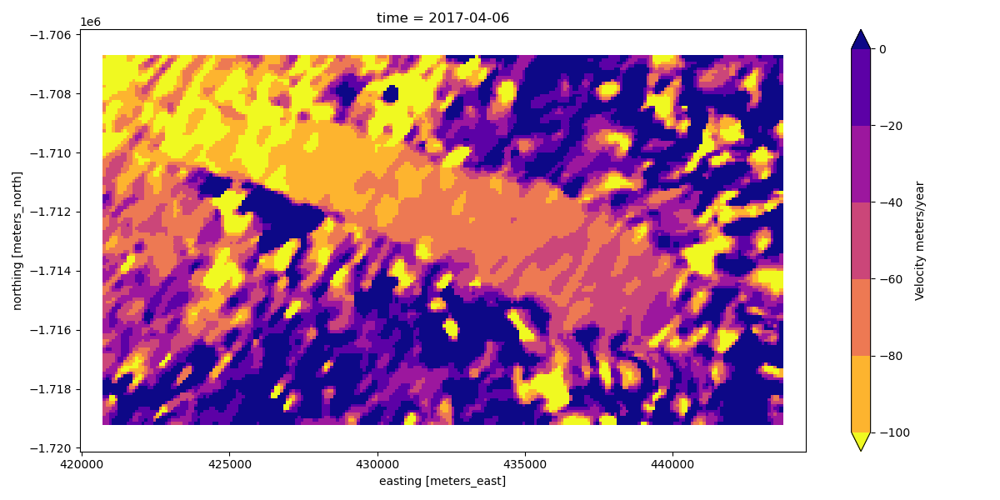

<IPython.core.display.Javascript object>


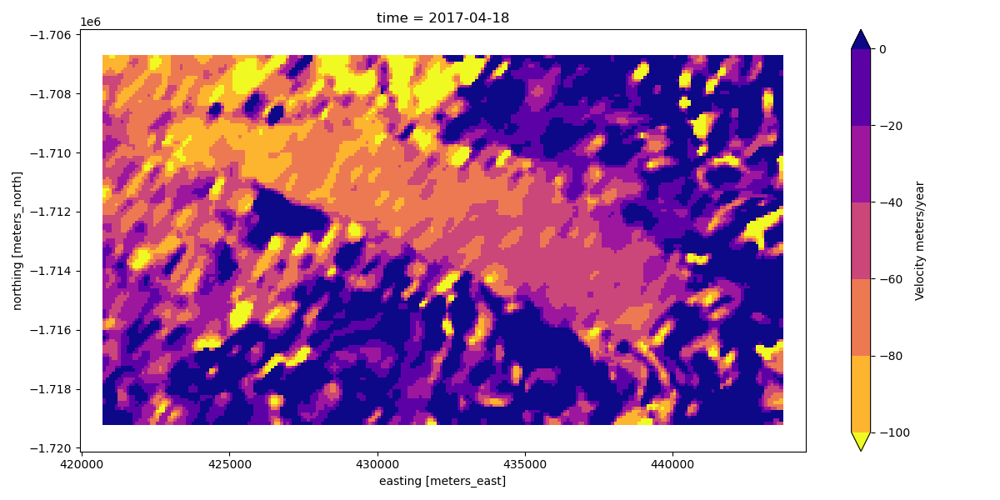

<IPython.core.display.Javascript object>


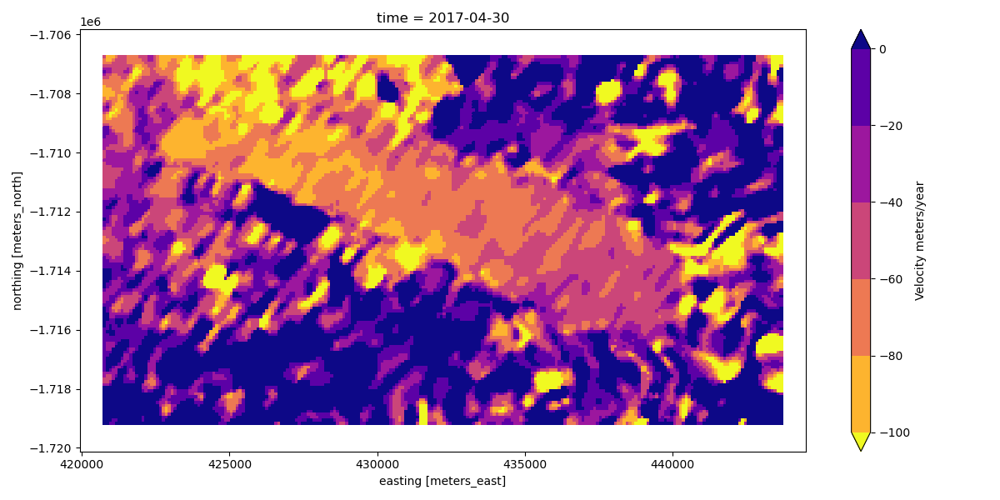

<IPython.core.display.Javascript object>


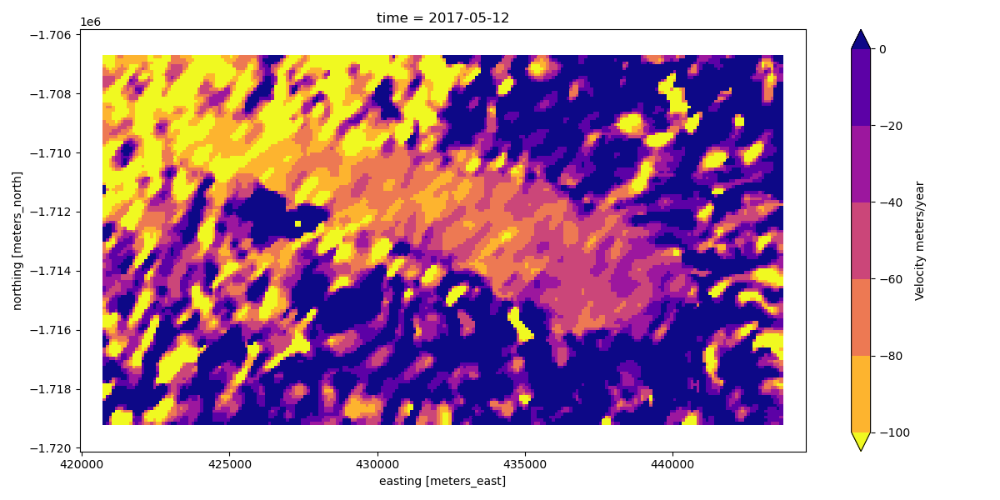

<IPython.core.display.Javascript object>


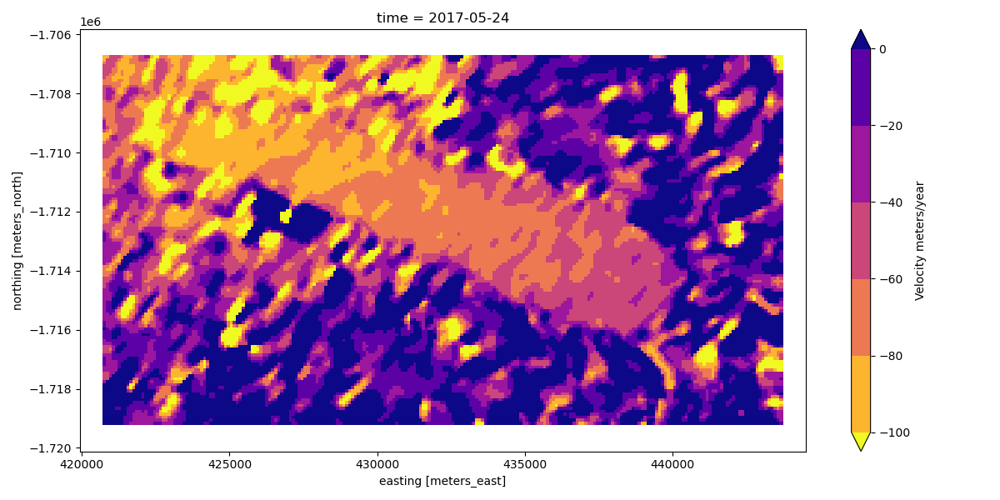

<IPython.core.display.Javascript object>


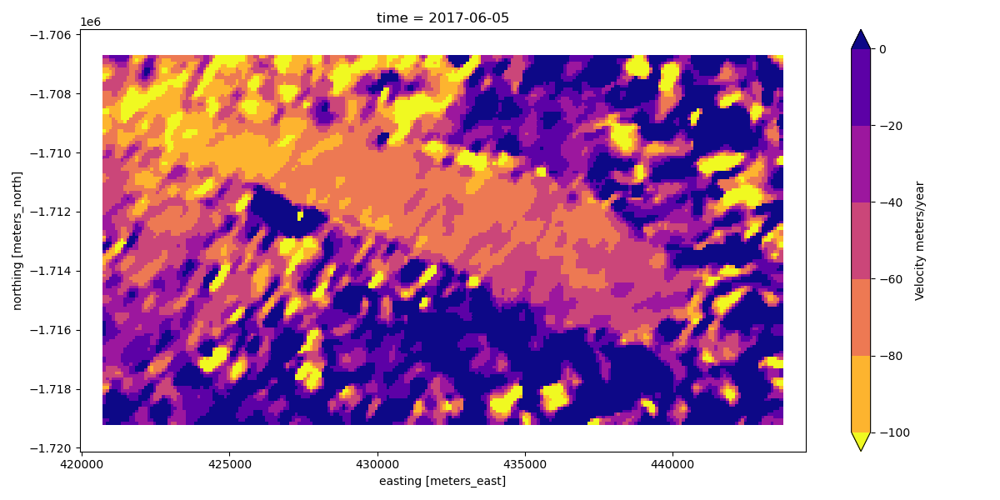

<IPython.core.display.Javascript object>


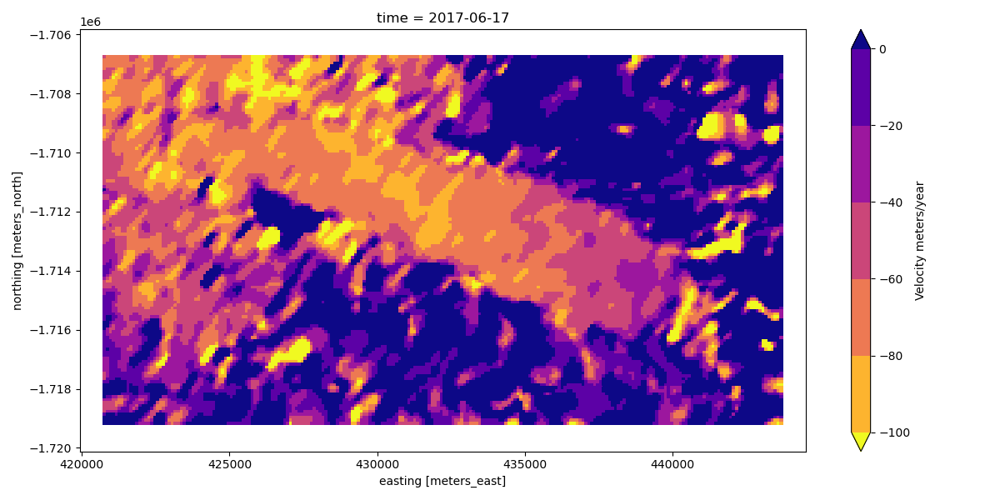

<IPython.core.display.Javascript object>


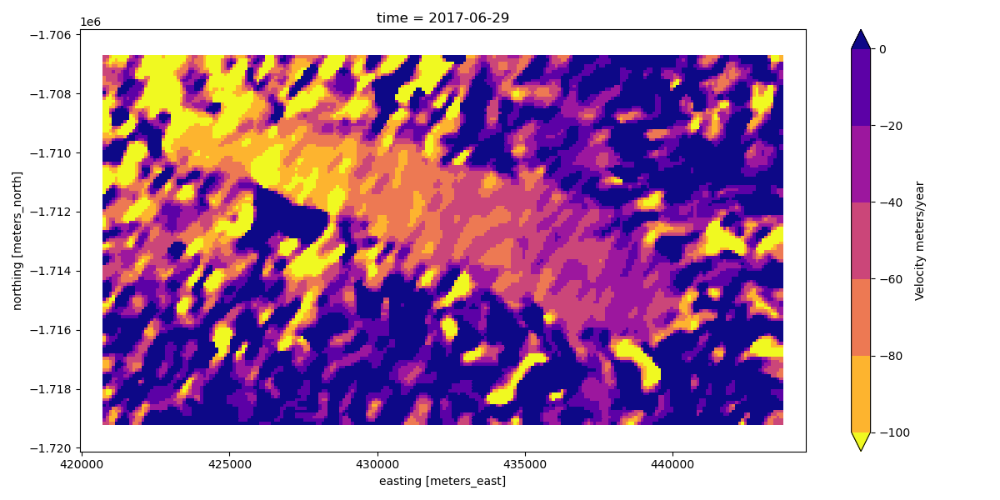

<IPython.core.display.Javascript object>


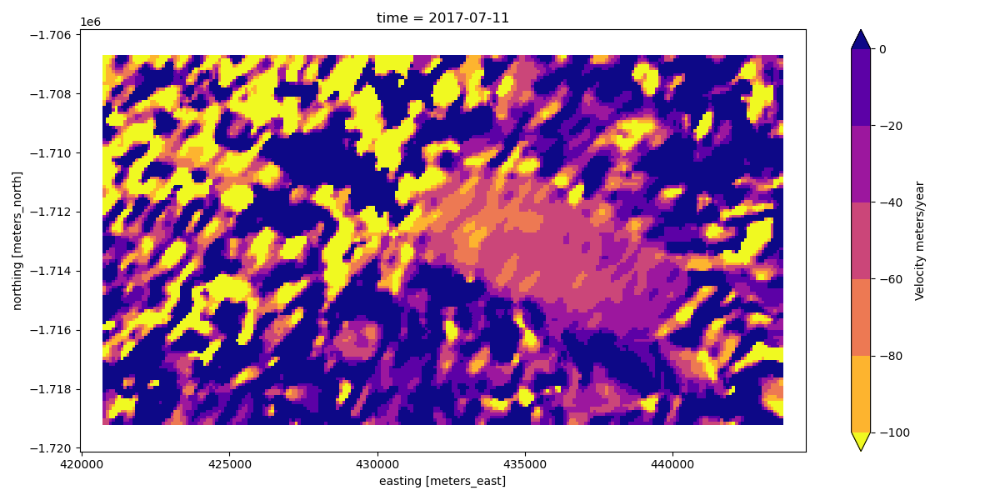

<IPython.core.display.Javascript object>


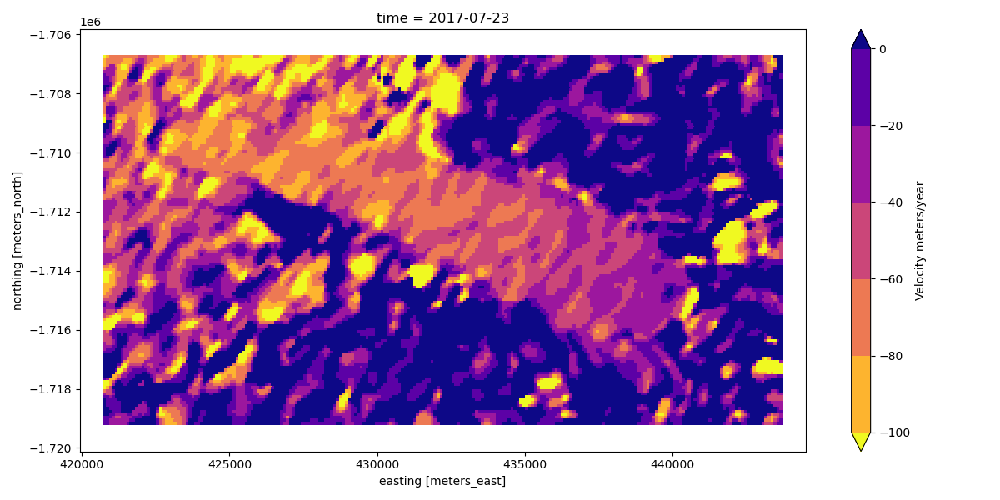

<IPython.core.display.Javascript object>


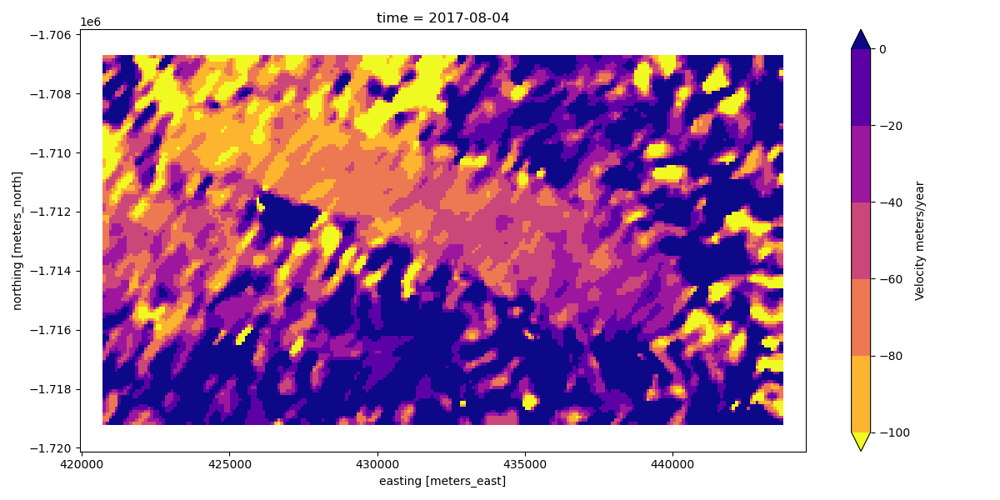

<IPython.core.display.Javascript object>


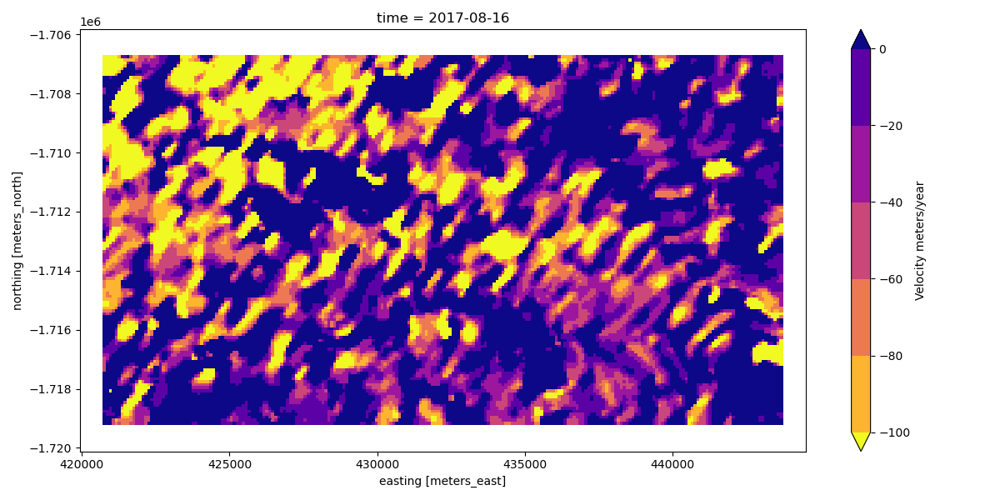

<IPython.core.display.Javascript object>


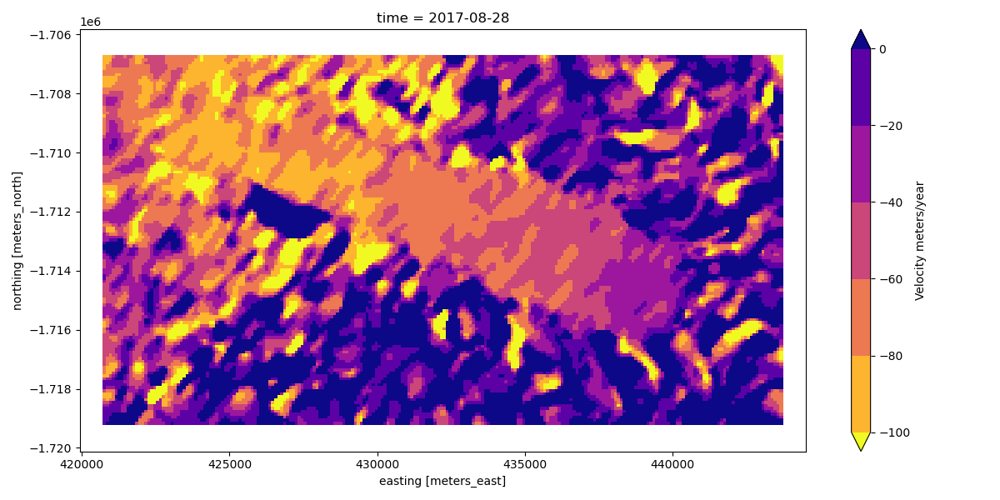

/home/UOCNT/rag110/anaconda3/envs/GIS/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


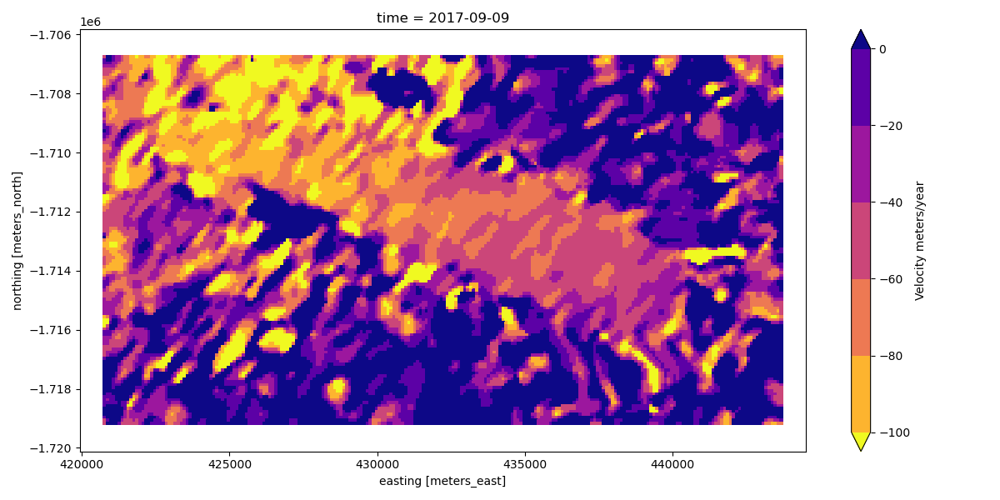

<IPython.core.display.Javascript object>


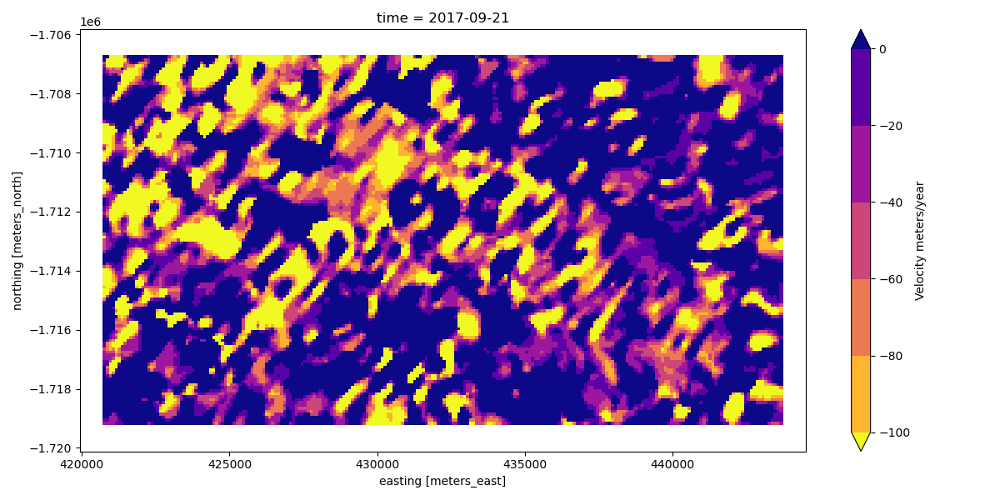

<IPython.core.display.Javascript object>


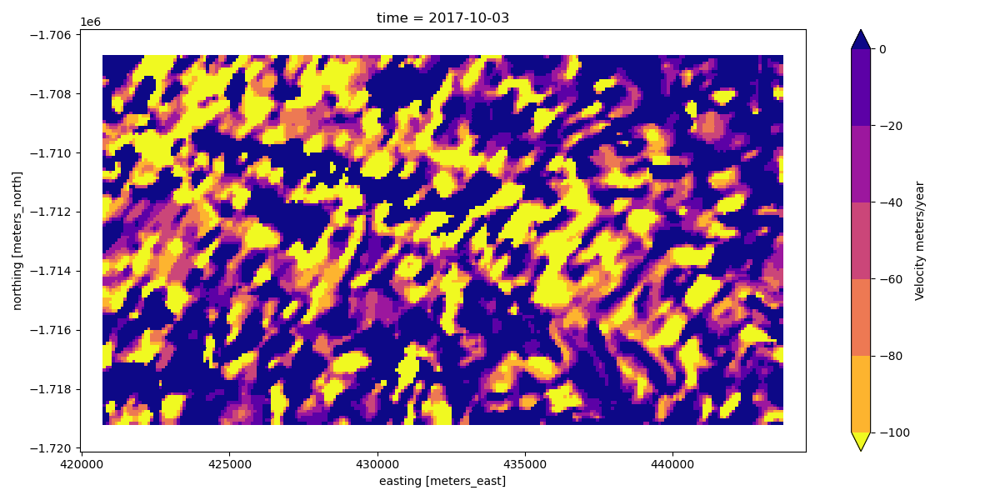

<IPython.core.display.Javascript object>


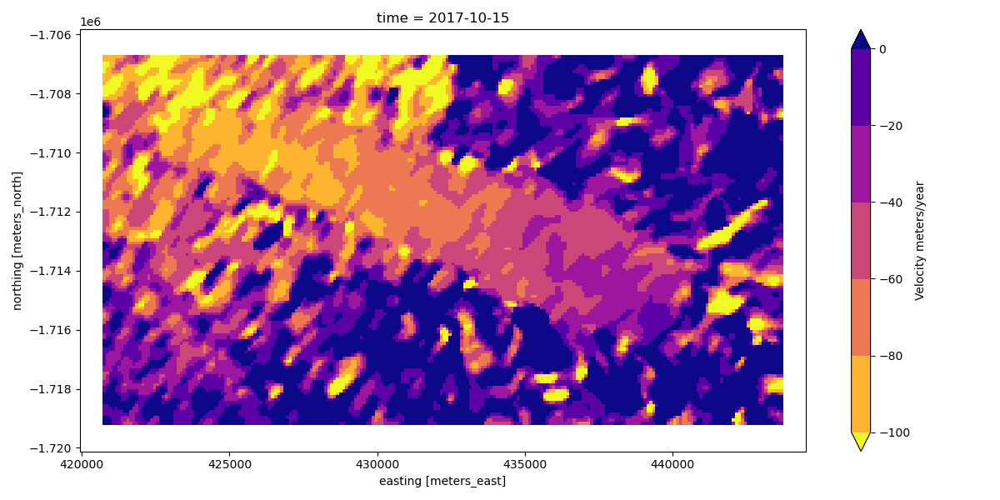

<IPython.core.display.Javascript object>


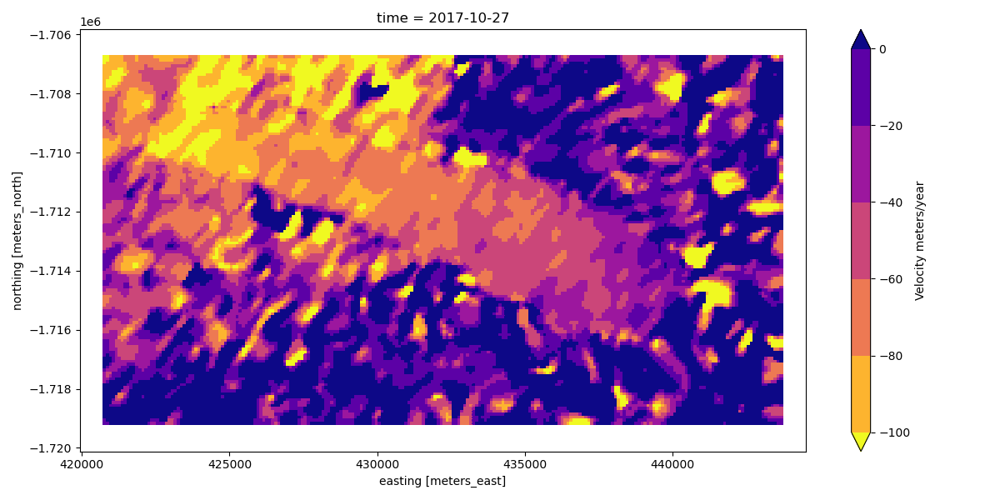

<IPython.core.display.Javascript object>


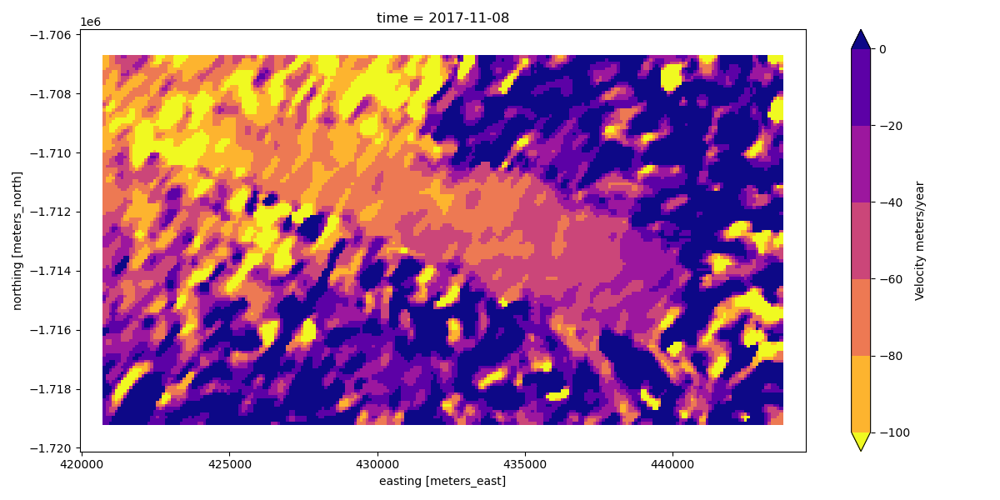

<IPython.core.display.Javascript object>


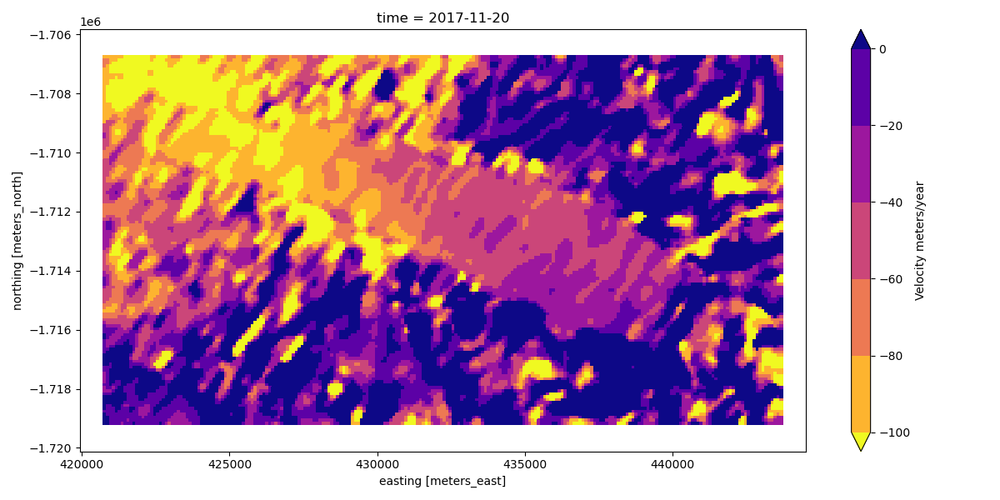

<IPython.core.display.Javascript object>


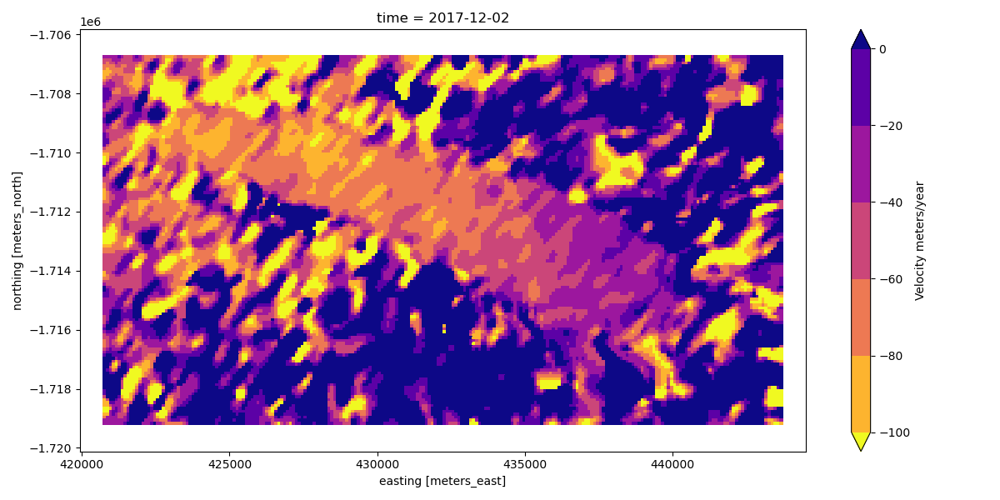

<IPython.core.display.Javascript object>


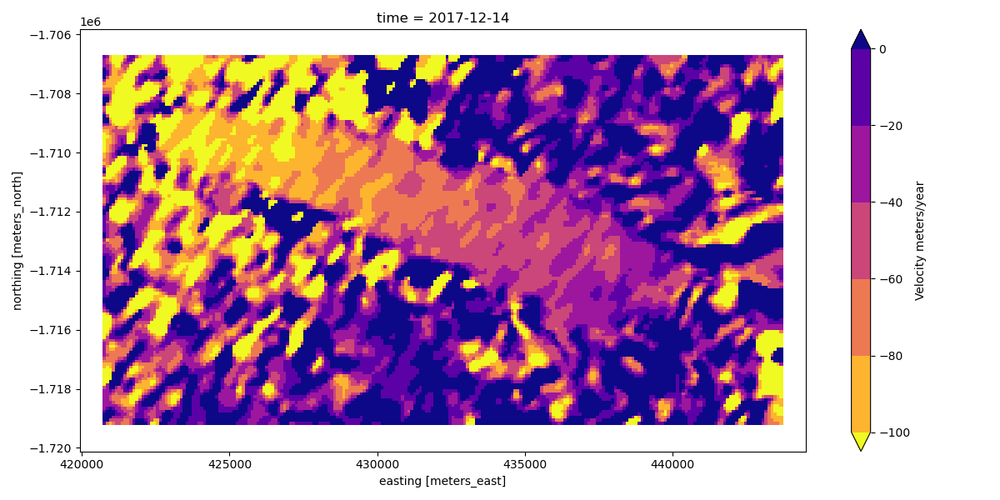

<IPython.core.display.Javascript object>


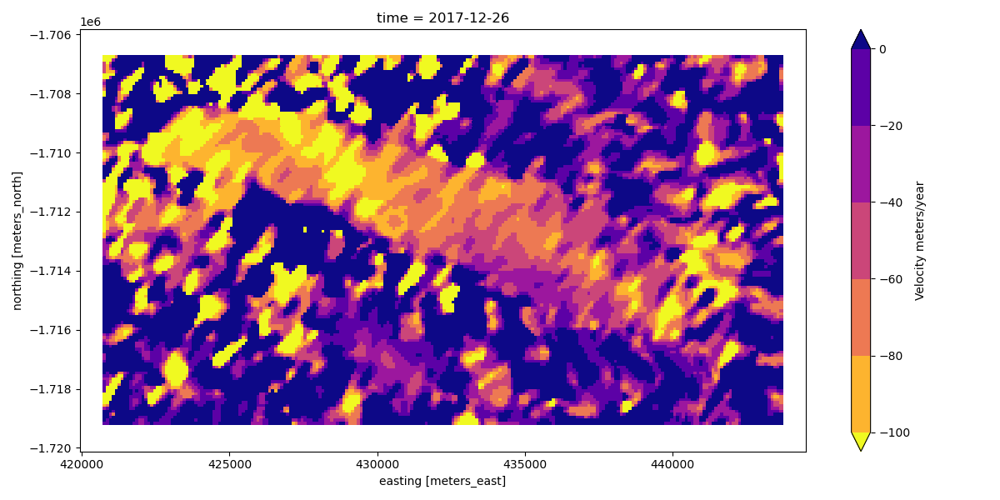

<IPython.core.display.Javascript object>


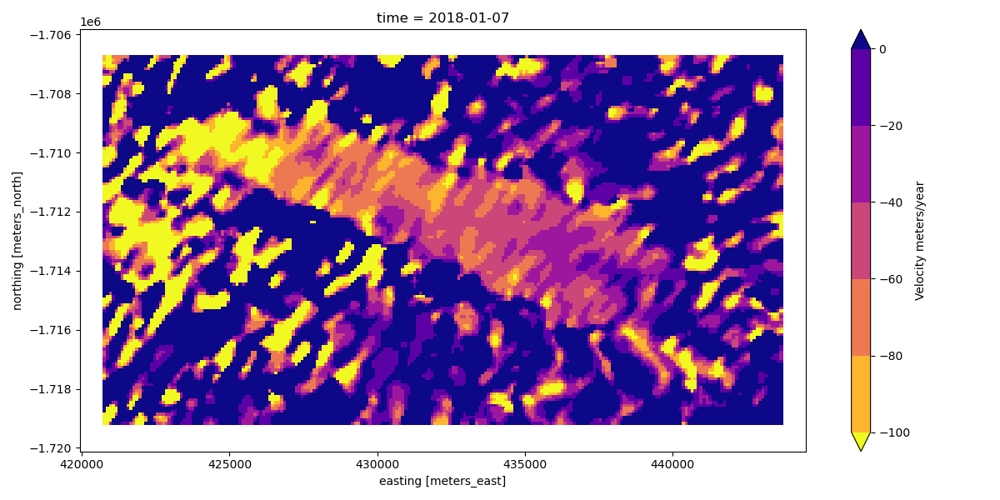

<IPython.core.display.Javascript object>


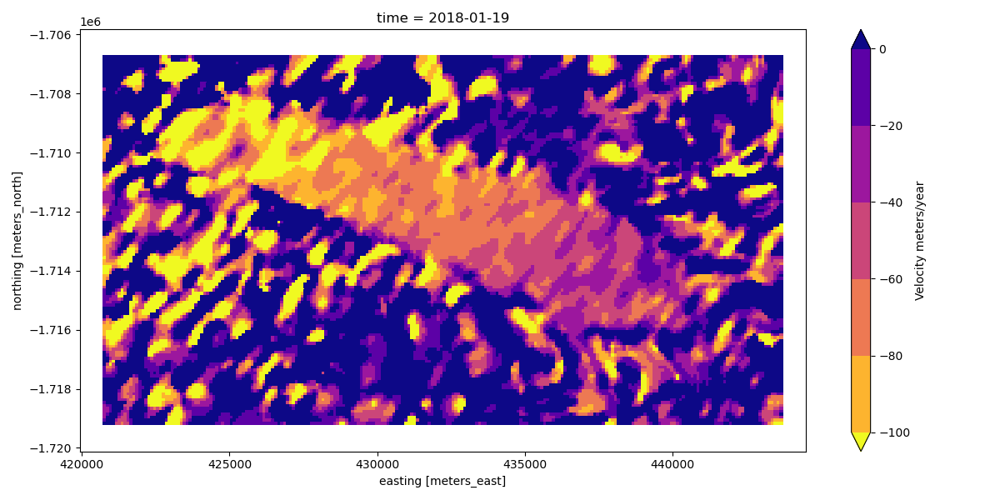

<IPython.core.display.Javascript object>


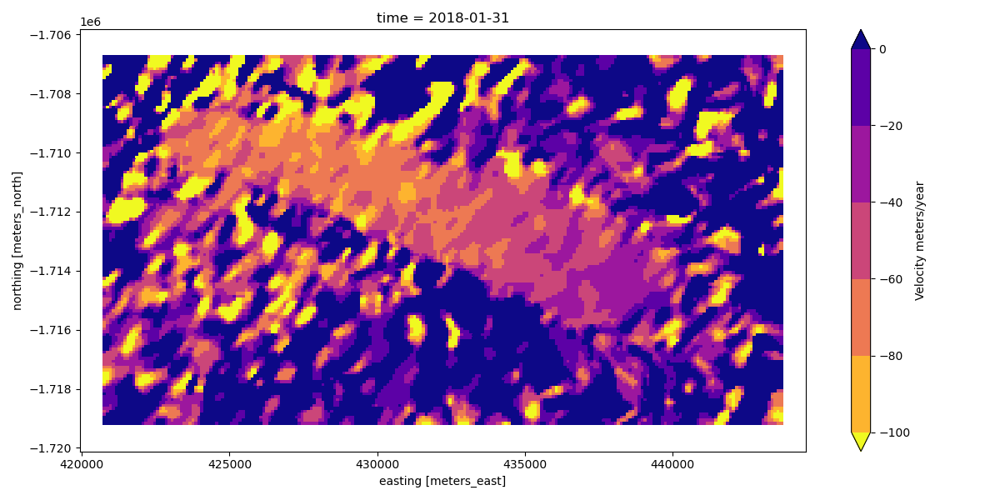

<IPython.core.display.Javascript object>


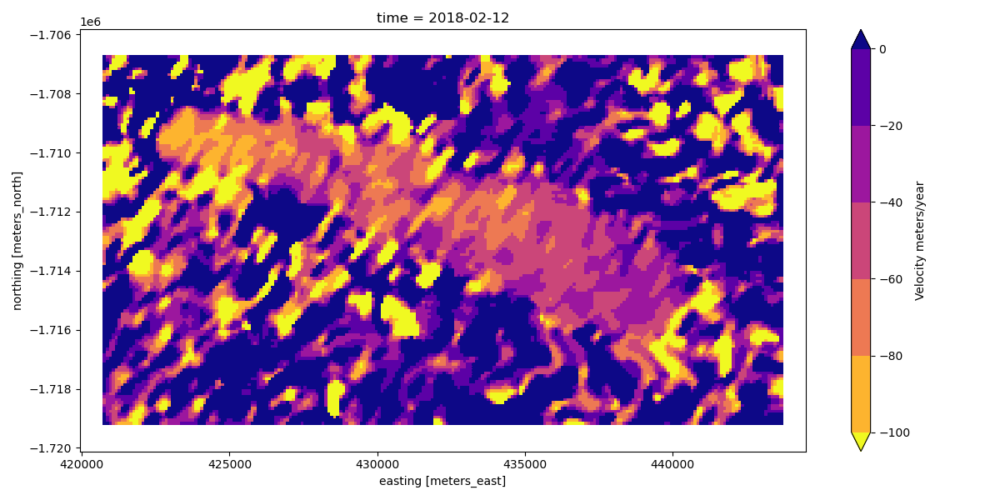

<IPython.core.display.Javascript object>


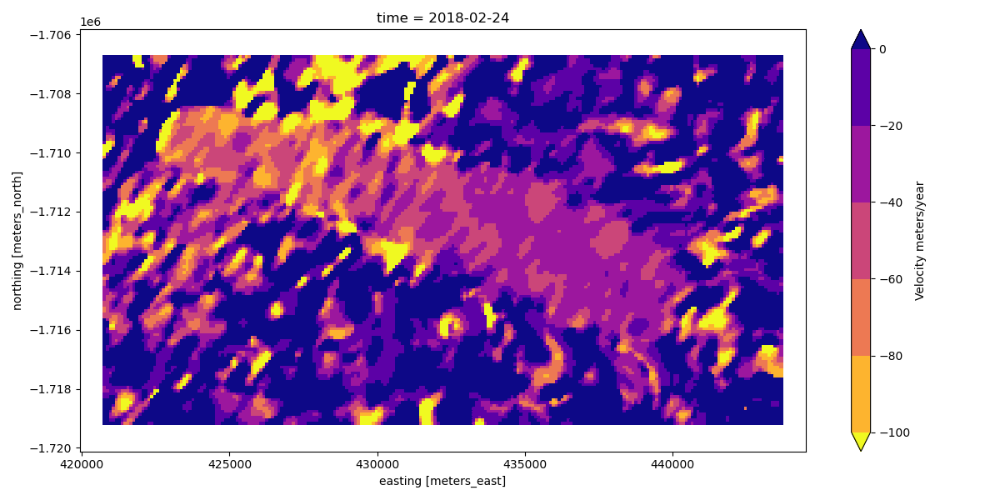

<IPython.core.display.Javascript object>


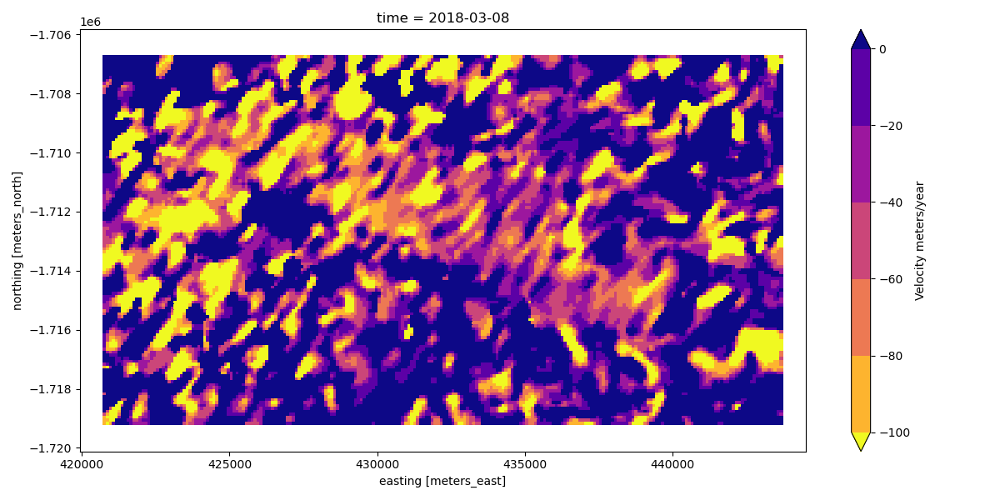

<IPython.core.display.Javascript object>


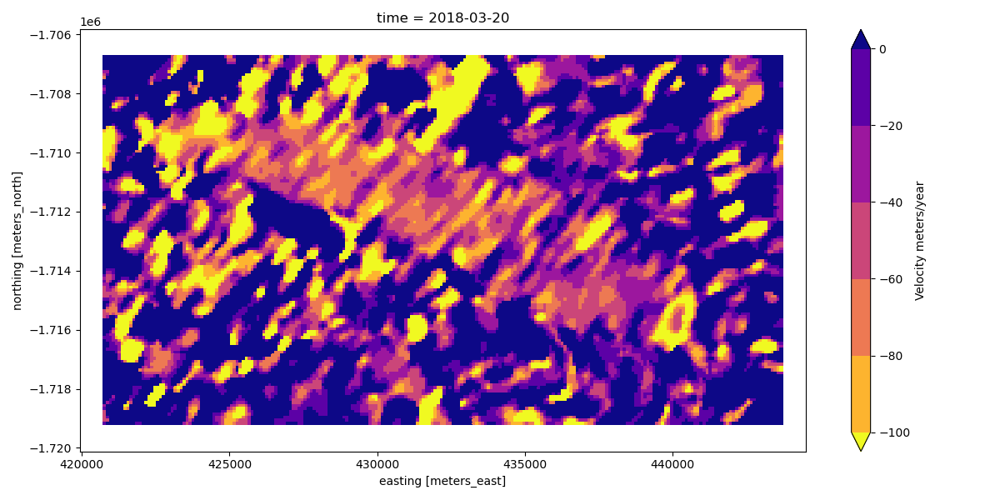

<IPython.core.display.Javascript object>


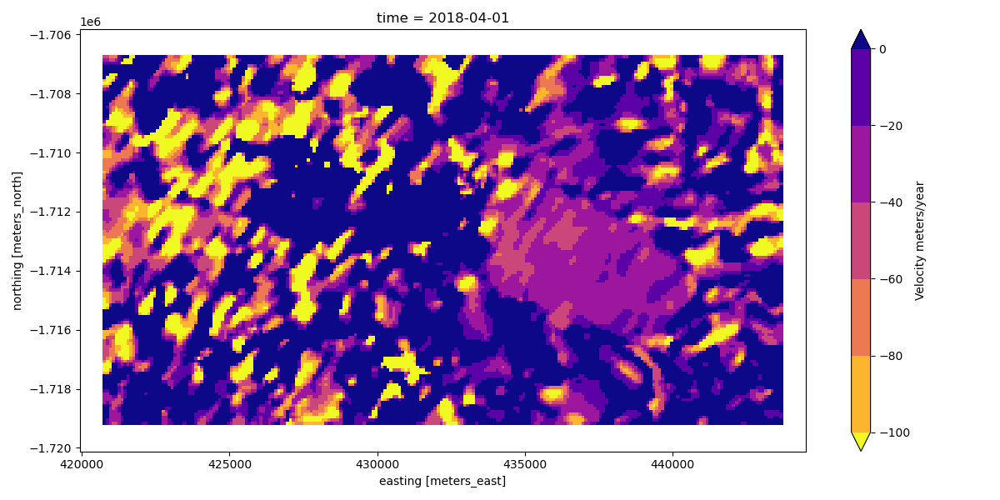

<IPython.core.display.Javascript object>


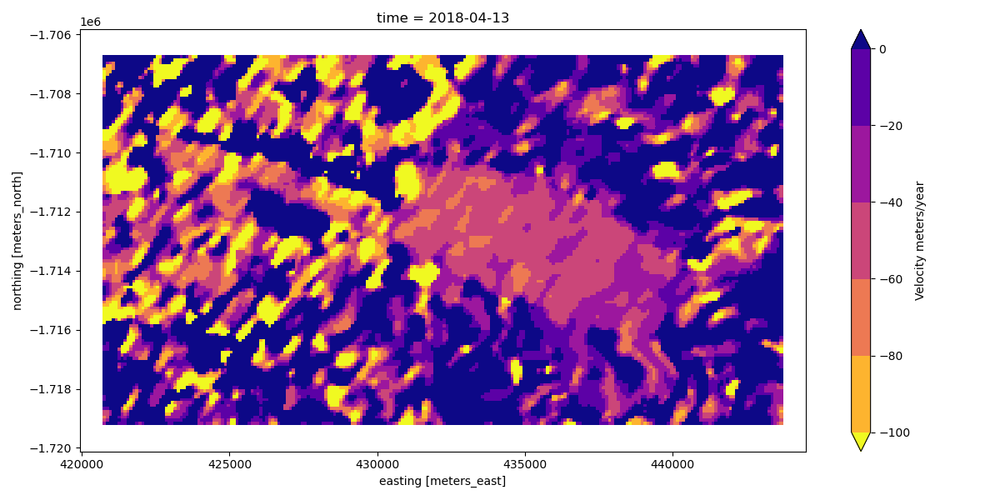

<IPython.core.display.Javascript object>


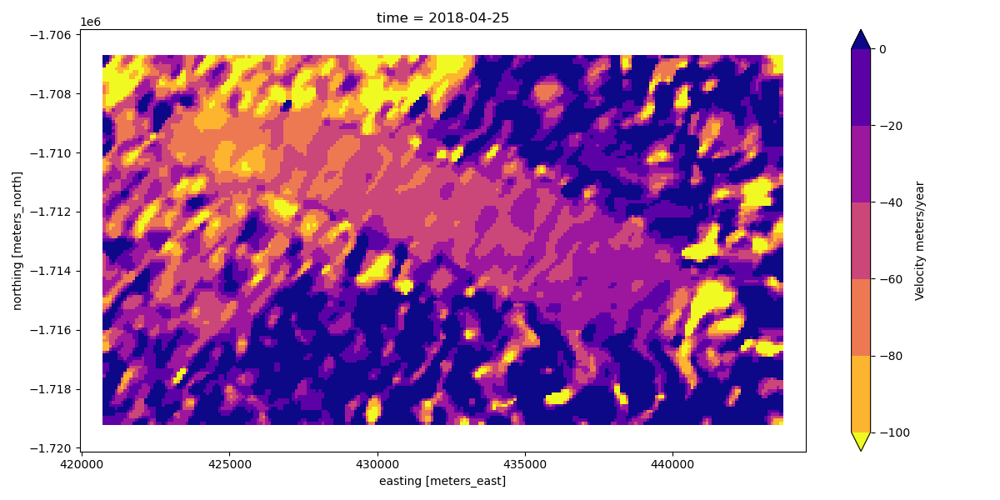

<IPython.core.display.Javascript object>


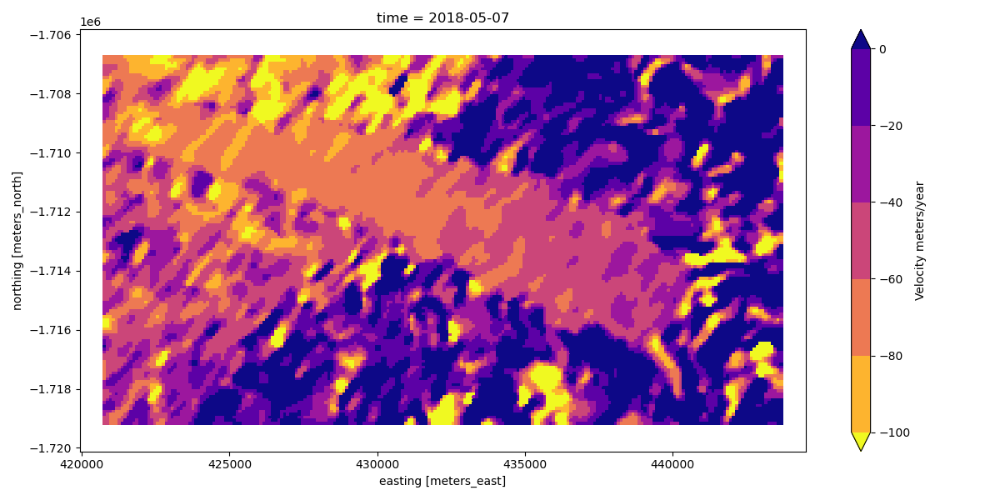

<IPython.core.display.Javascript object>


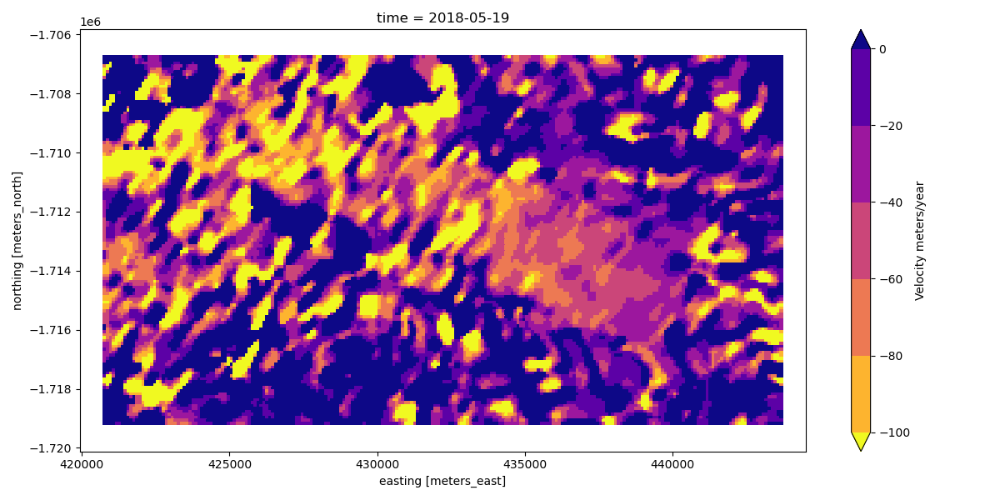

<IPython.core.display.Javascript object>


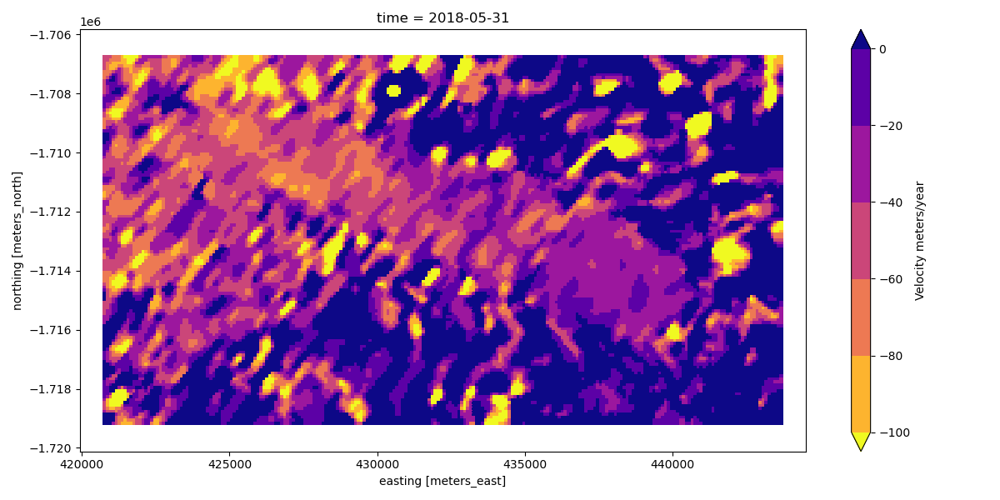

<IPython.core.display.Javascript object>


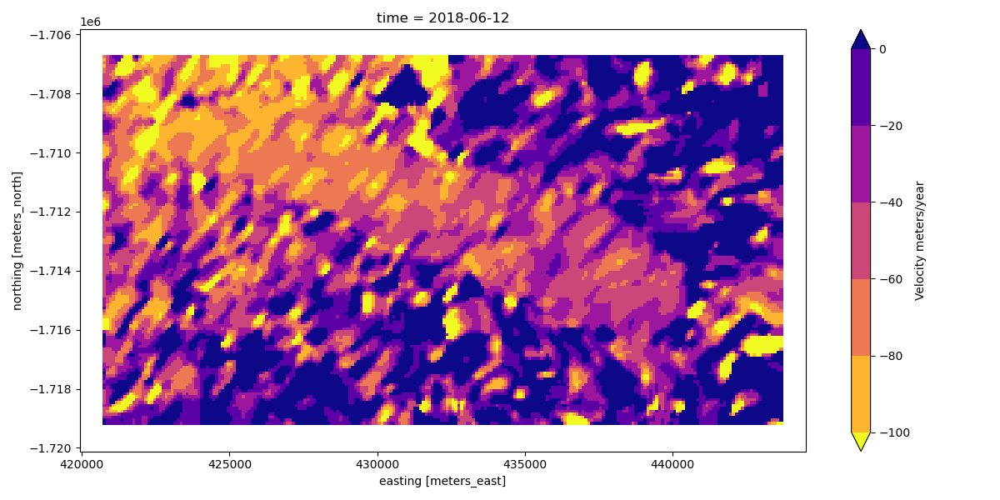

<IPython.core.display.Javascript object>


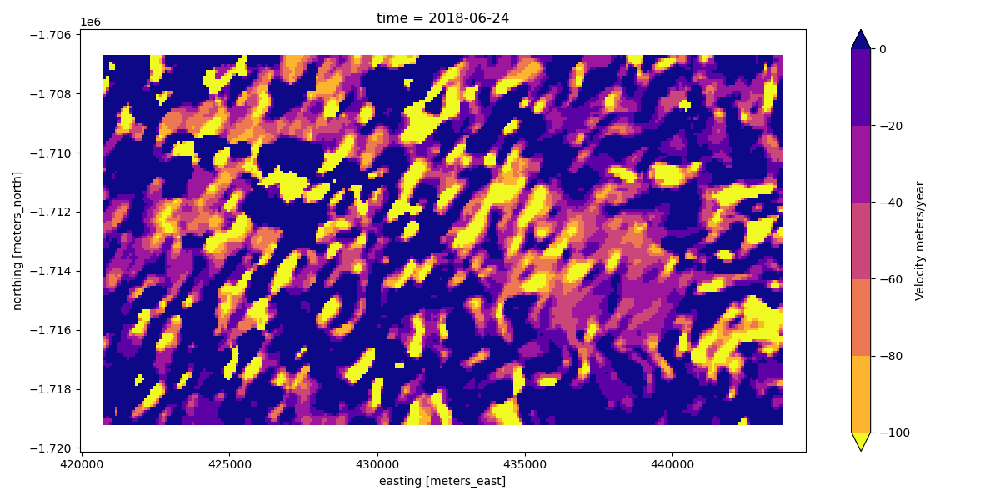

<IPython.core.display.Javascript object>


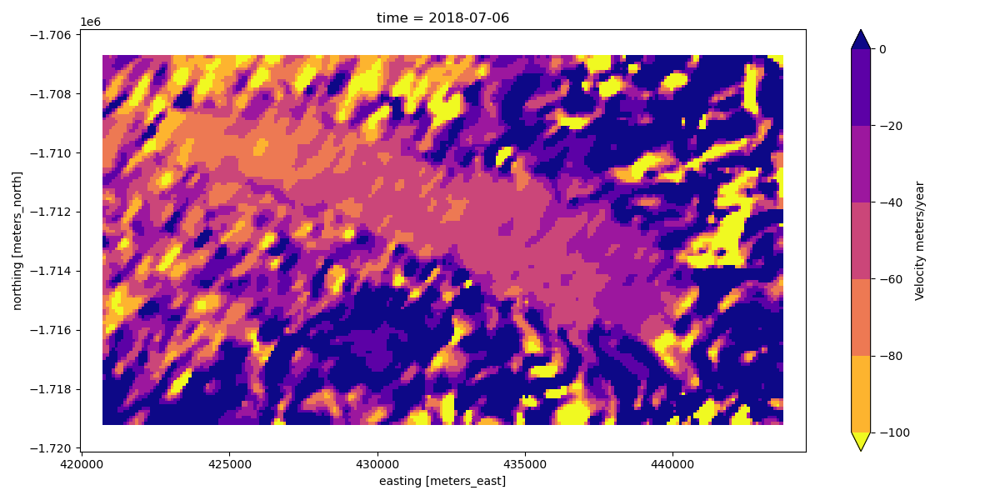

<IPython.core.display.Javascript object>


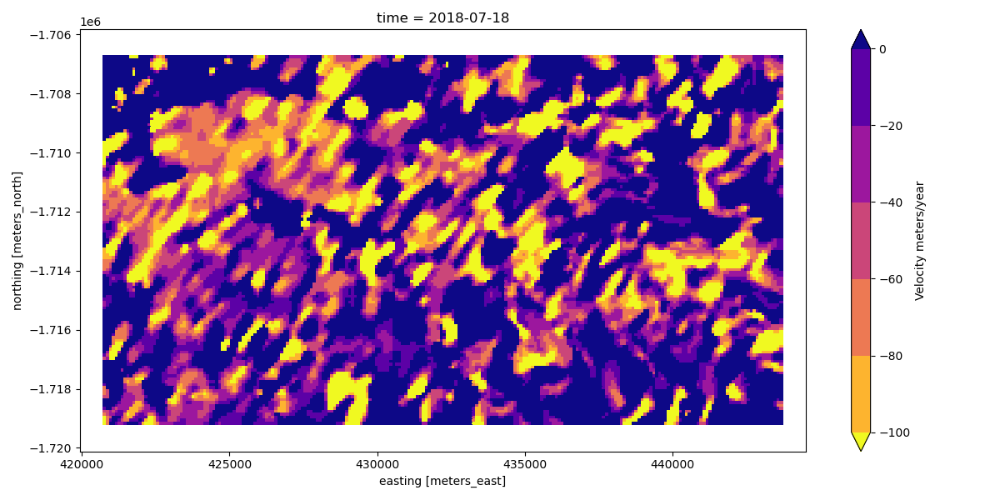

<IPython.core.display.Javascript object>


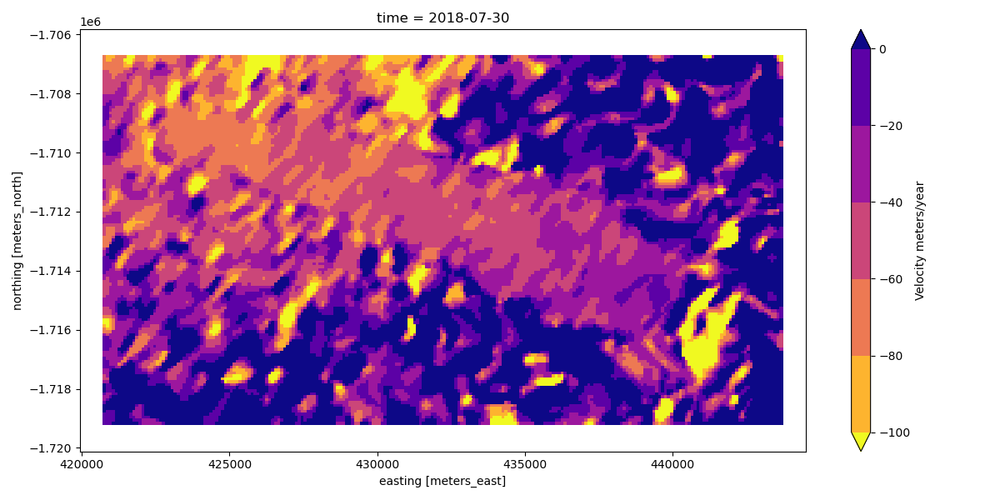

<IPython.core.display.Javascript object>


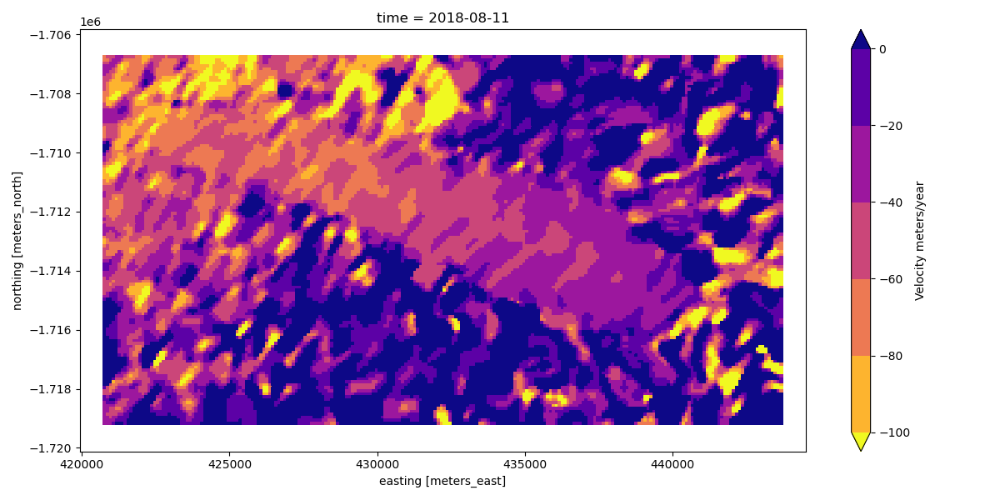

<IPython.core.display.Javascript object>


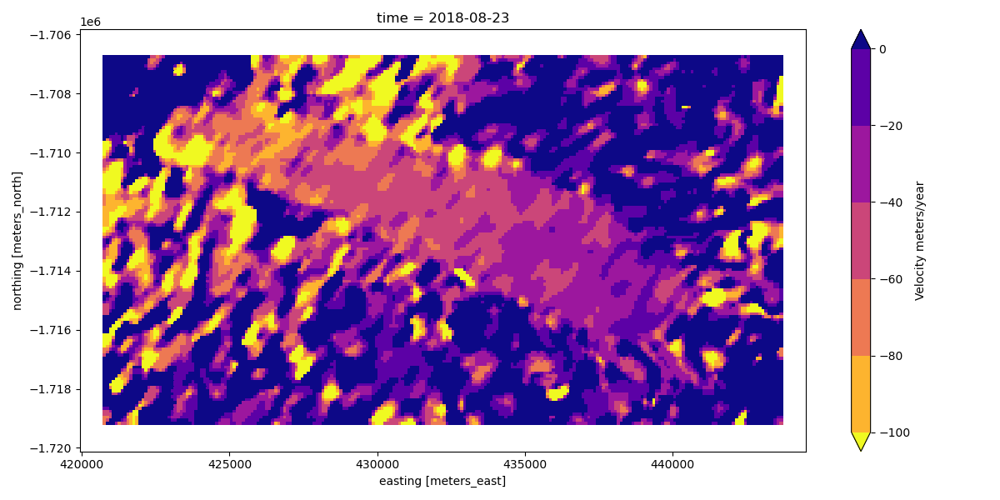

<IPython.core.display.Javascript object>


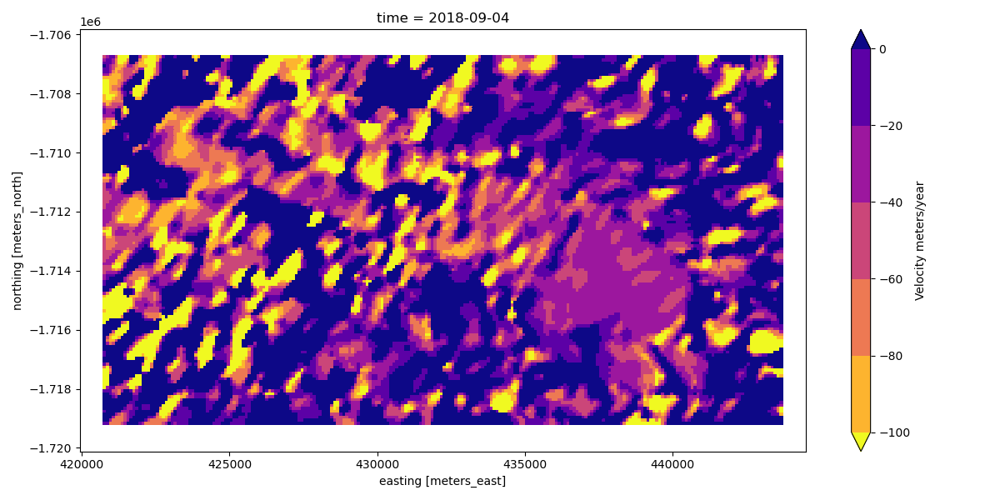

<IPython.core.display.Javascript object>


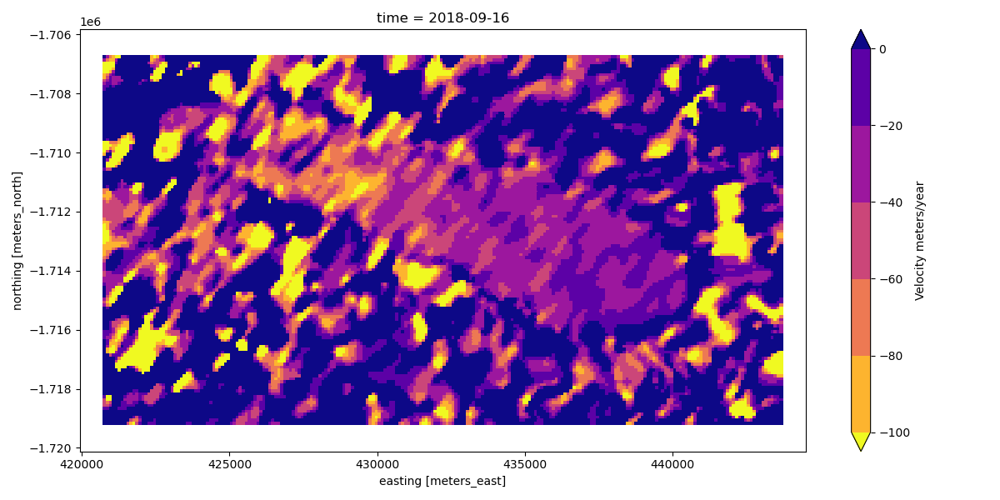

<IPython.core.display.Javascript object>


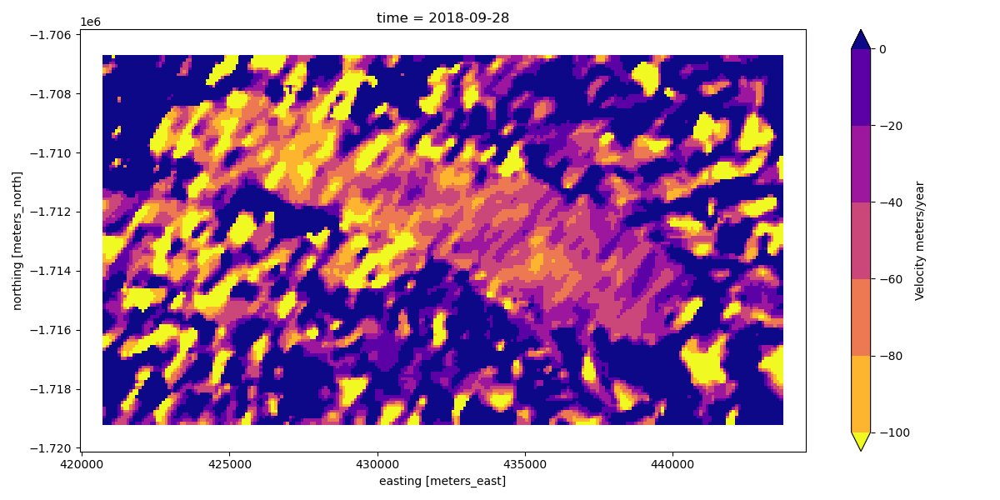

<IPython.core.display.Javascript object>


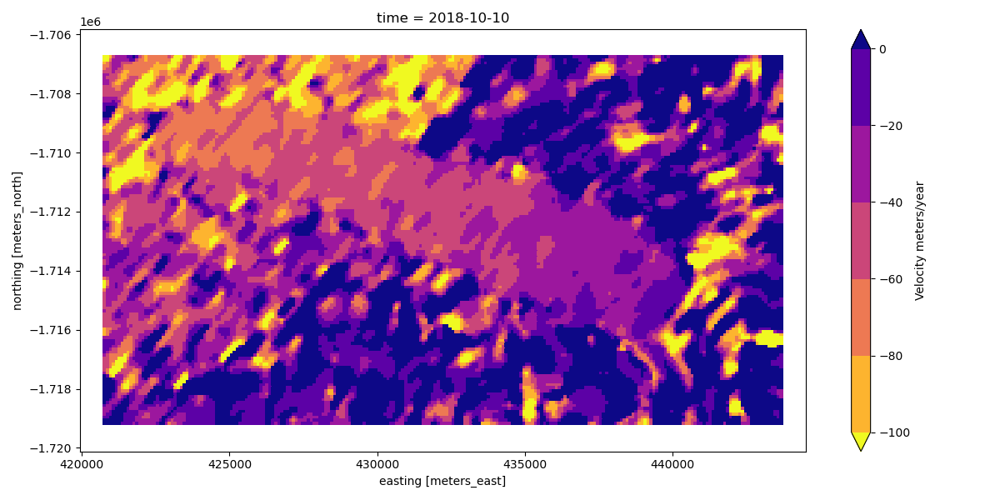

<IPython.core.display.Javascript object>


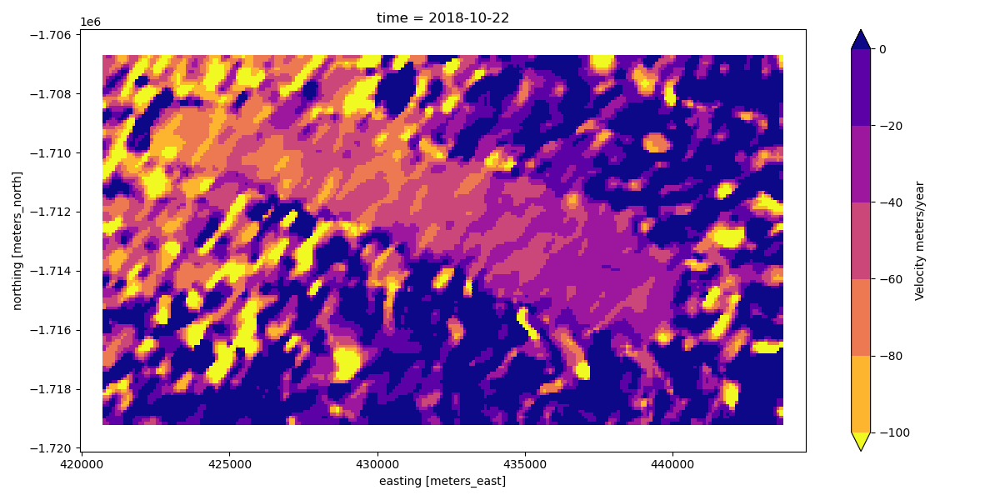

<IPython.core.display.Javascript object>


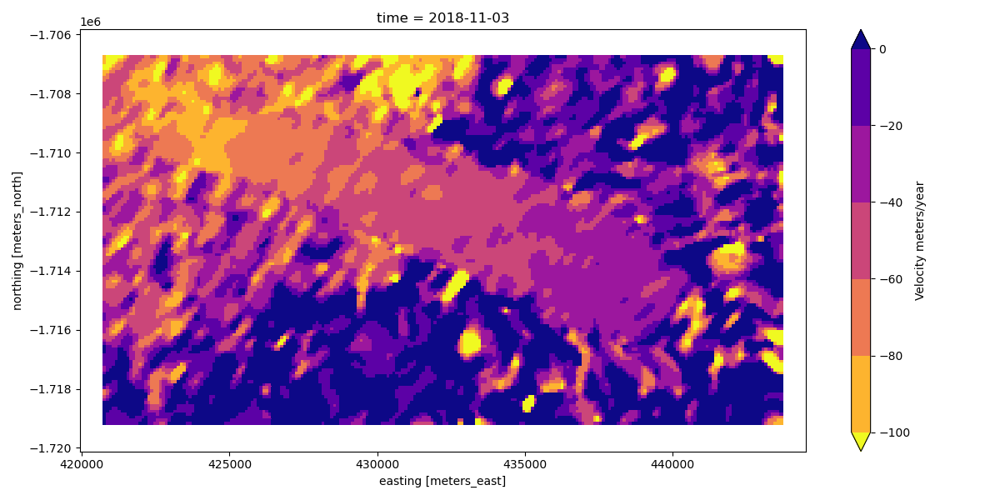

<IPython.core.display.Javascript object>


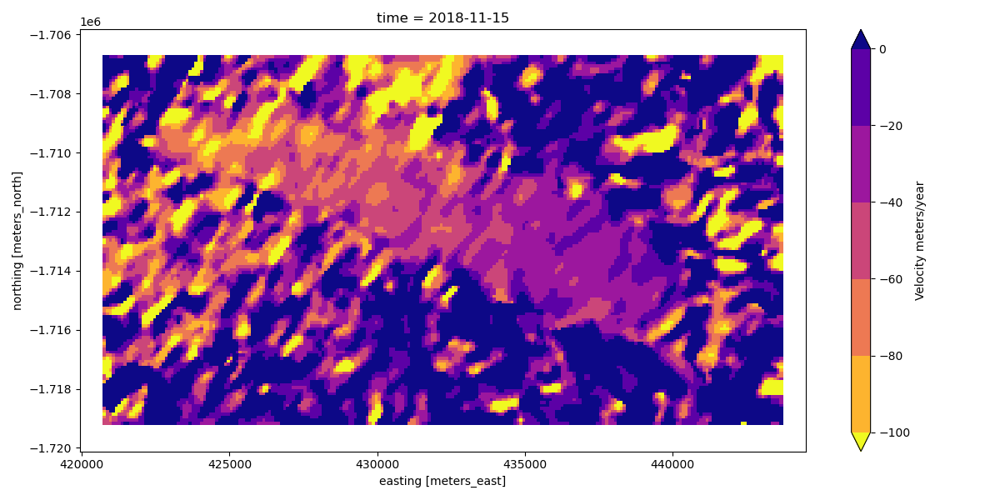

<IPython.core.display.Javascript object>


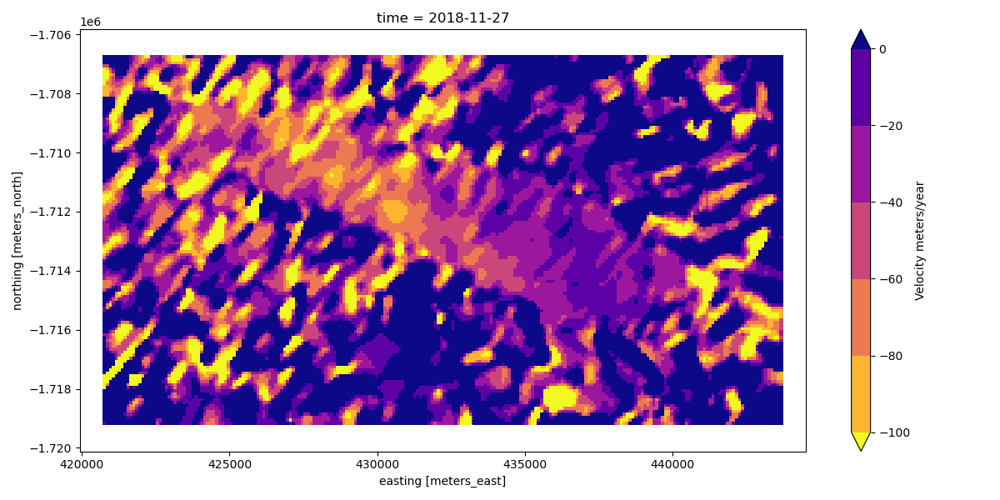

<IPython.core.display.Javascript object>


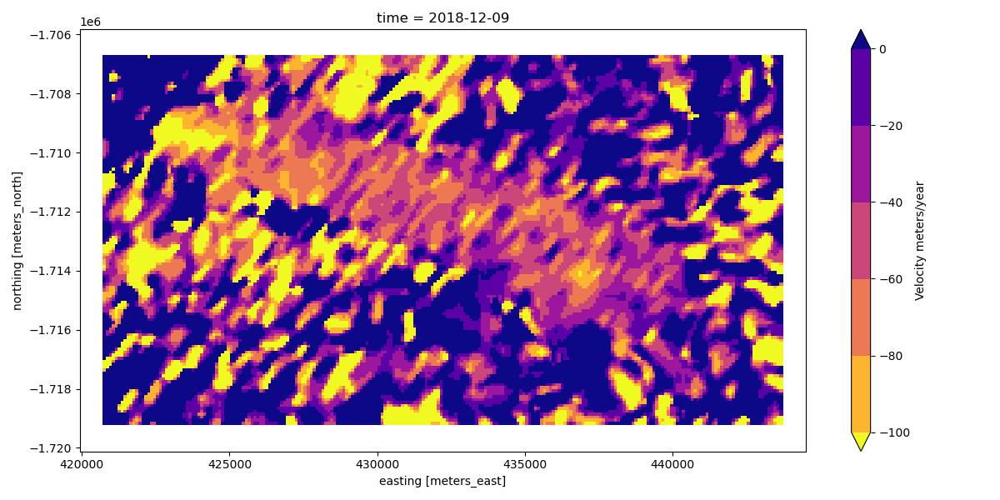

<IPython.core.display.Javascript object>


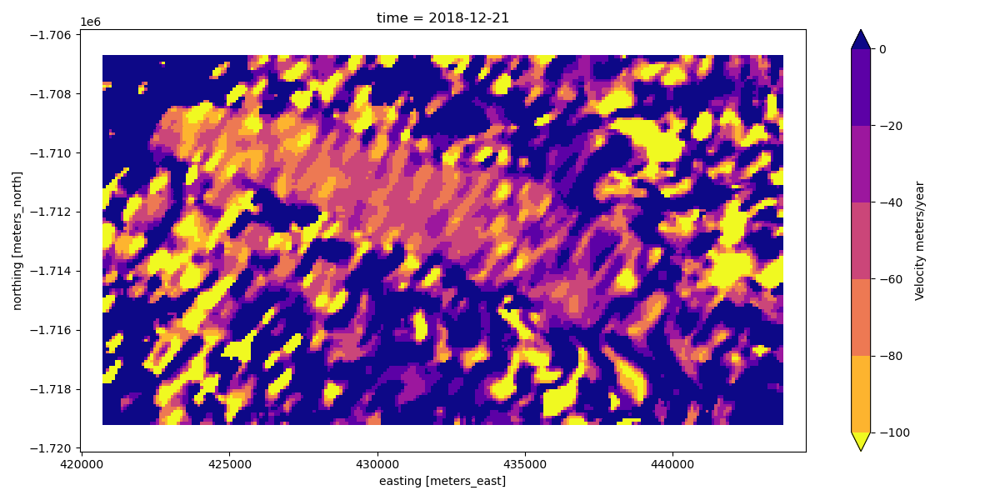

<IPython.core.display.Javascript object>


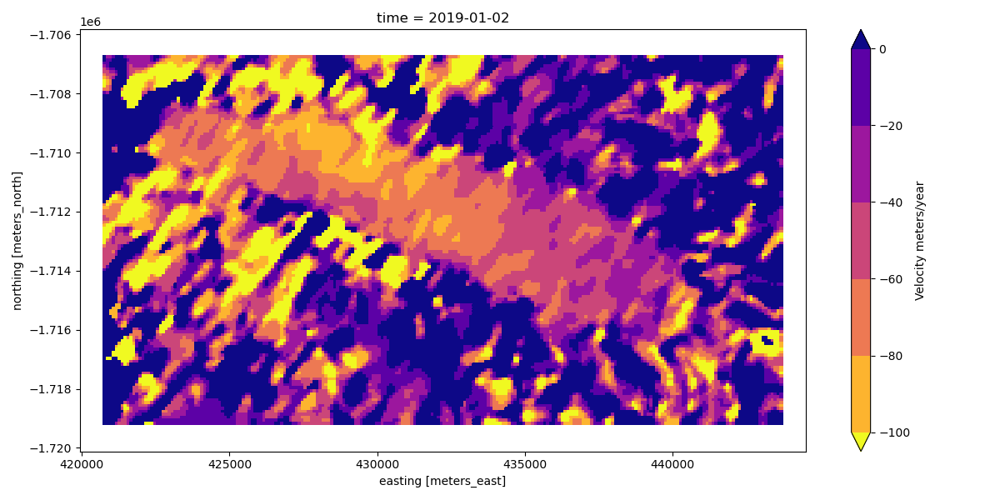

<IPython.core.display.Javascript object>


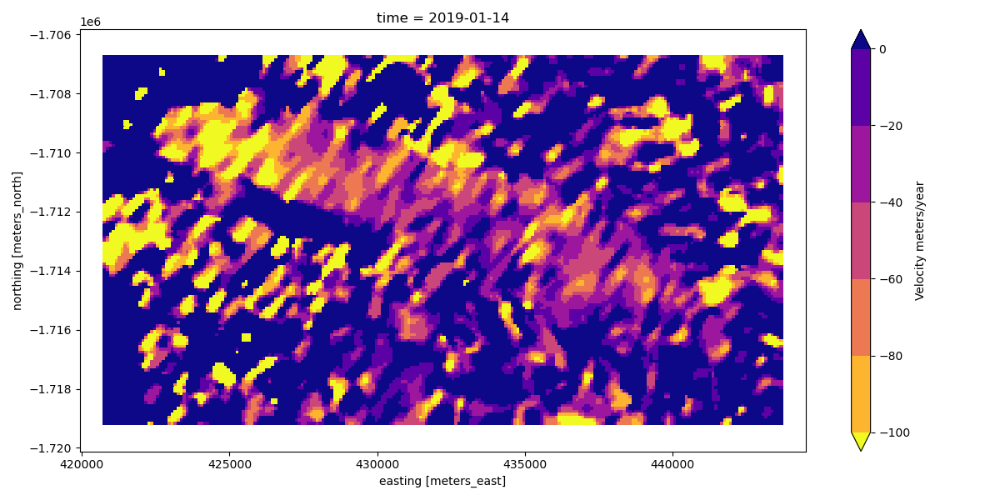

<IPython.core.display.Javascript object>


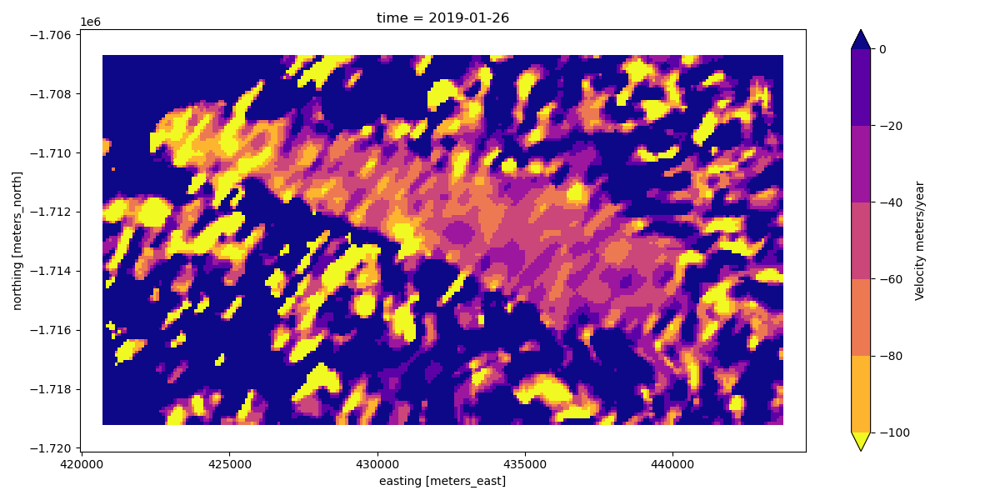

<IPython.core.display.Javascript object>


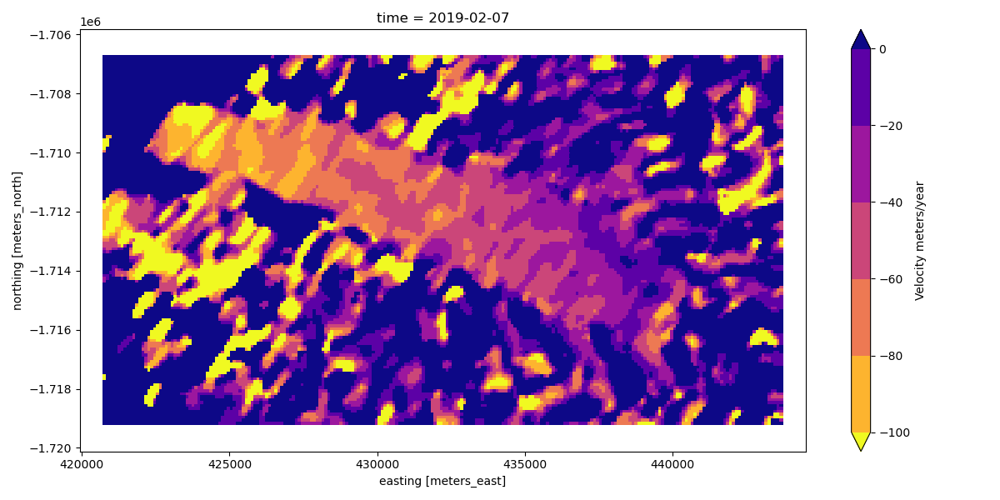

<IPython.core.display.Javascript object>


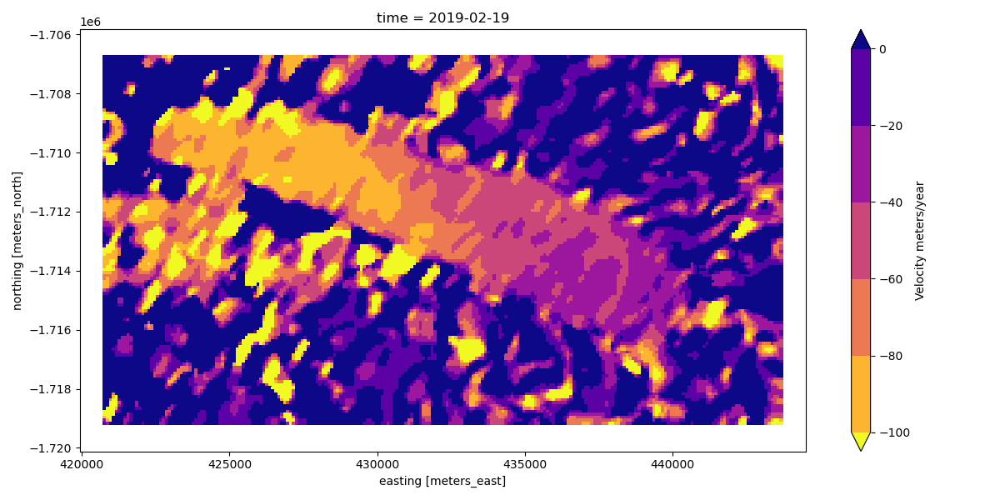

<IPython.core.display.Javascript object>


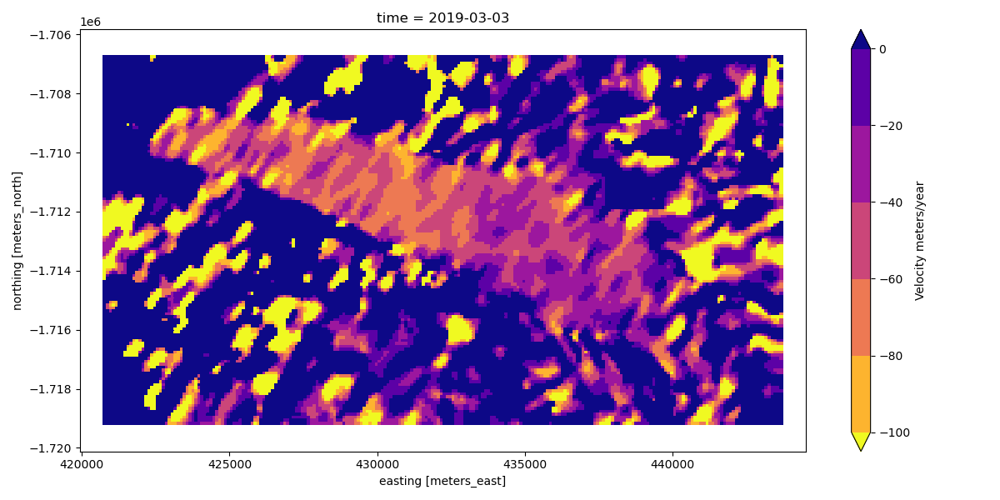

<IPython.core.display.Javascript object>


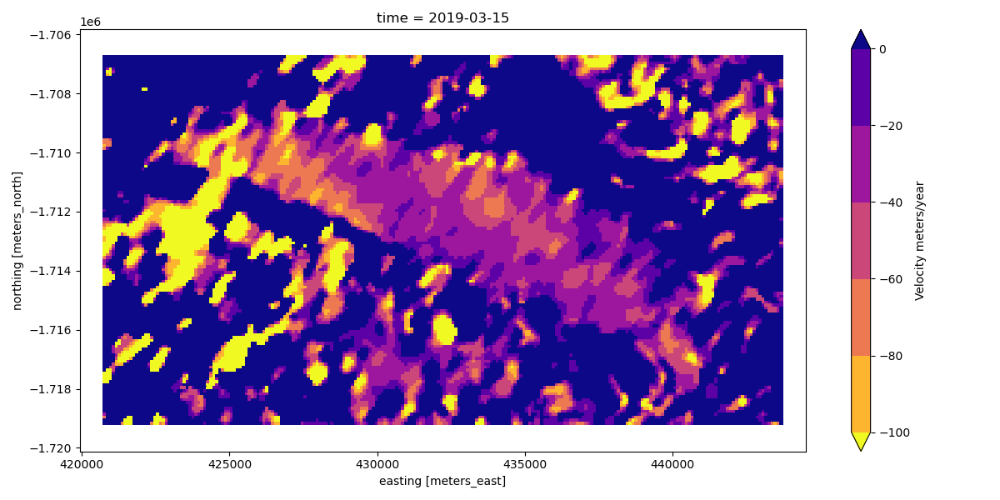

<IPython.core.display.Javascript object>


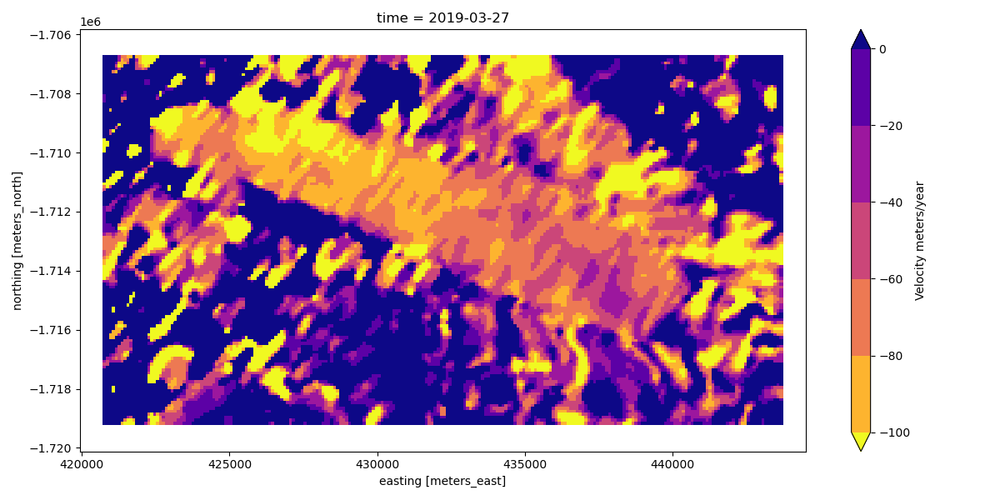

<IPython.core.display.Javascript object>


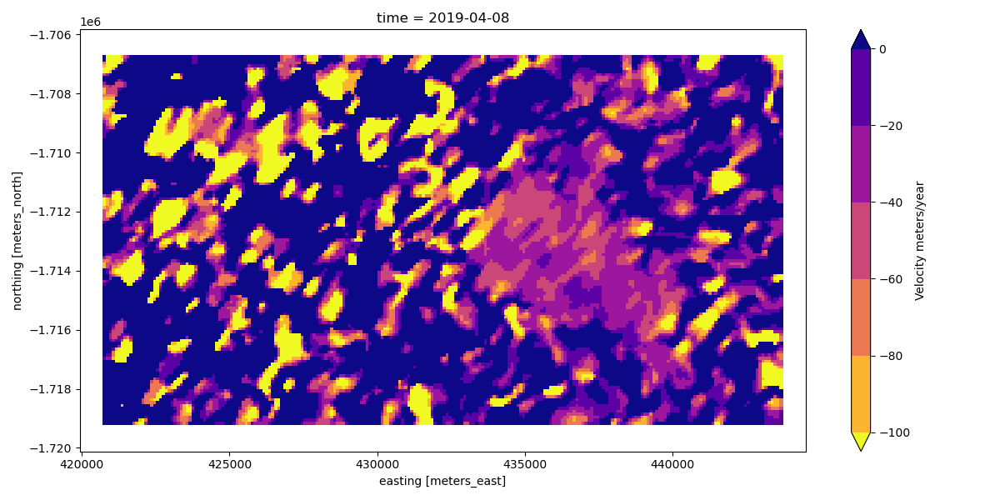

<IPython.core.display.Javascript object>


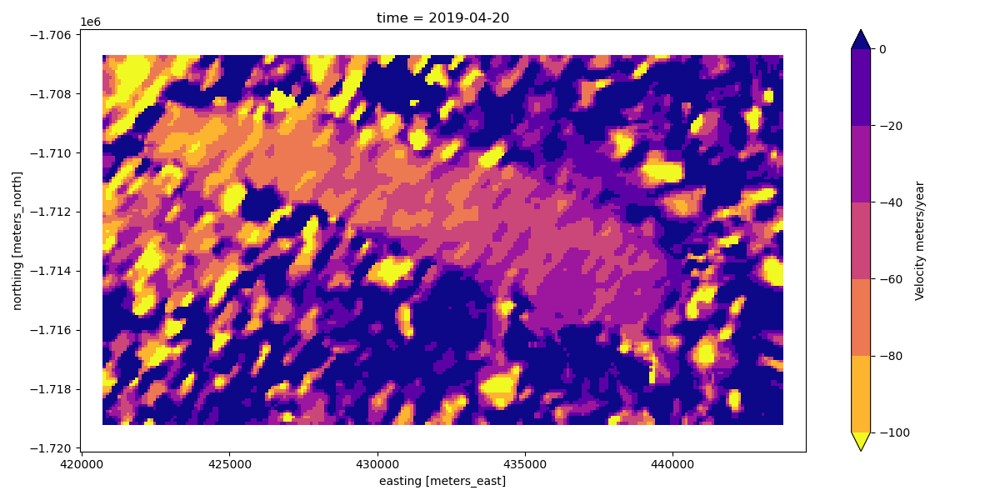

<IPython.core.display.Javascript object>


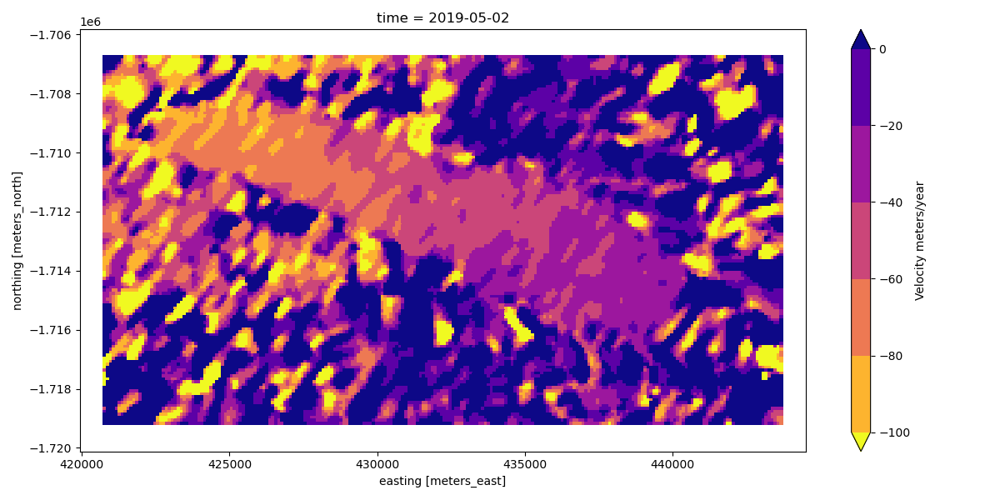

<IPython.core.display.Javascript object>


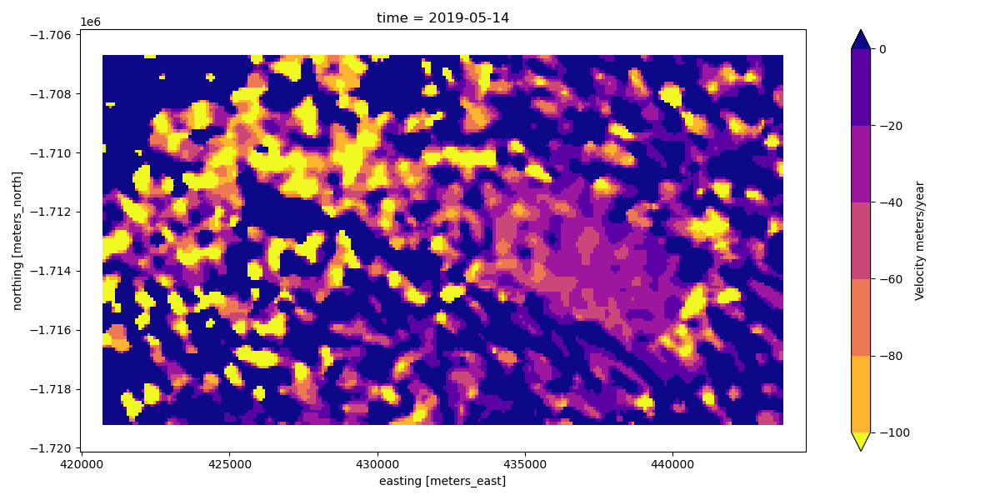

<IPython.core.display.Javascript object>


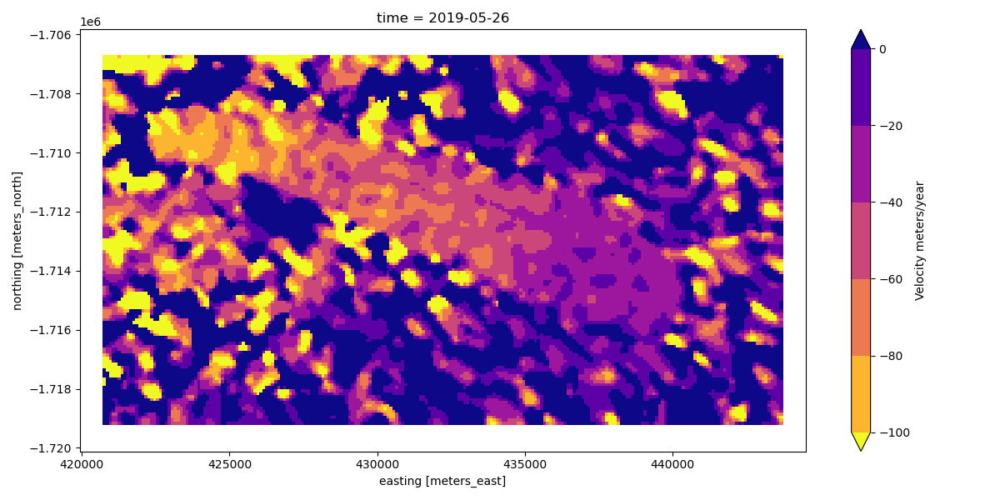

<IPython.core.display.Javascript object>


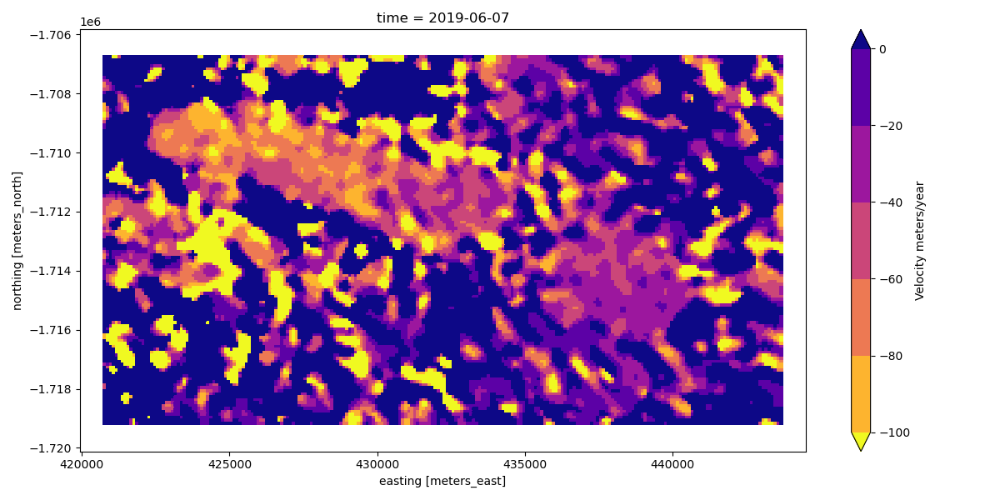

<IPython.core.display.Javascript object>


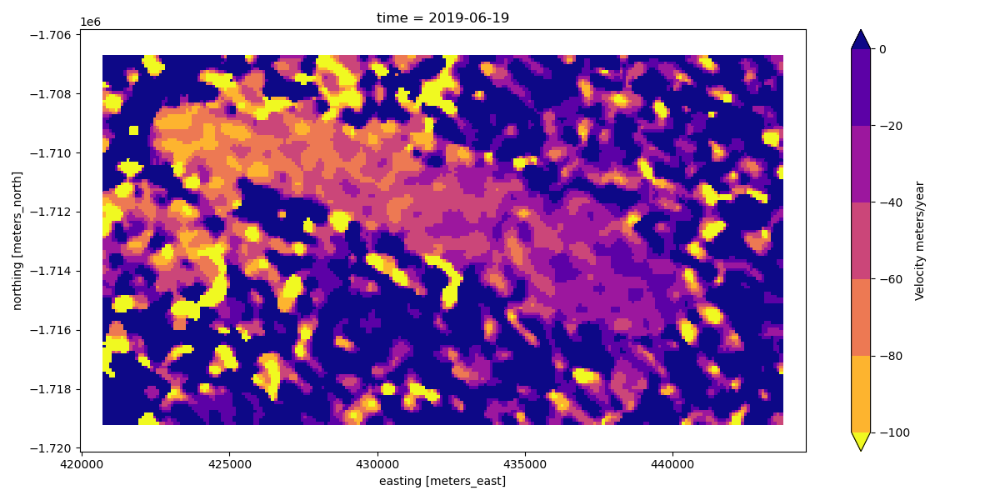

<IPython.core.display.Javascript object>


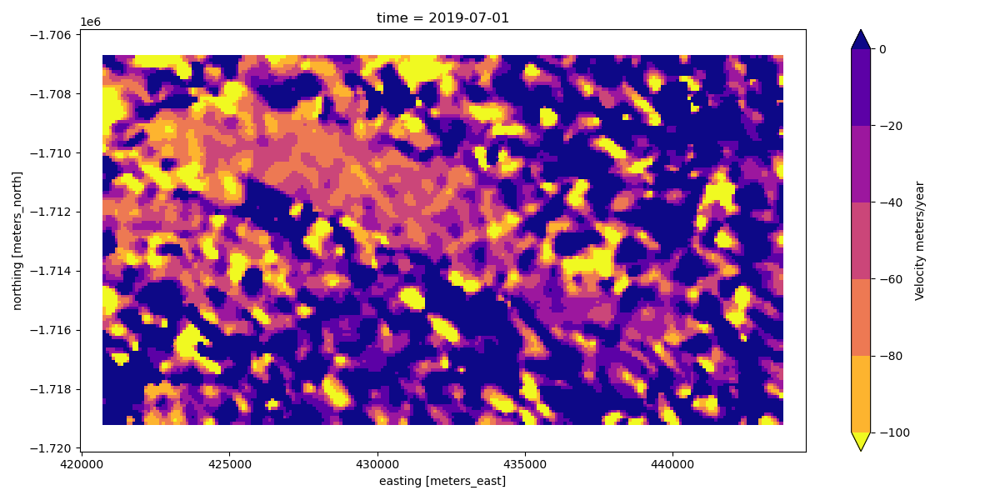

<IPython.core.display.Javascript object>


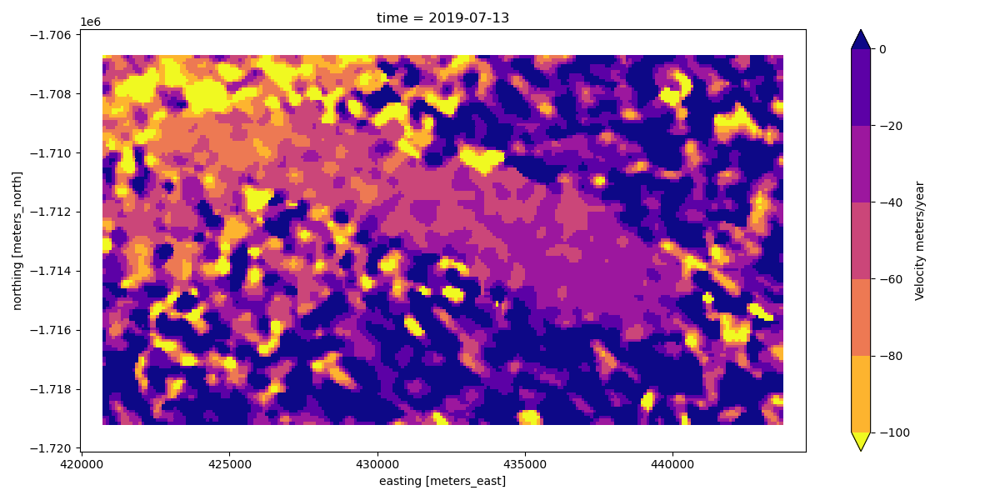

<IPython.core.display.Javascript object>


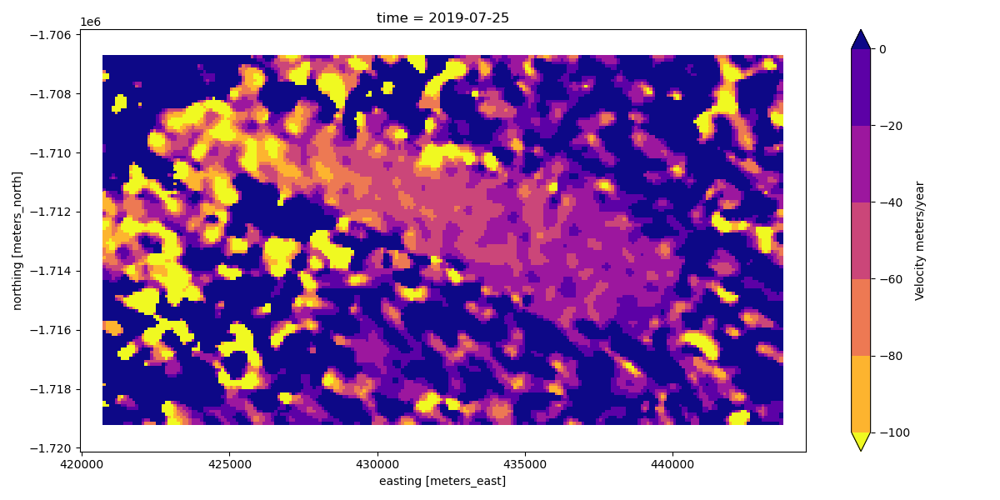

<IPython.core.display.Javascript object>


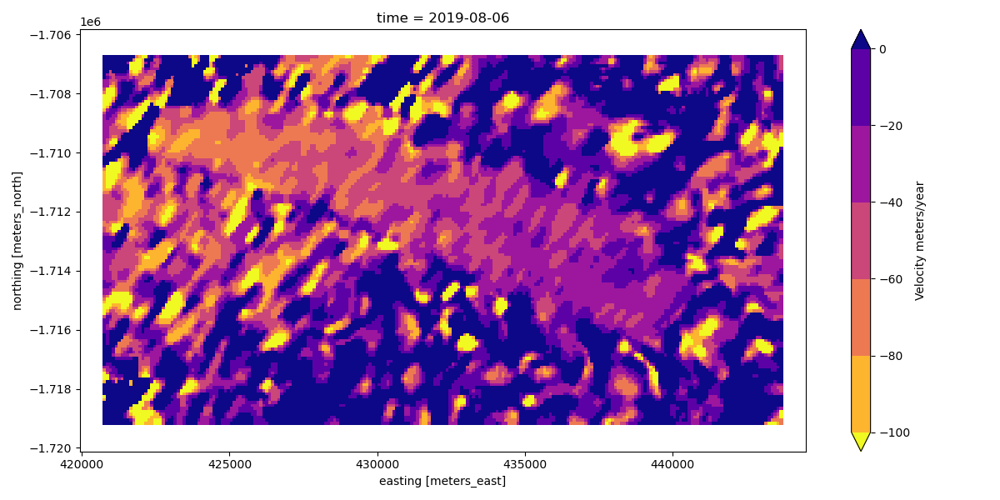

<IPython.core.display.Javascript object>


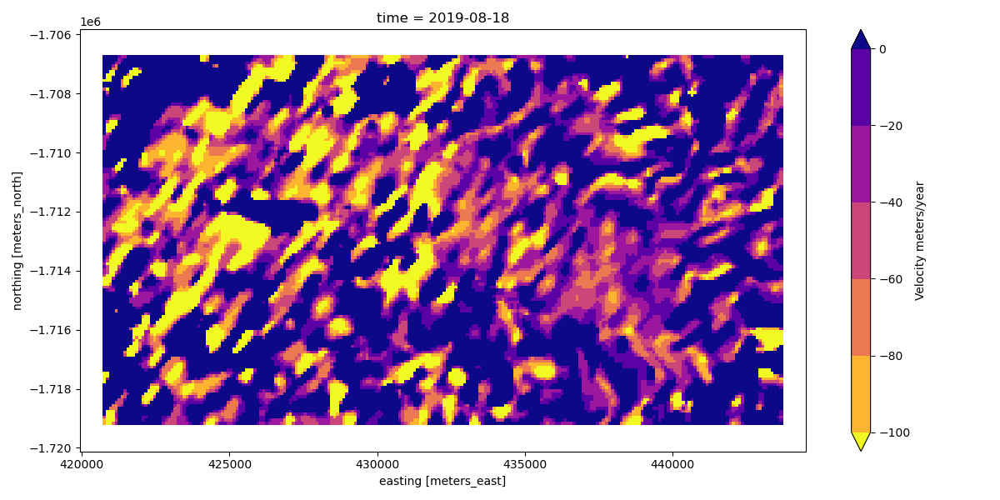

<IPython.core.display.Javascript object>


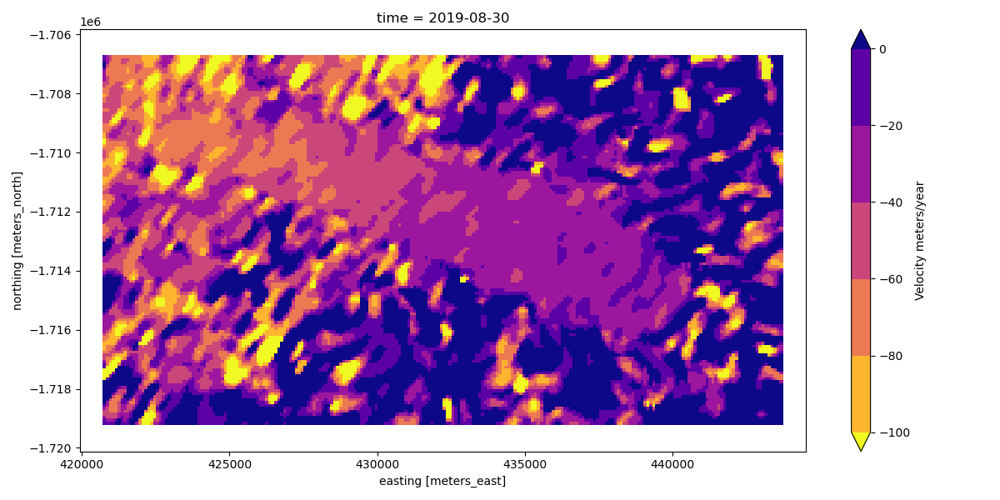

<IPython.core.display.Javascript object>


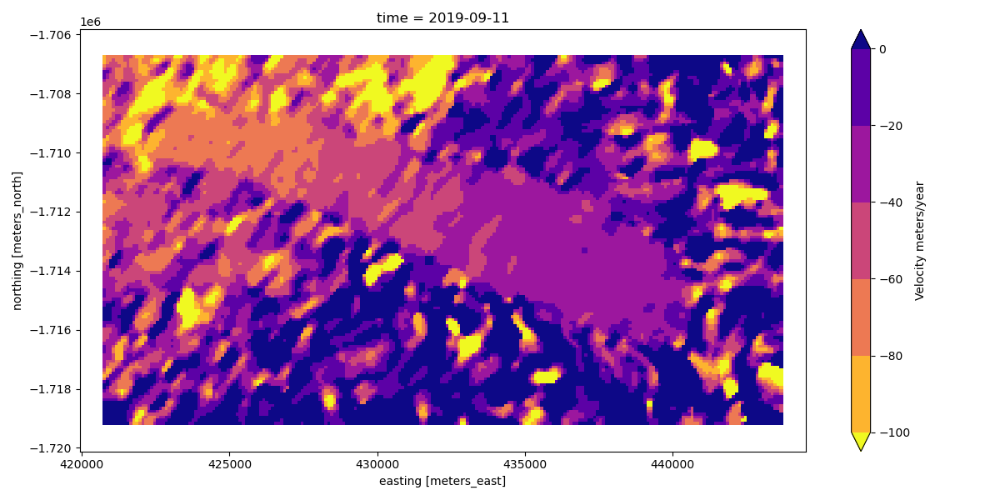

<IPython.core.display.Javascript object>


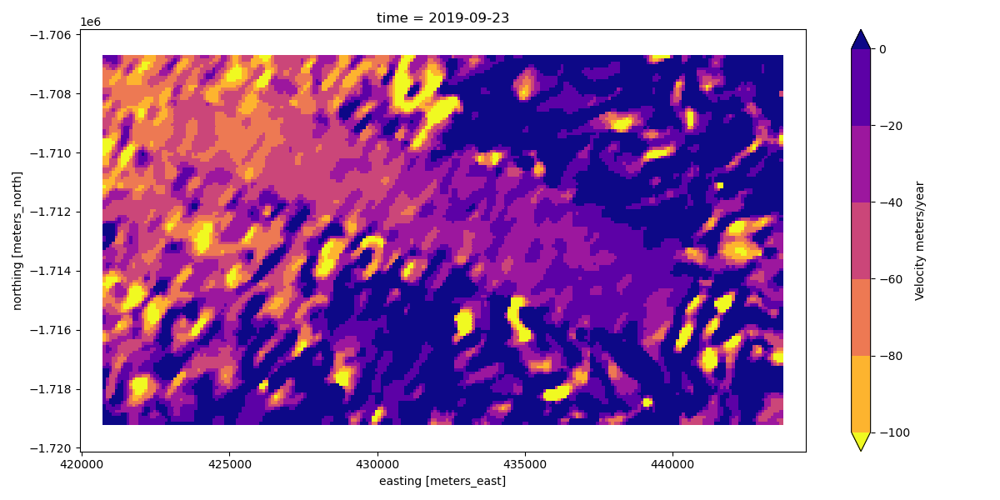

<IPython.core.display.Javascript object>


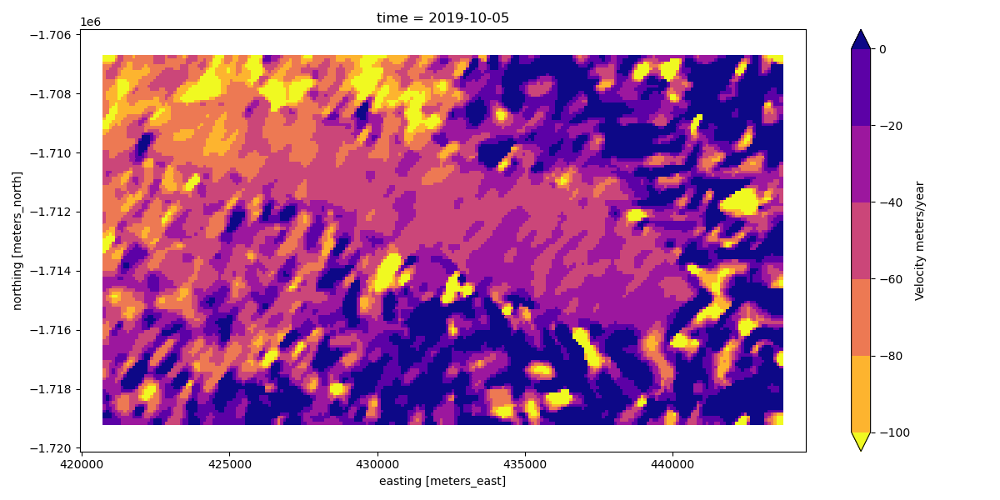

<IPython.core.display.Javascript object>


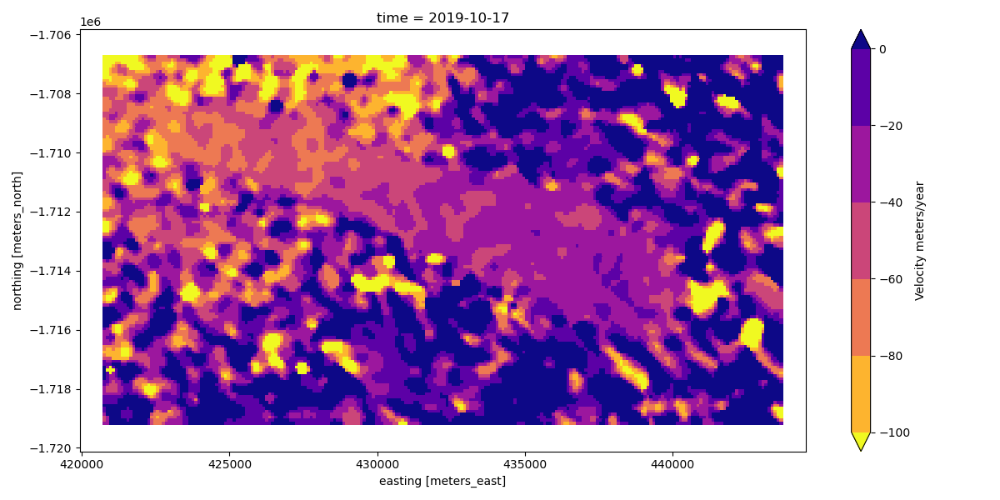

<IPython.core.display.Javascript object>


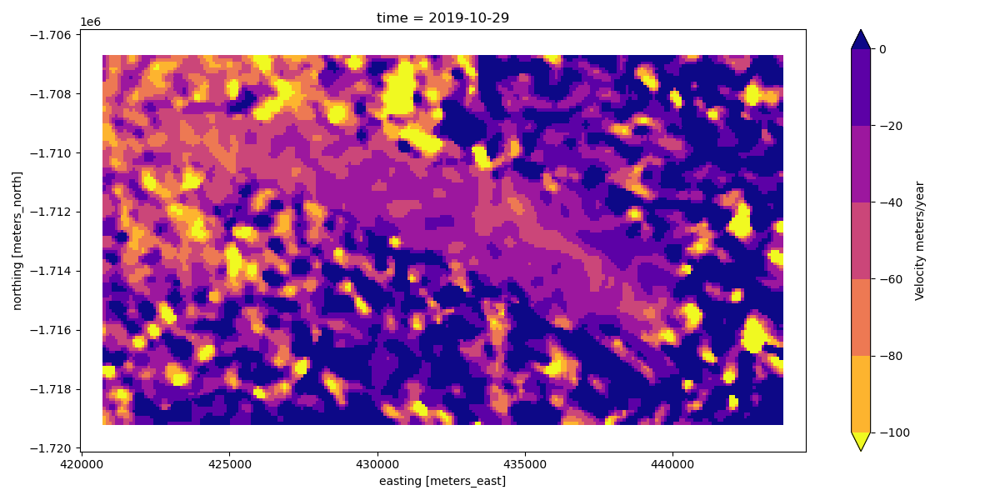

<IPython.core.display.Javascript object>


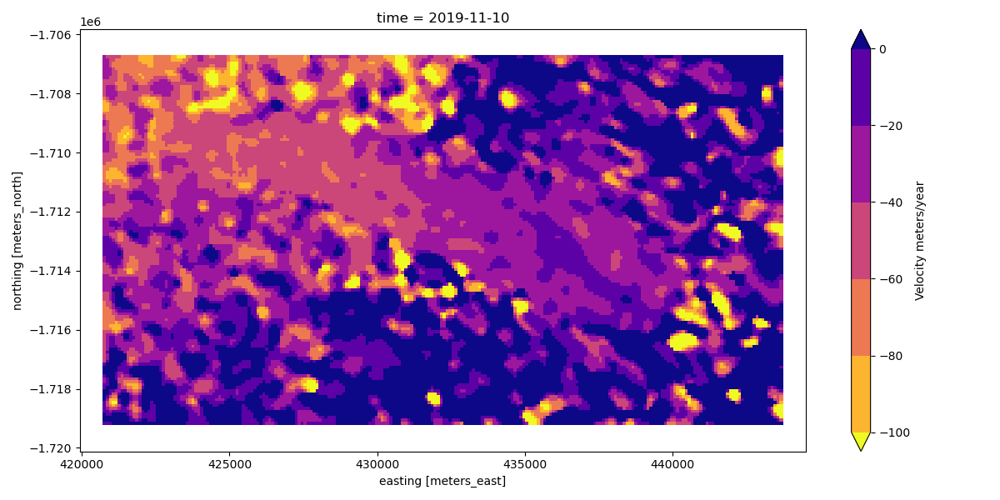

<IPython.core.display.Javascript object>


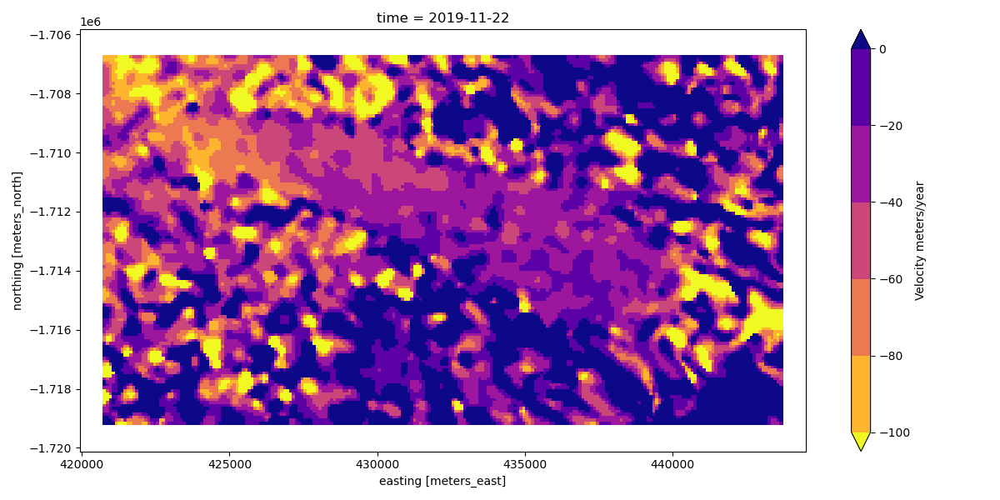

<IPython.core.display.Javascript object>


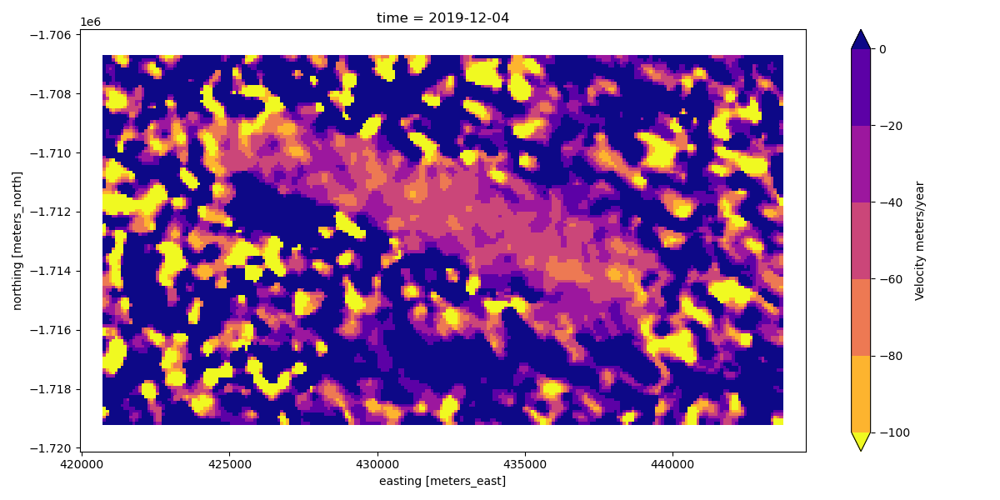

<IPython.core.display.Javascript object>


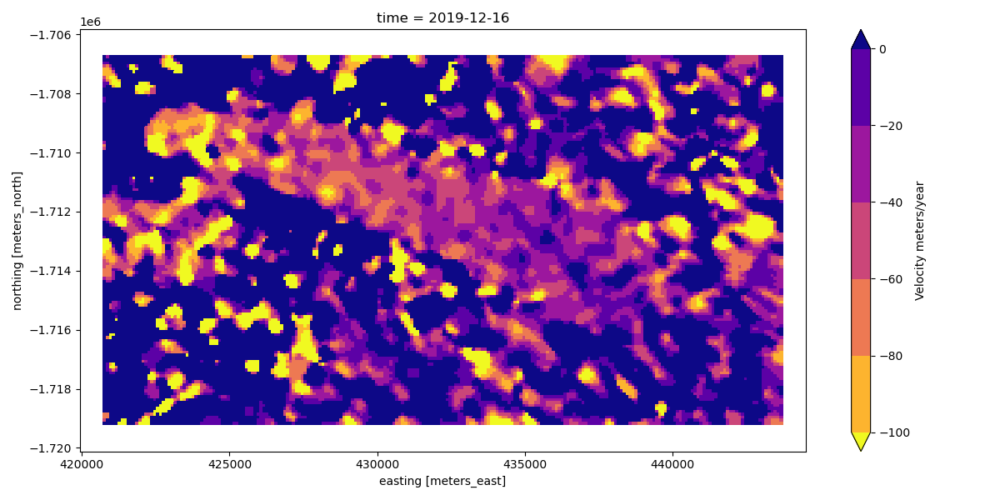

<IPython.core.display.Javascript object>


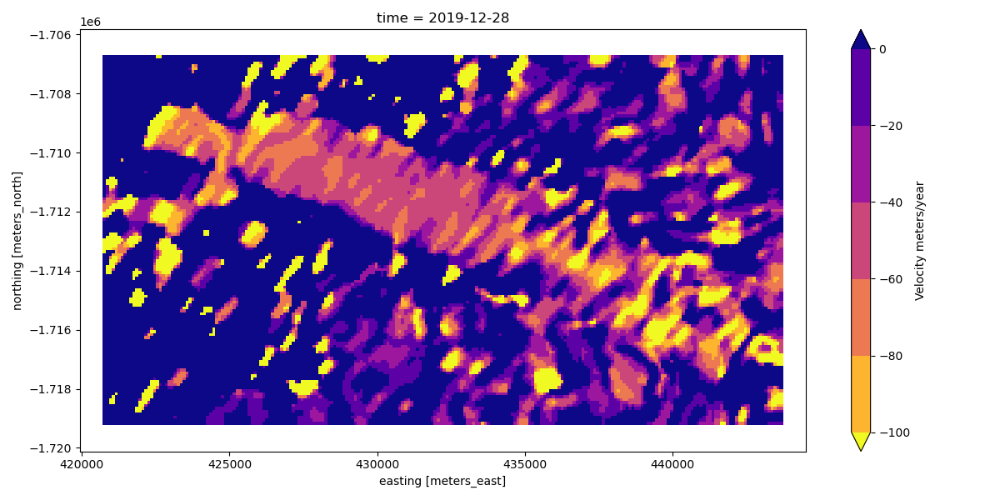

<IPython.core.display.Javascript object>


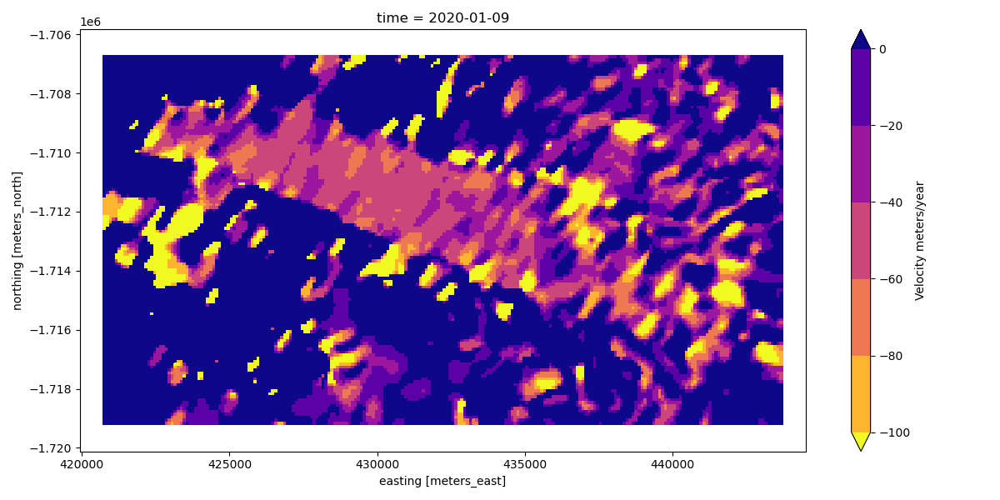

<IPython.core.display.Javascript object>


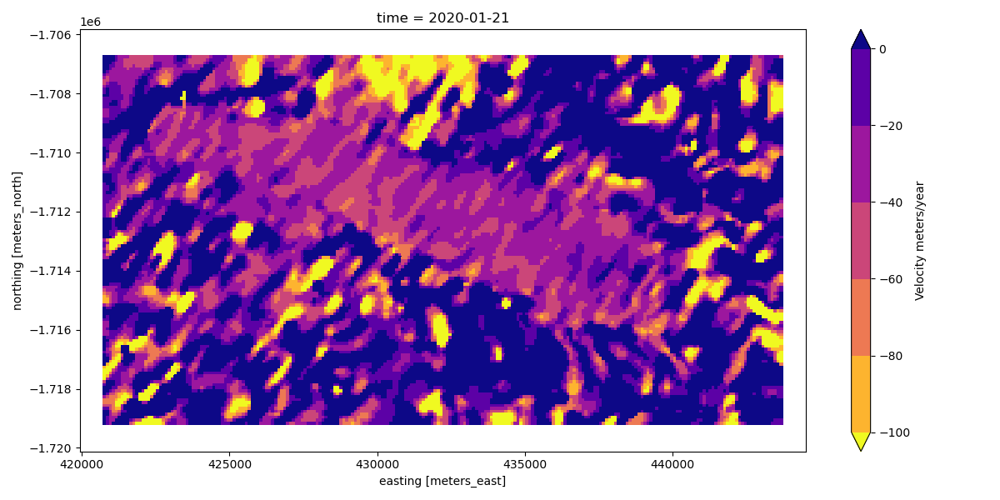

<IPython.core.display.Javascript object>


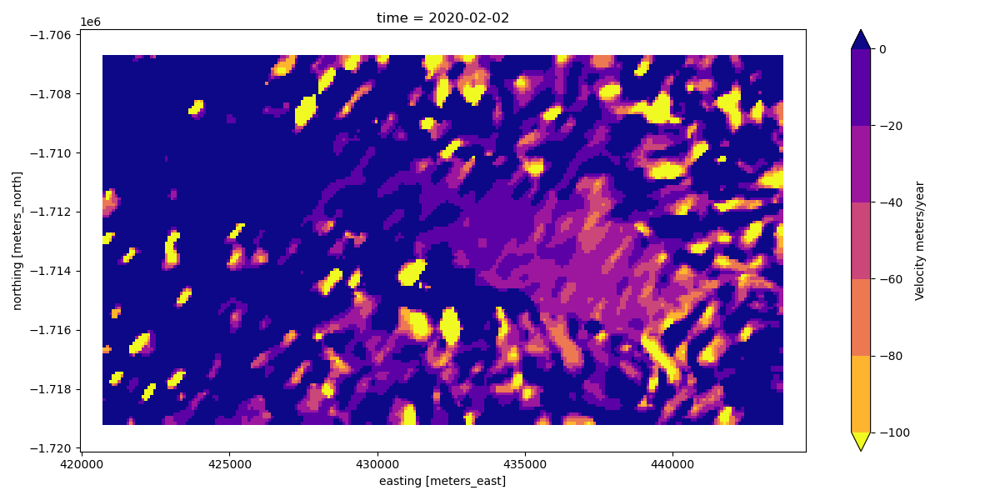

<IPython.core.display.Javascript object>


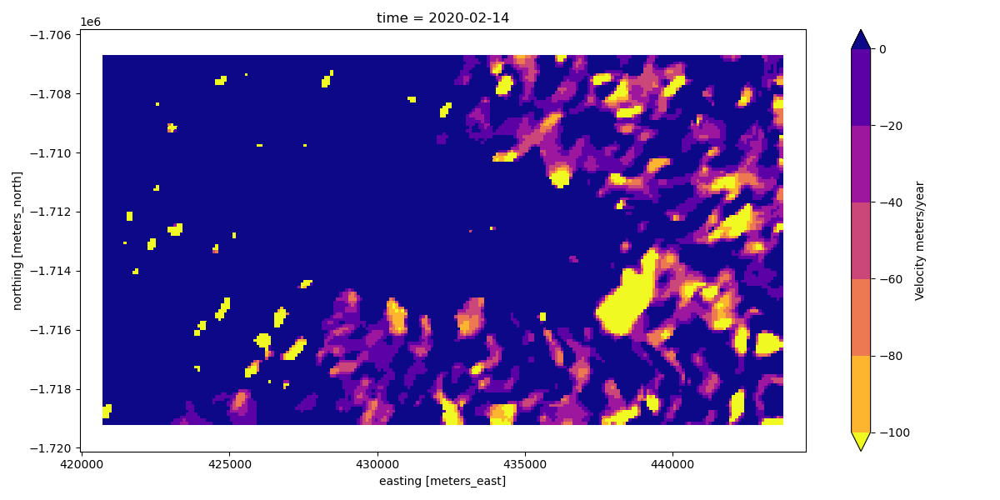

<IPython.core.display.Javascript object>


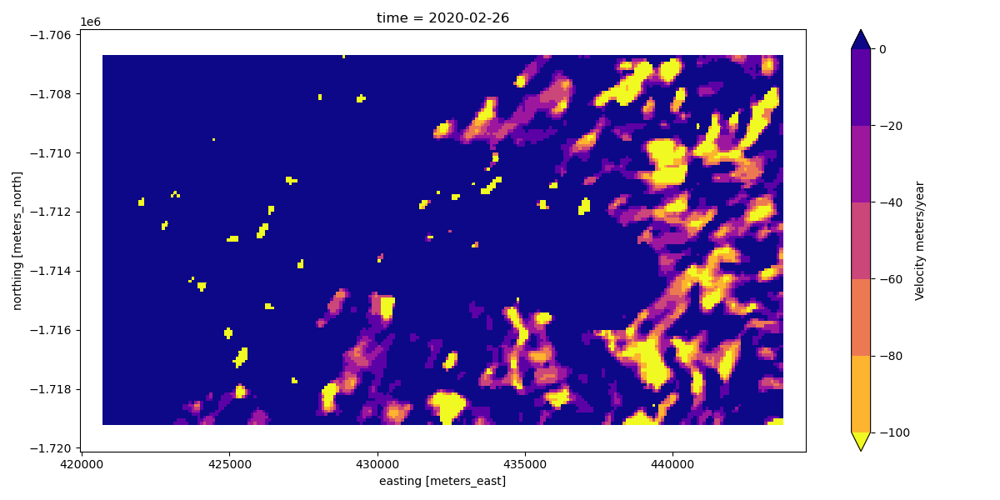

<IPython.core.display.Javascript object>


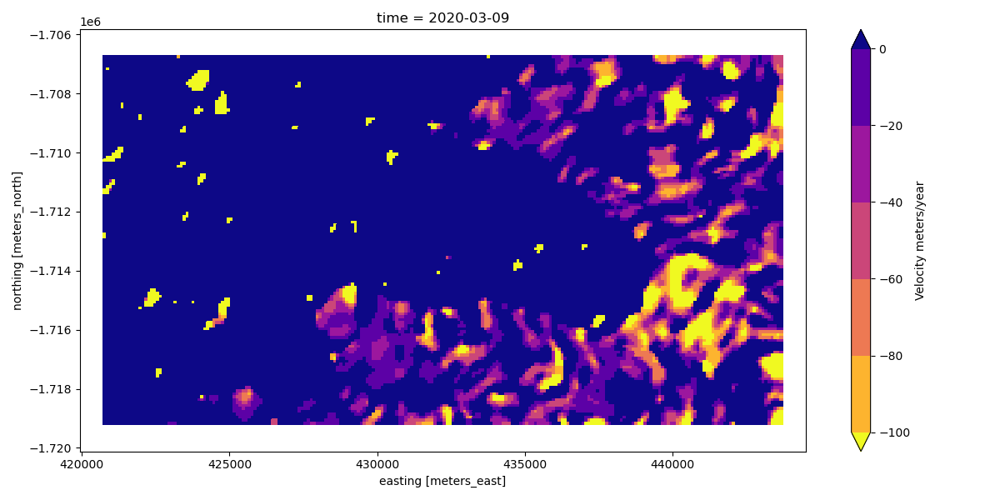

<IPython.core.display.Javascript object>


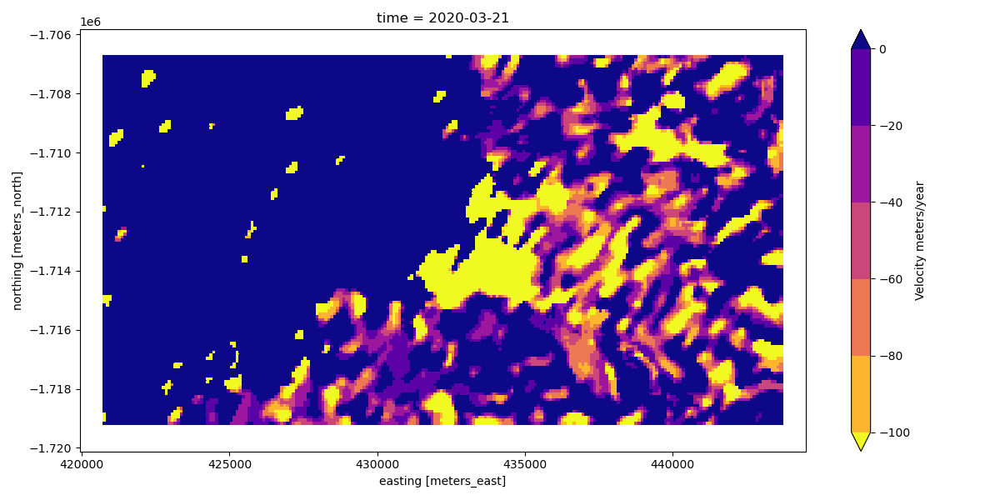

<IPython.core.display.Javascript object>


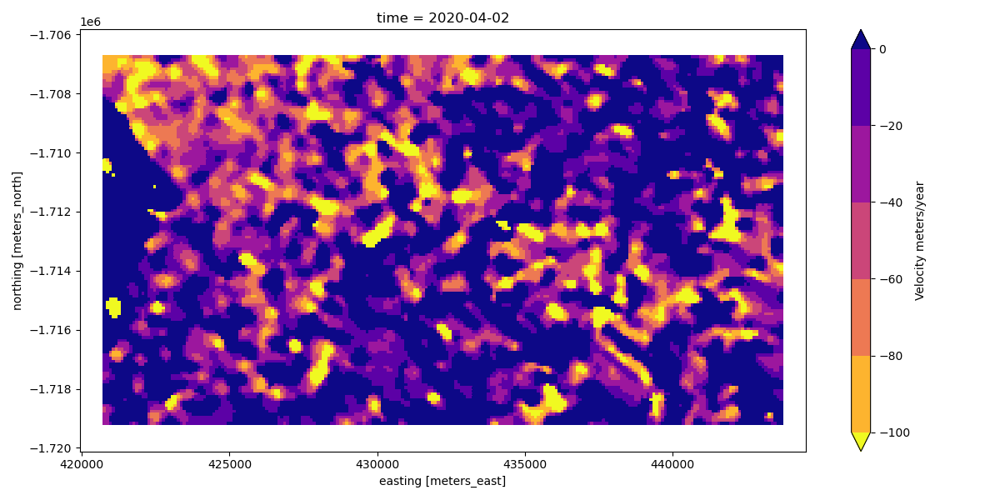

<IPython.core.display.Javascript object>


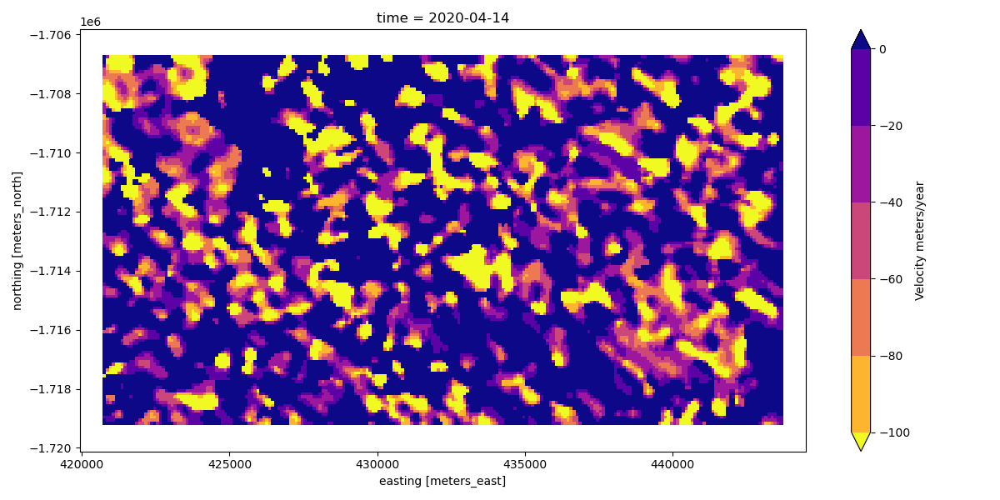

<IPython.core.display.Javascript object>


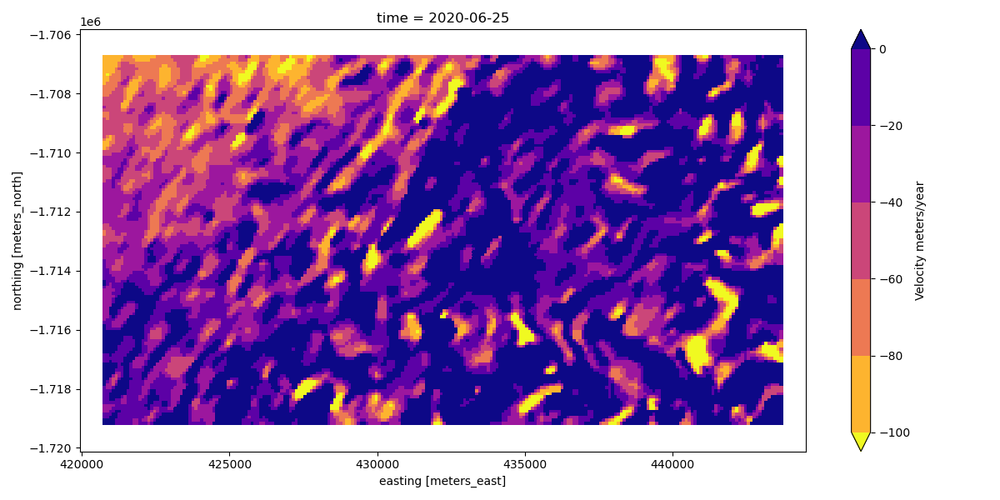

<IPython.core.display.Javascript object>


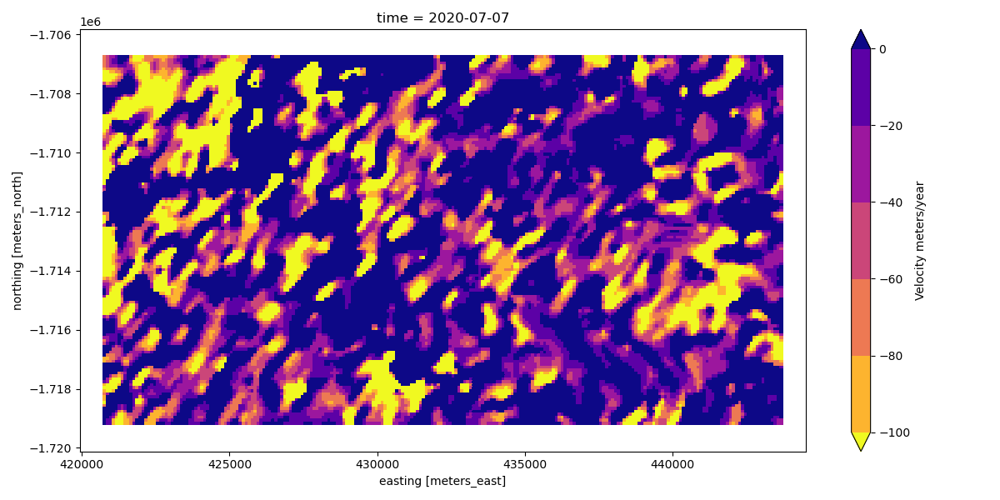

<IPython.core.display.Javascript object>


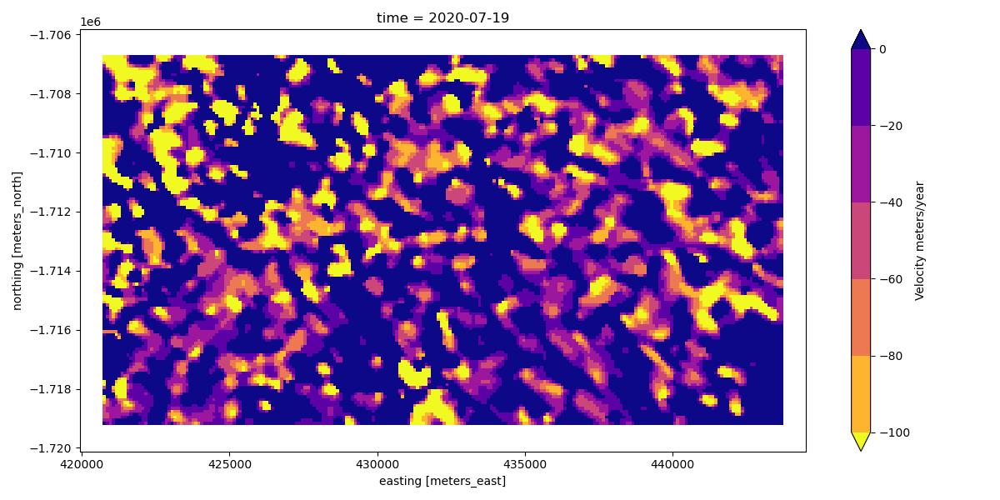

In [20]:
for i, img in enumerate(ds.time):
    date = np.datetime_as_string(img.values)[0:10]

    cmap = mpl.cm.plasma_r
    levels = [0, -20, -40, -60, -80, -100]

    fig= plt.figure(figsize=(12,6))

    ax = plt.gca()
    ds.az.isel(time=i).plot(levels=levels, 
                            cmap=cmap,
                            cbar_kwargs={'ticks': levels,
                                                   'spacing': 'proportional',
                                                         'label':'Velocity meters/year'})

    plt.axis('equal')
    plt.tight_layout()

    
    #plt.savefig(f'/media/rag110/RGFell_UC1/RGF/RGF_phd/Results/Borchgrevink_north/Parker_IT/az/{date}_az_Parker_IT.png')

<IPython.core.display.Javascript object>


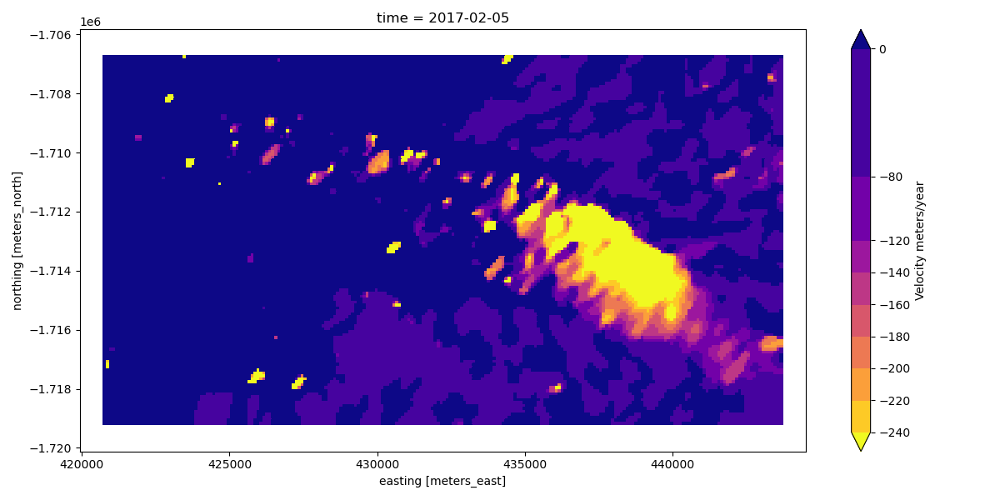

<IPython.core.display.Javascript object>


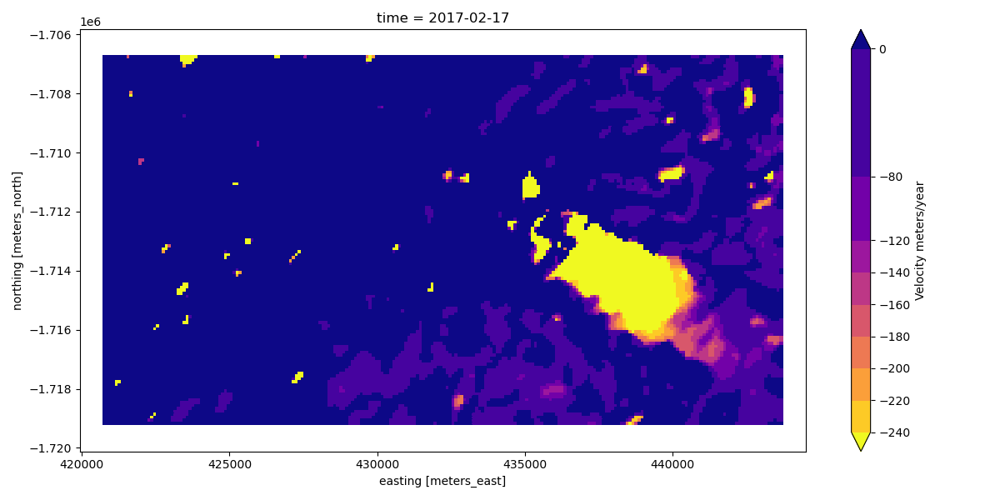

<IPython.core.display.Javascript object>


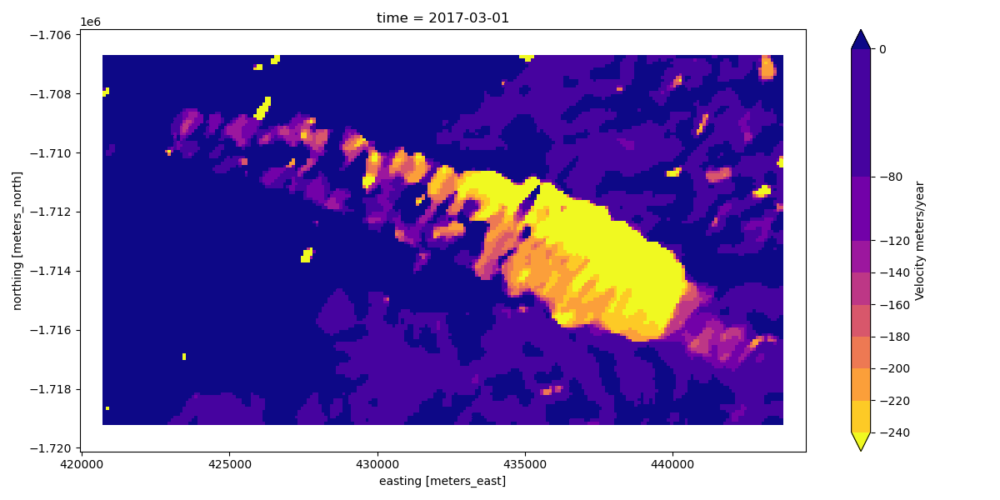

<IPython.core.display.Javascript object>


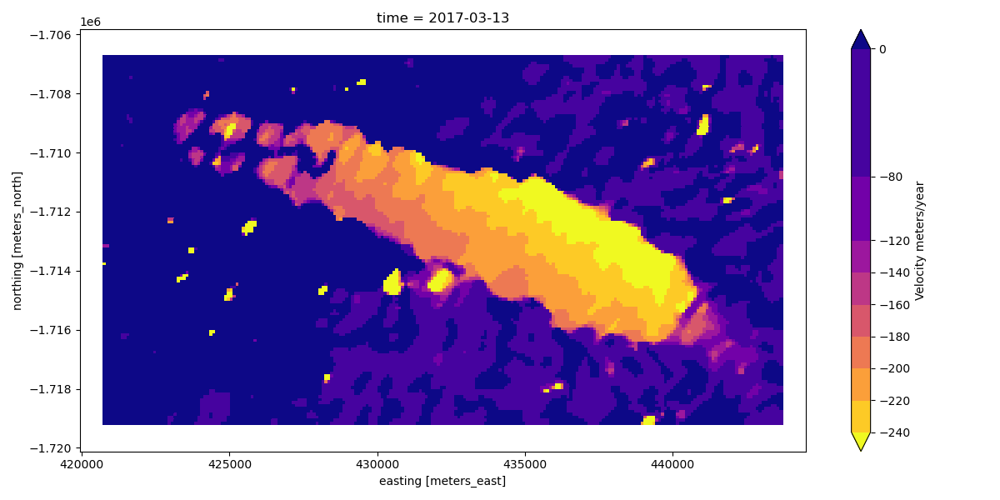

<IPython.core.display.Javascript object>


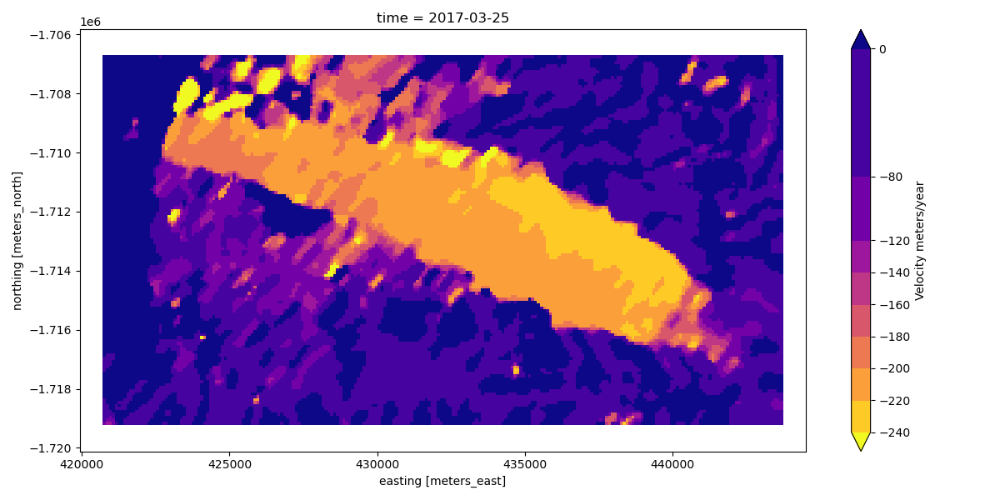

<IPython.core.display.Javascript object>


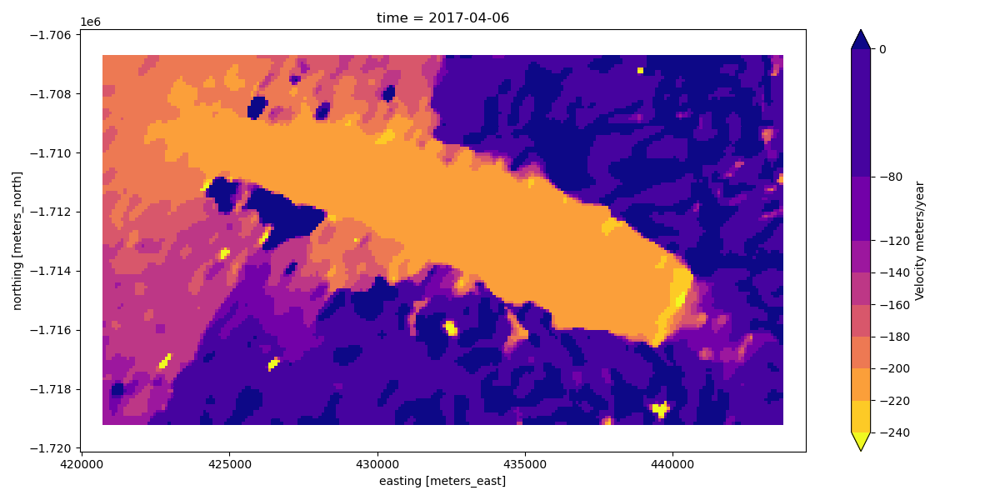

<IPython.core.display.Javascript object>


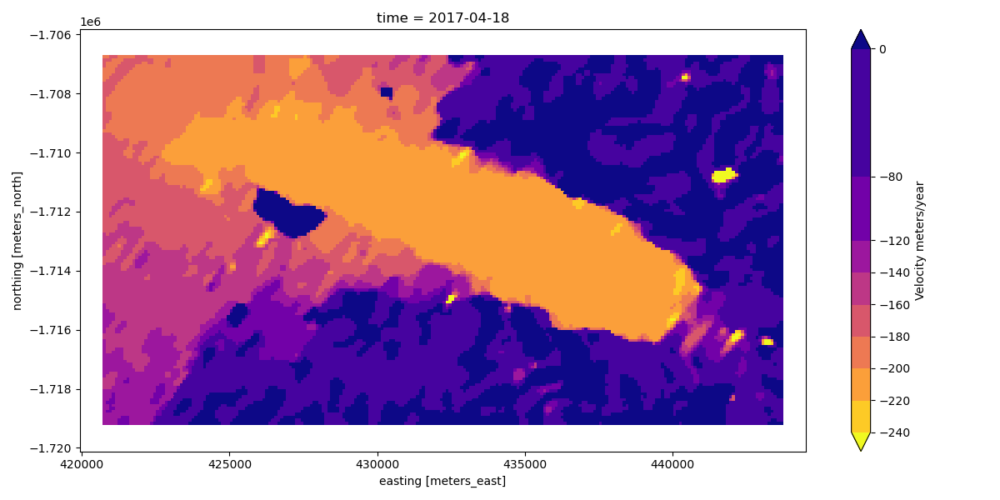

<IPython.core.display.Javascript object>


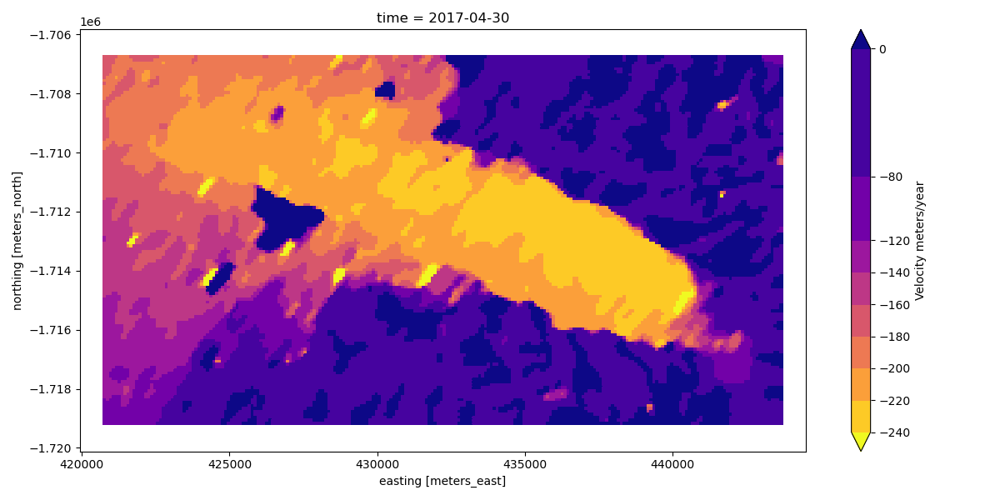

<IPython.core.display.Javascript object>


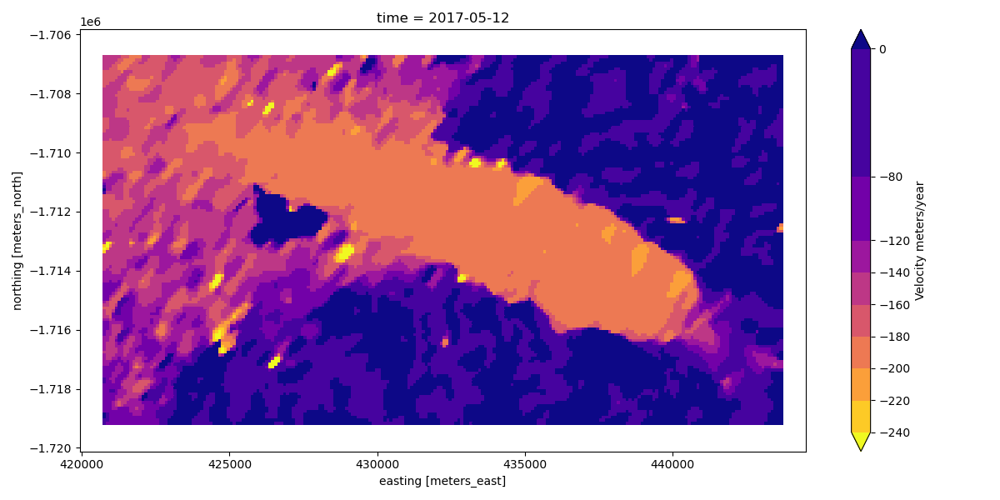

<IPython.core.display.Javascript object>


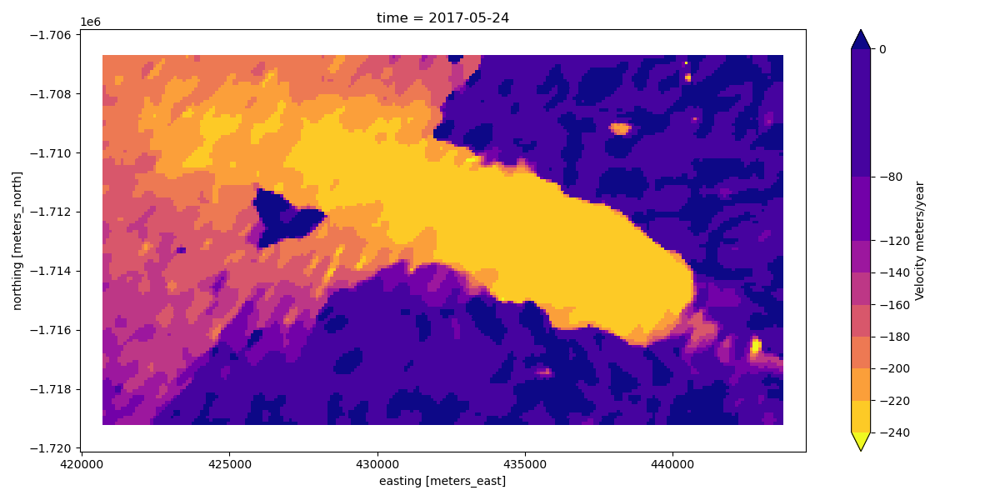

<IPython.core.display.Javascript object>


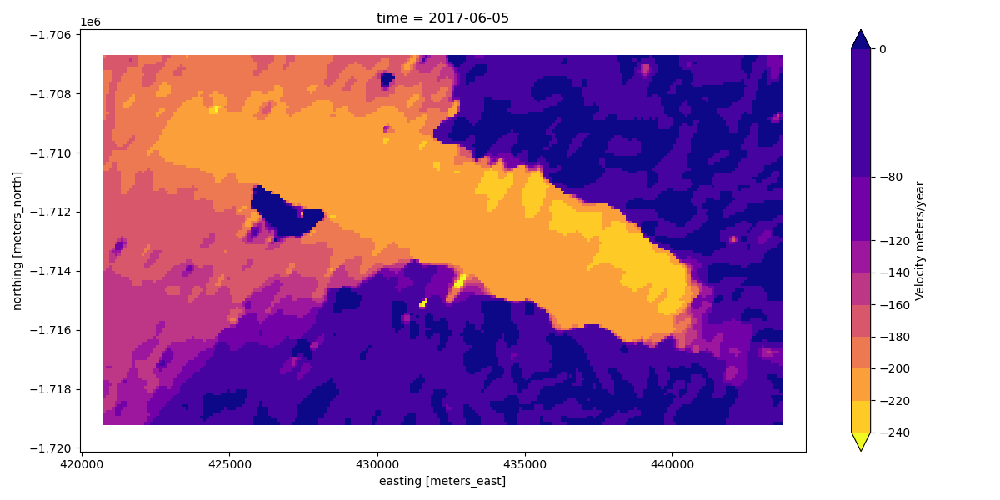

<IPython.core.display.Javascript object>


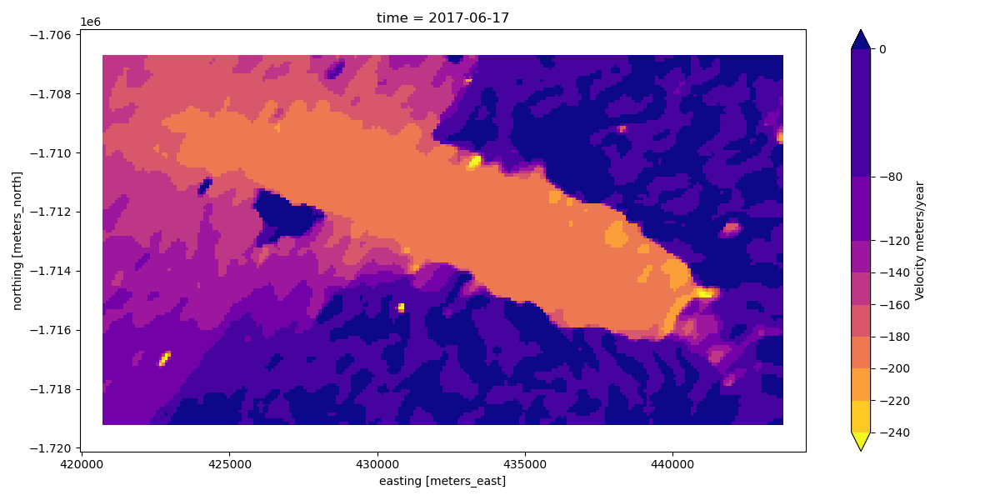

<IPython.core.display.Javascript object>


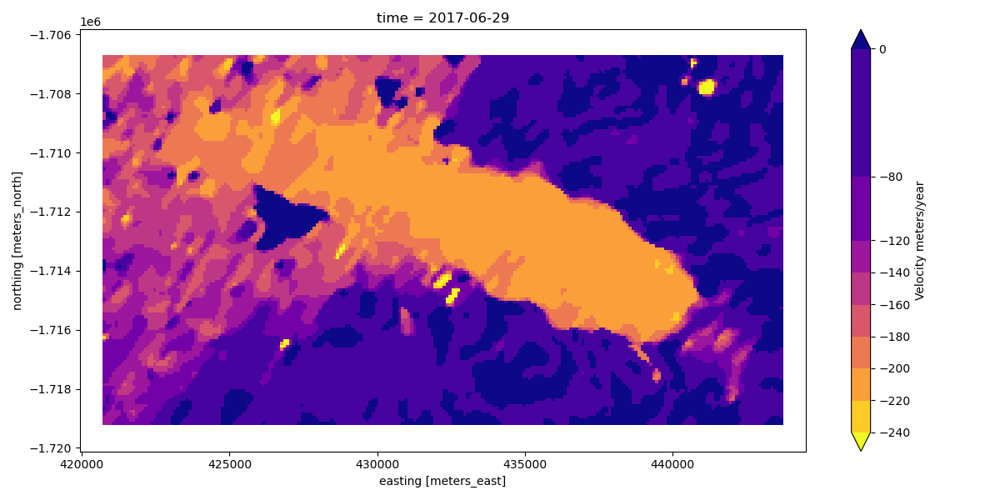

<IPython.core.display.Javascript object>


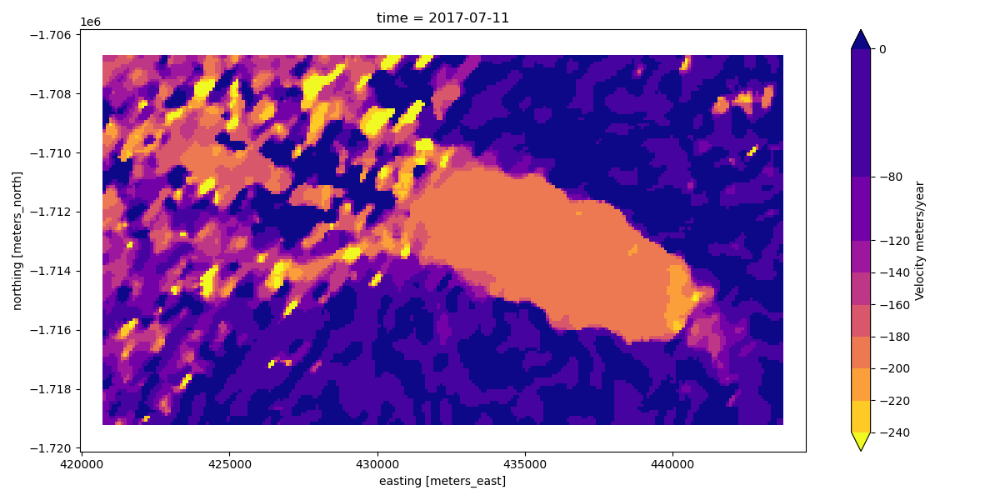

<IPython.core.display.Javascript object>


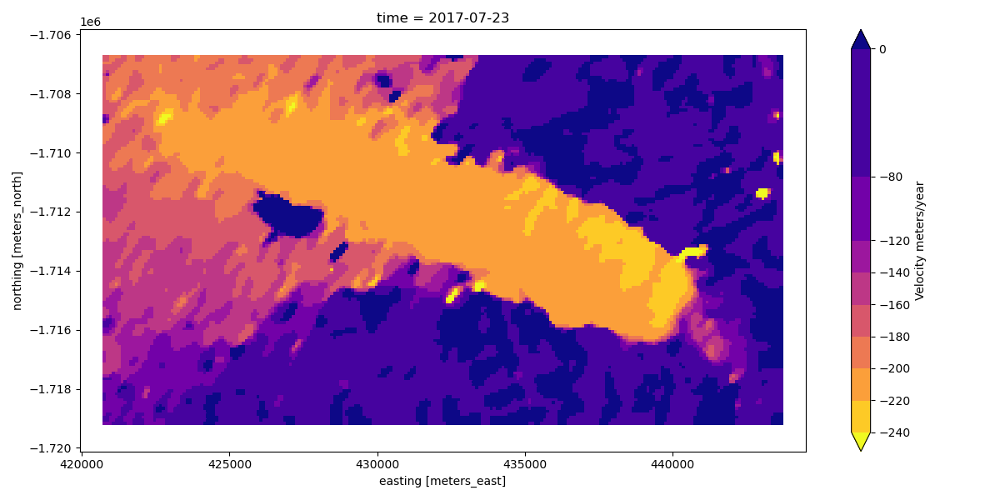

<IPython.core.display.Javascript object>


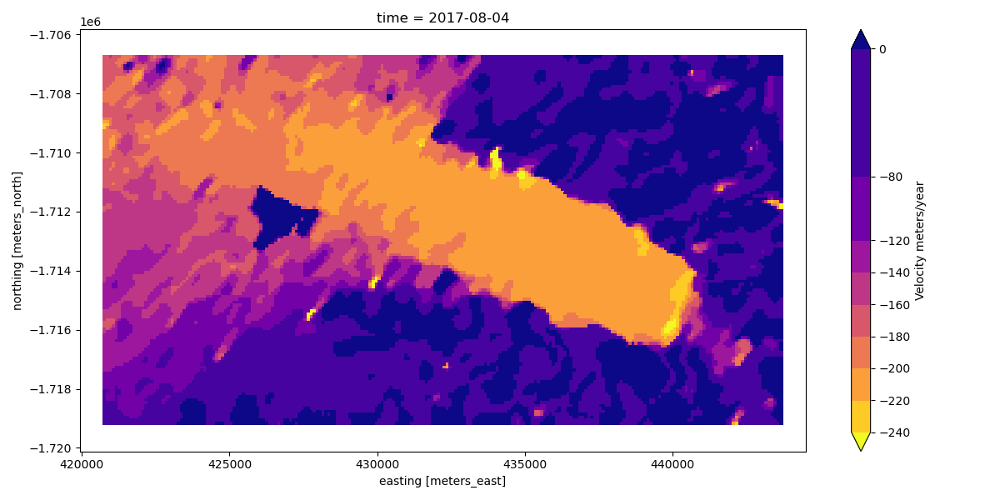

<IPython.core.display.Javascript object>


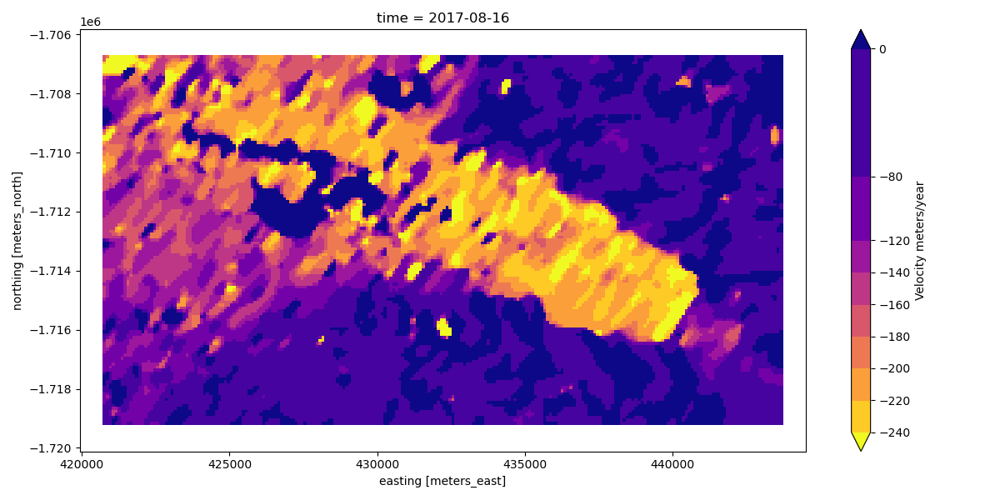

<IPython.core.display.Javascript object>


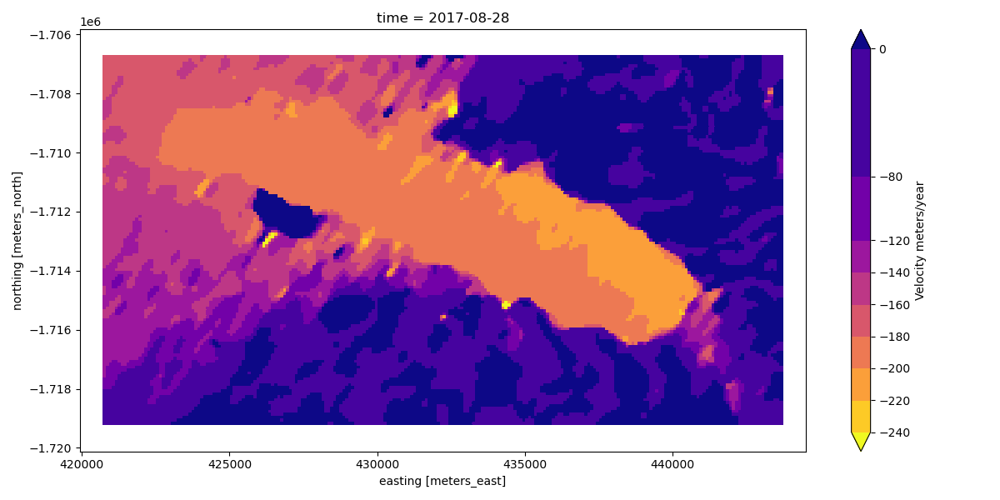

<IPython.core.display.Javascript object>


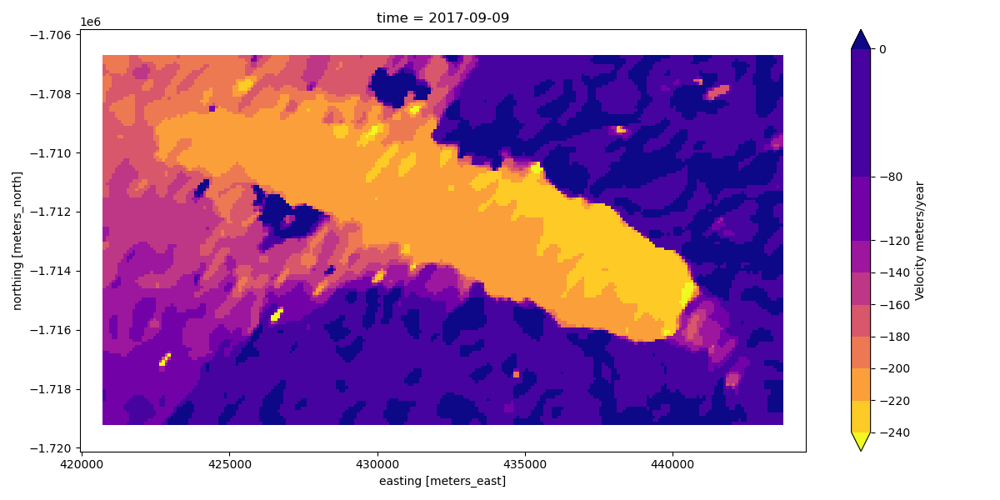

<IPython.core.display.Javascript object>


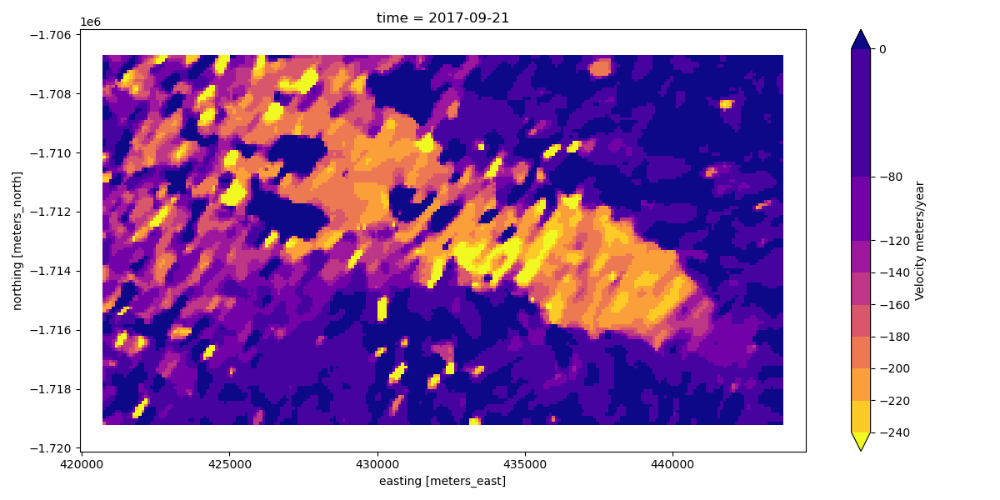

<IPython.core.display.Javascript object>


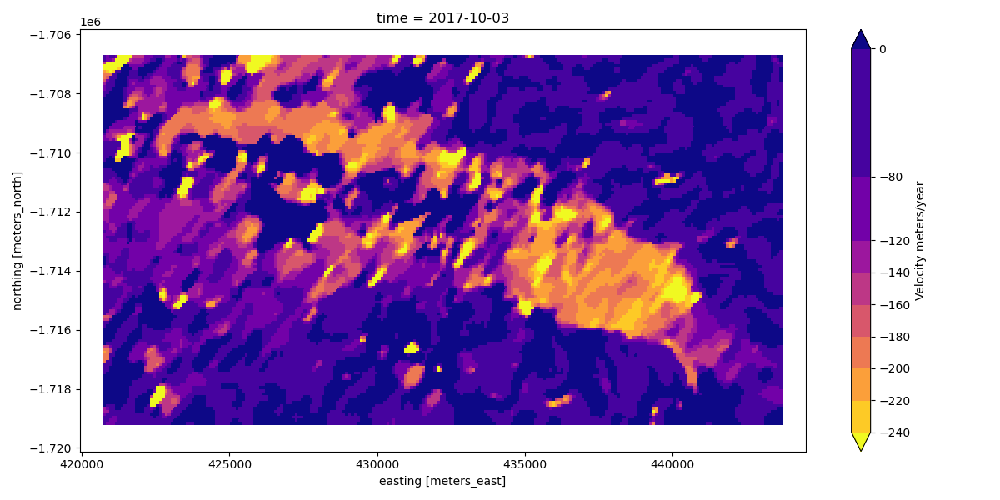

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


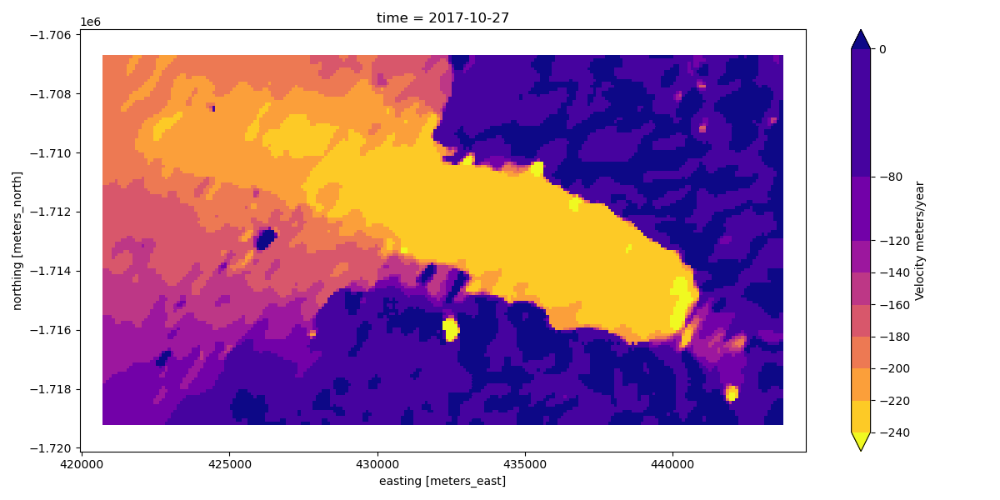

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


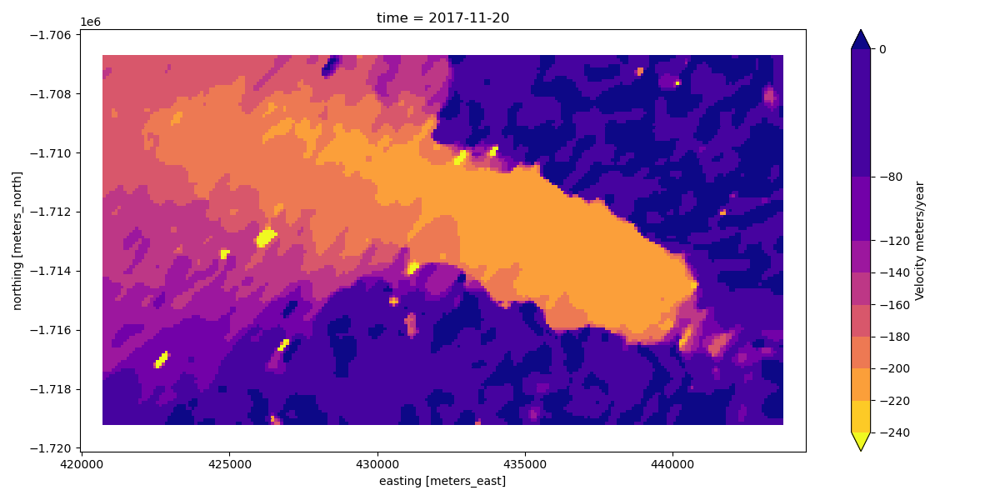

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


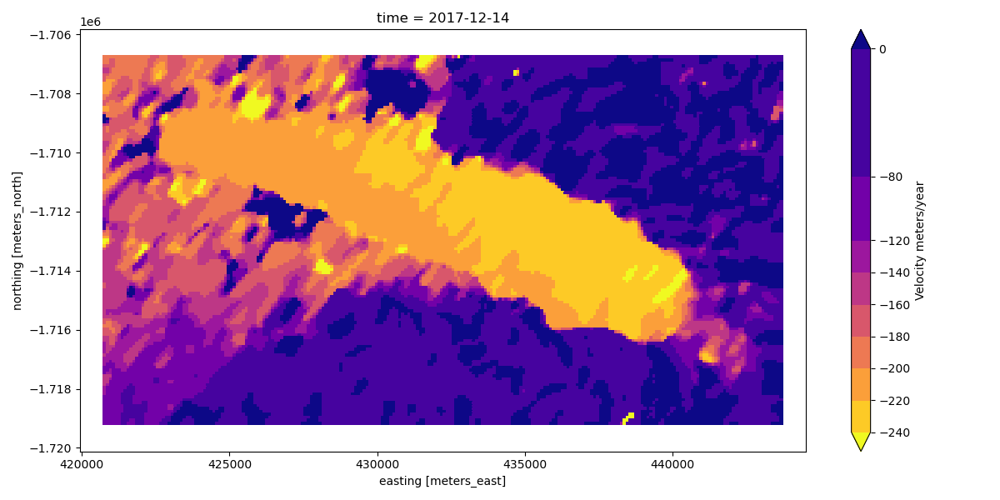

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


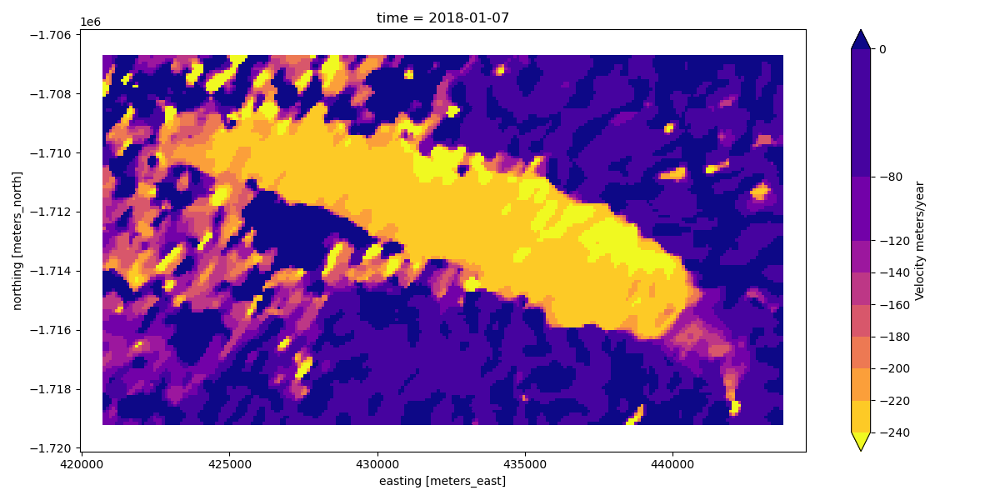

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


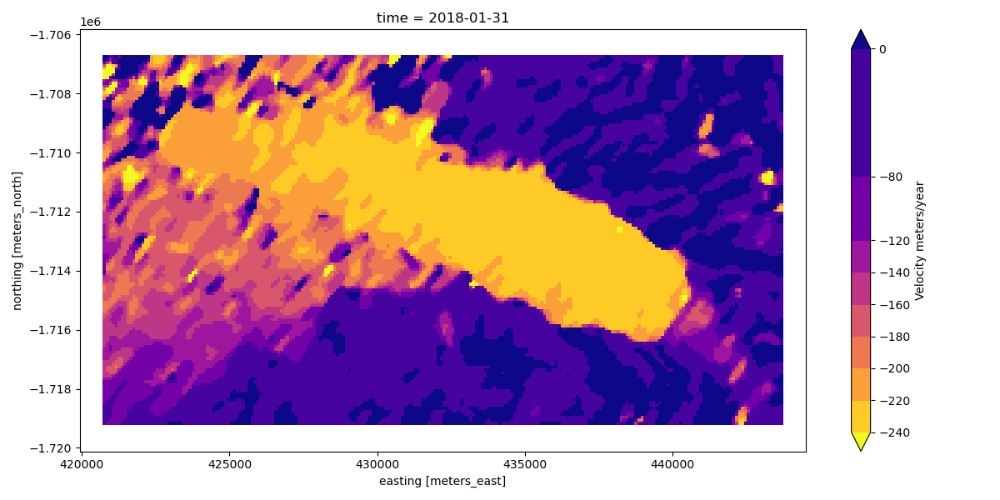

<IPython.core.display.Javascript object>


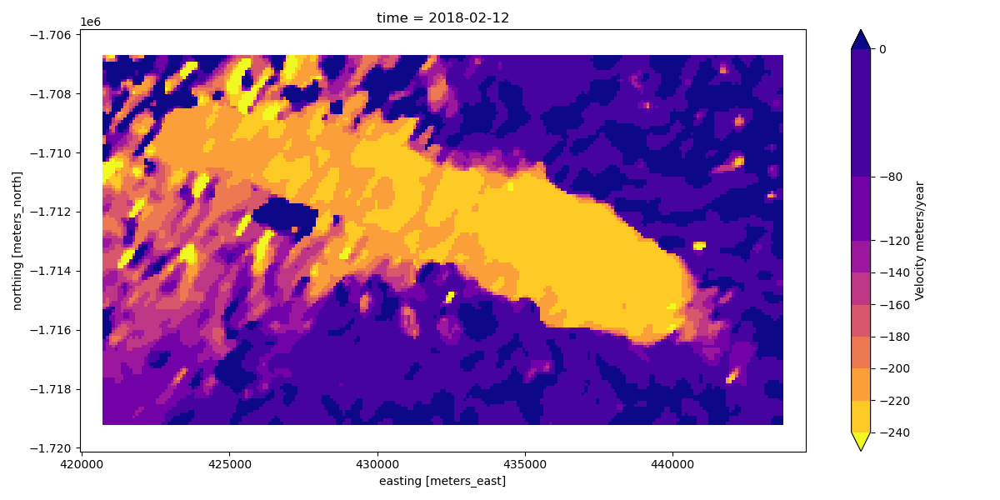

<IPython.core.display.Javascript object>


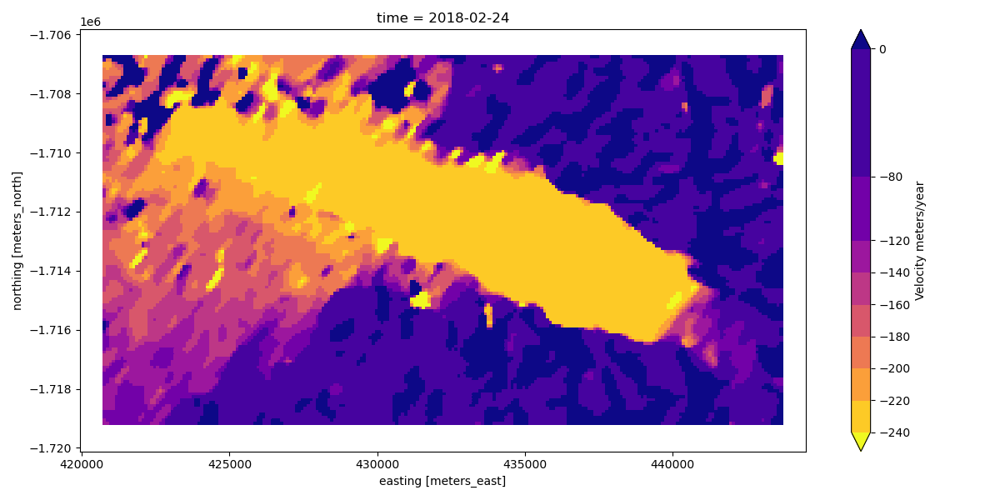

<IPython.core.display.Javascript object>


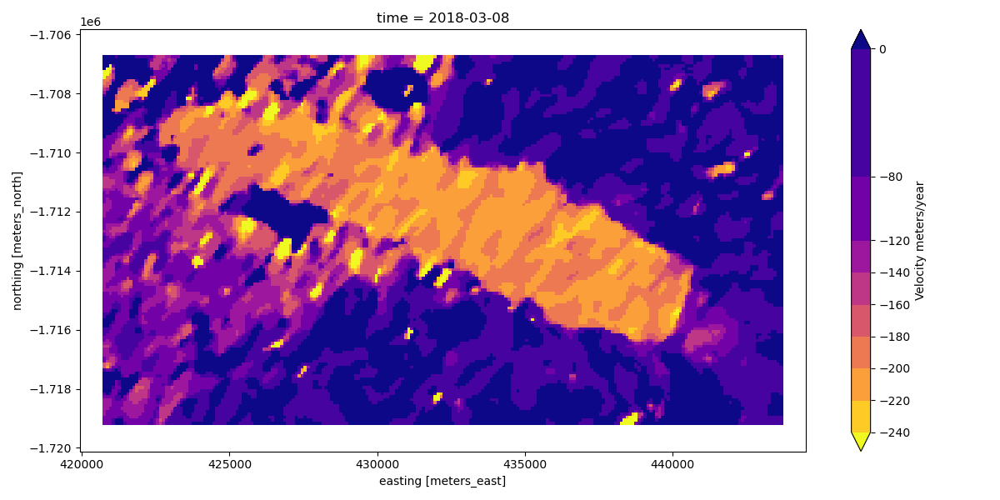

<IPython.core.display.Javascript object>


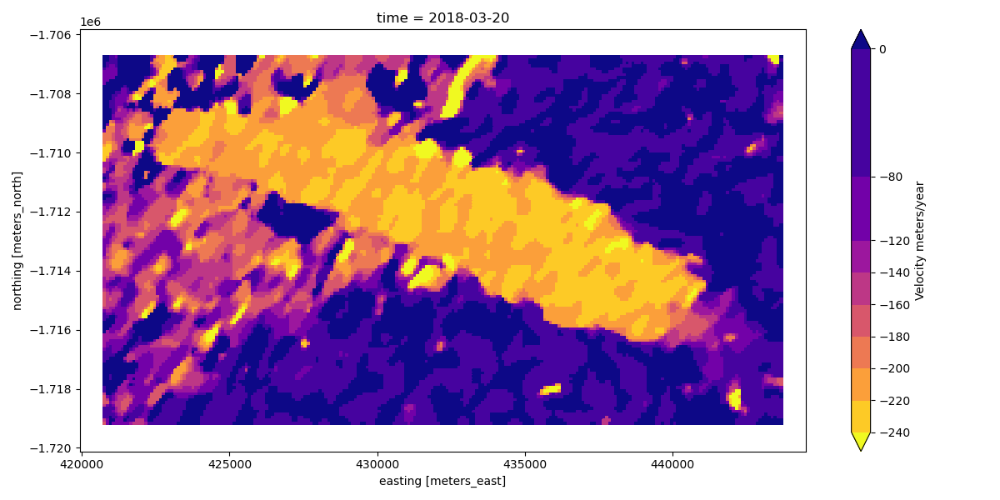

<IPython.core.display.Javascript object>


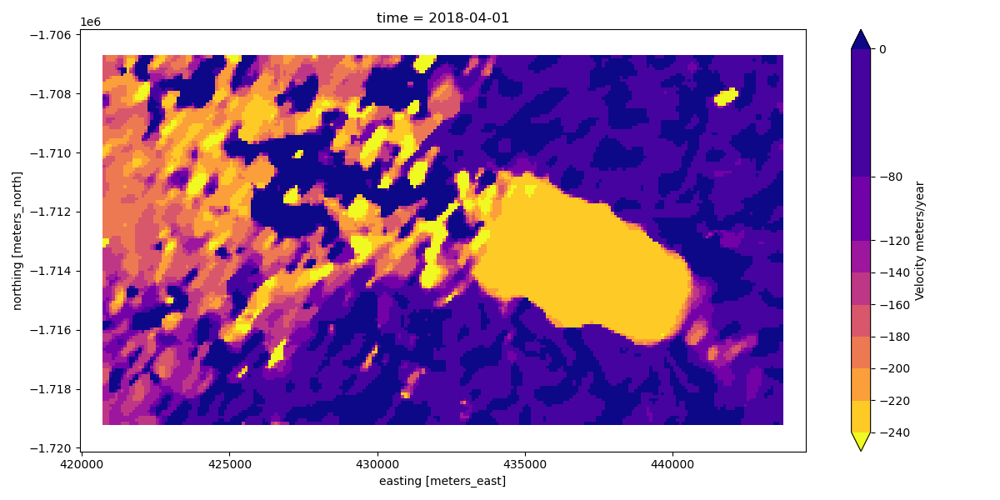

<IPython.core.display.Javascript object>


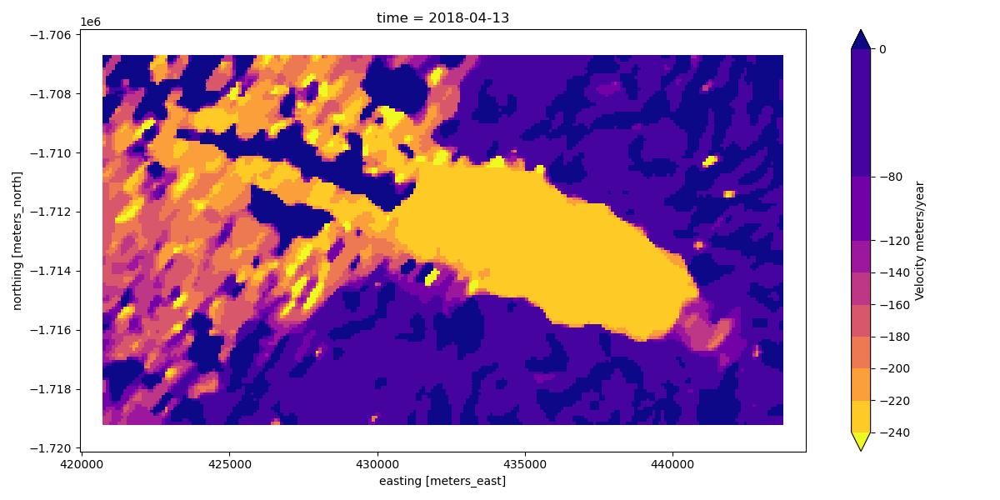

<IPython.core.display.Javascript object>


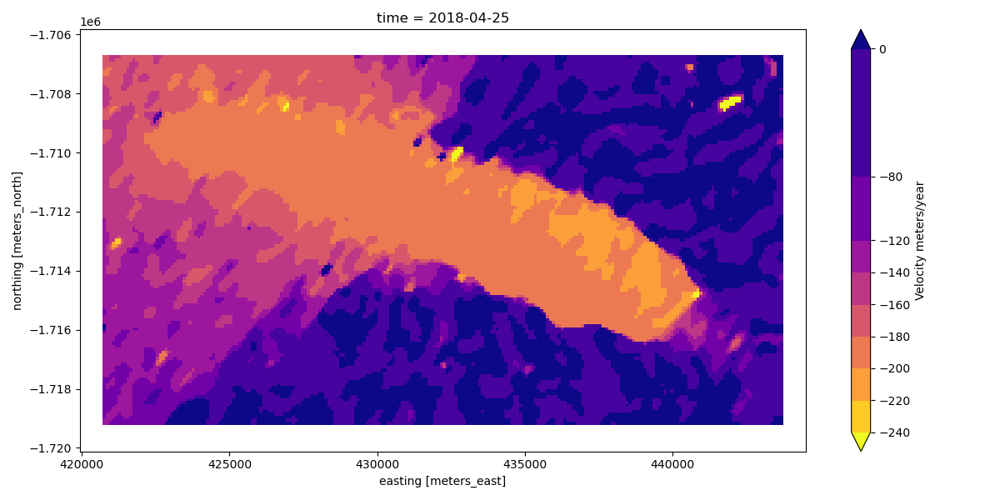

<IPython.core.display.Javascript object>


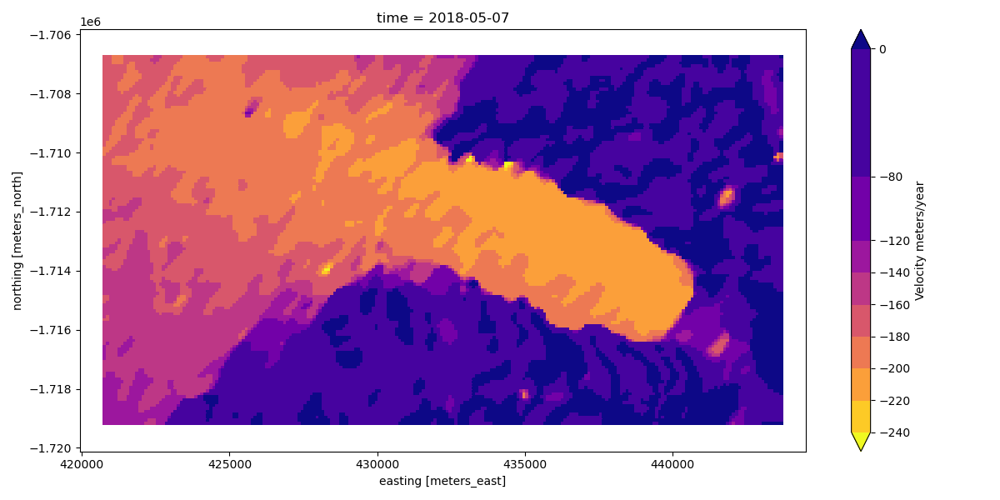

<IPython.core.display.Javascript object>


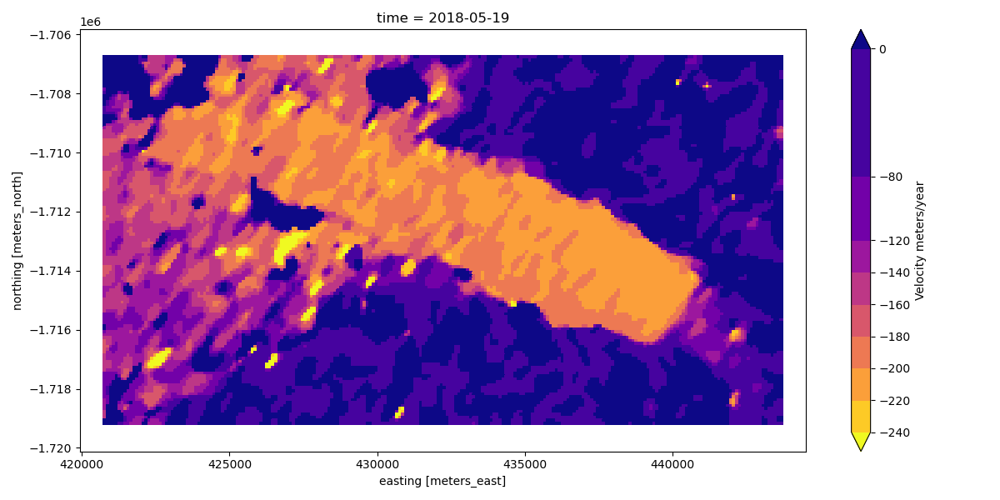

<IPython.core.display.Javascript object>


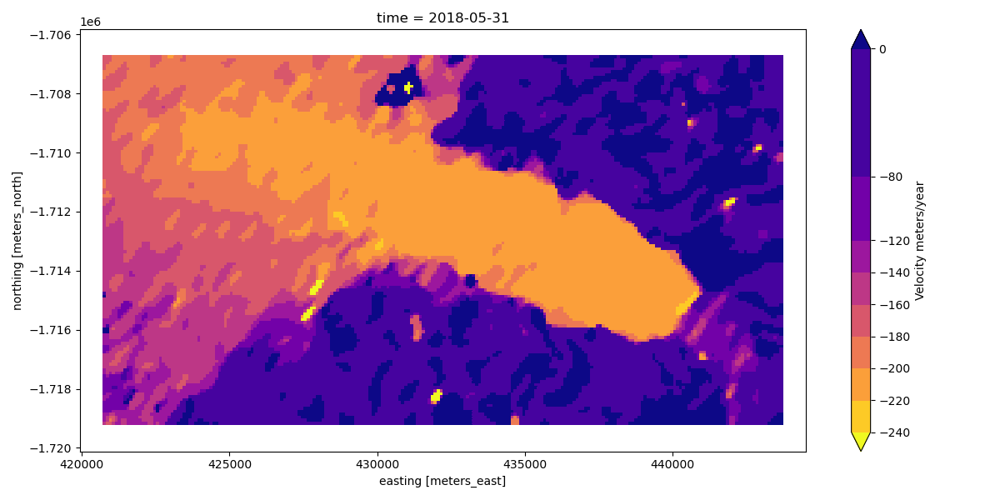

<IPython.core.display.Javascript object>


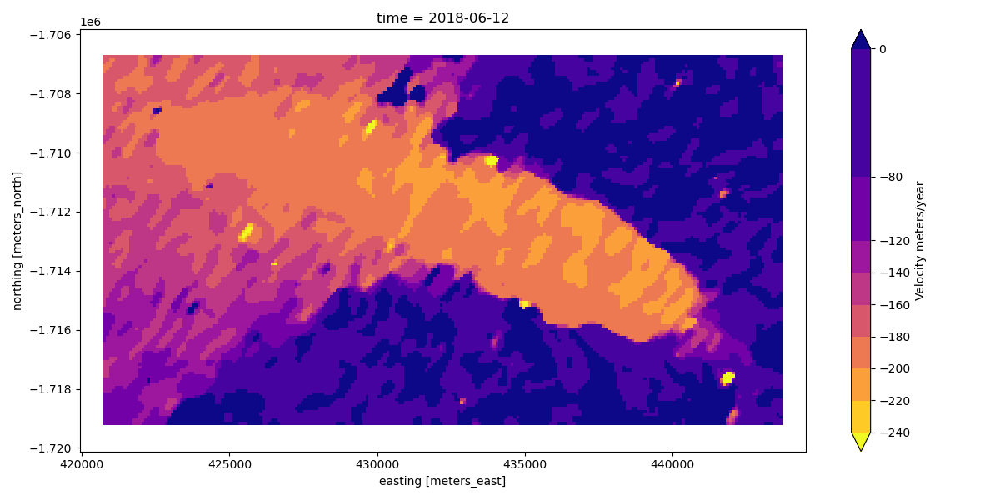

<IPython.core.display.Javascript object>


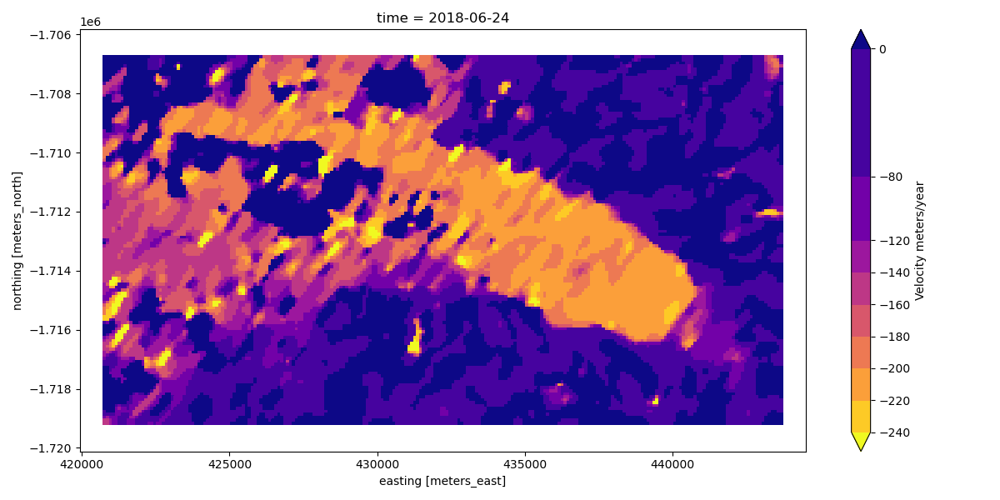

<IPython.core.display.Javascript object>


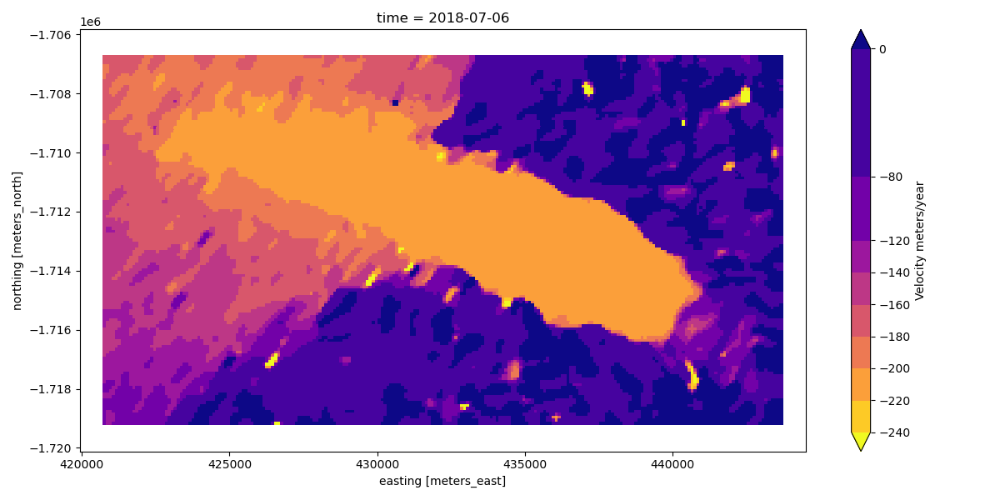

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


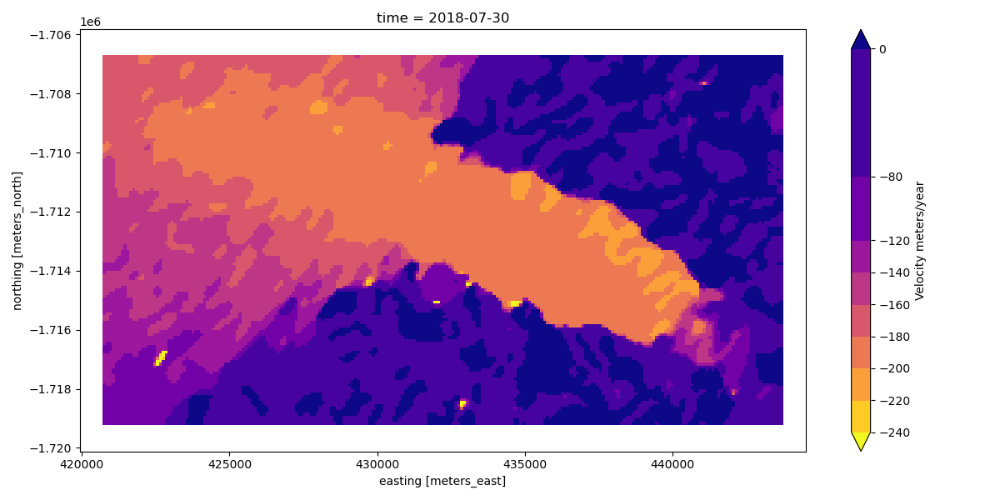

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


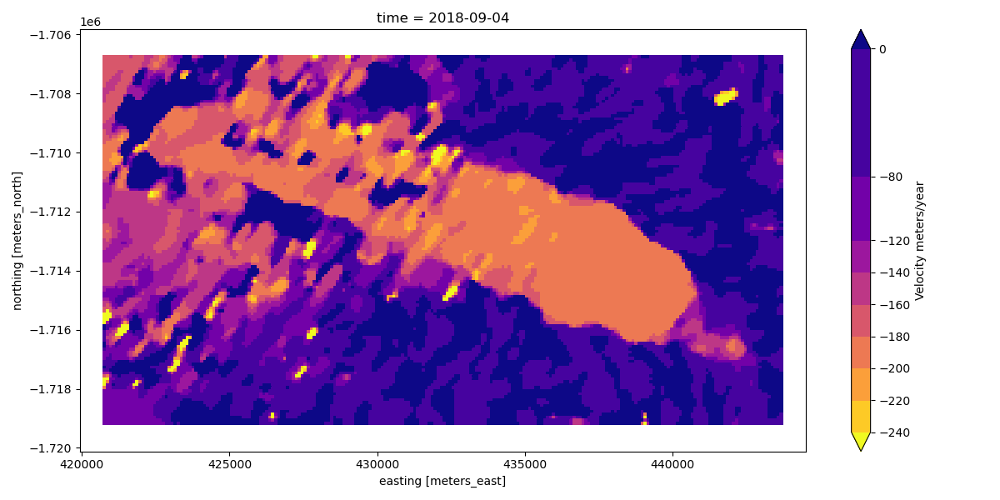

<IPython.core.display.Javascript object>


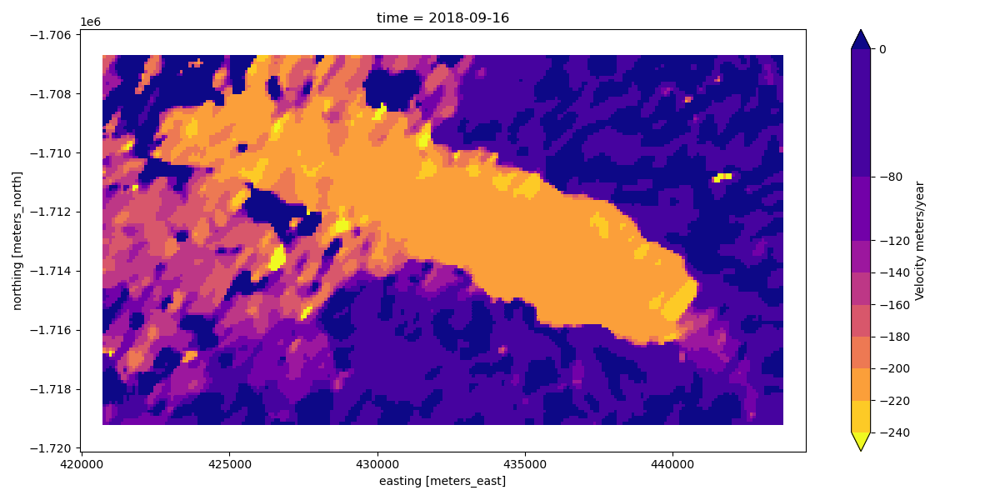

<IPython.core.display.Javascript object>


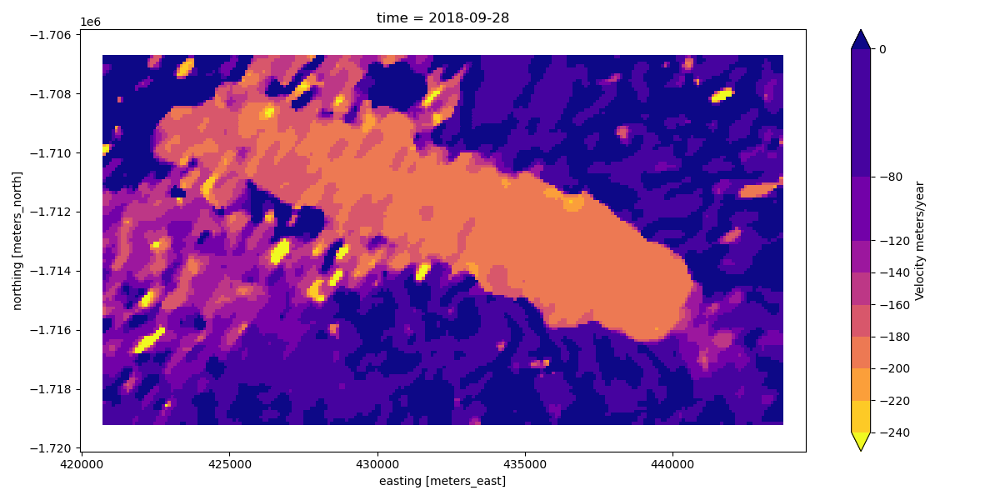

<IPython.core.display.Javascript object>


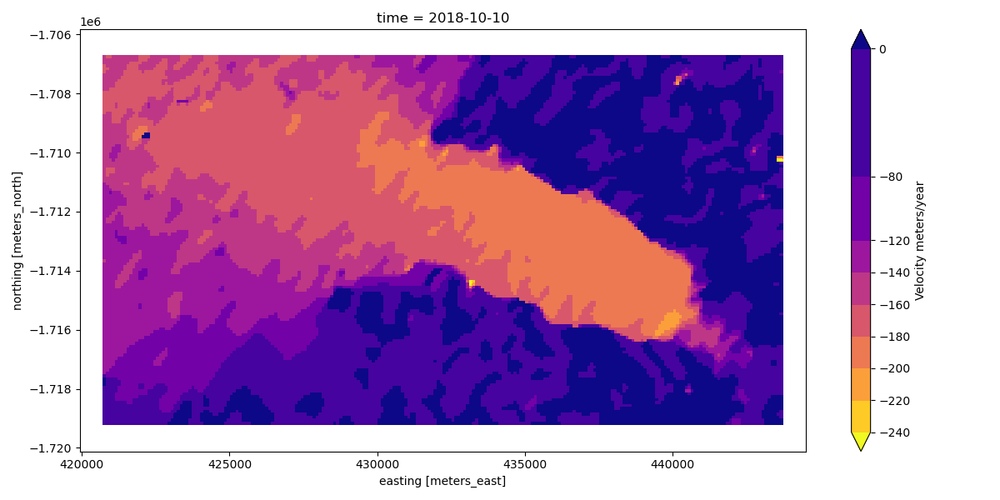

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


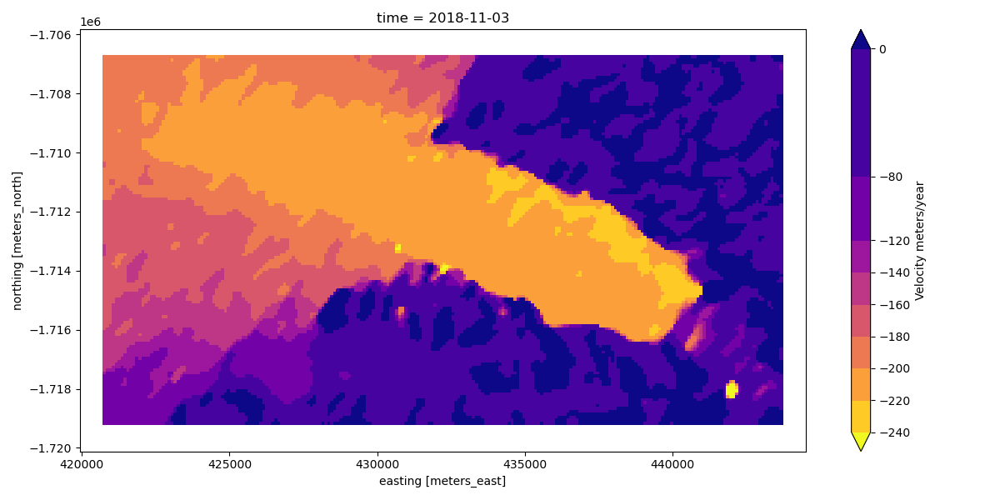

<IPython.core.display.Javascript object>


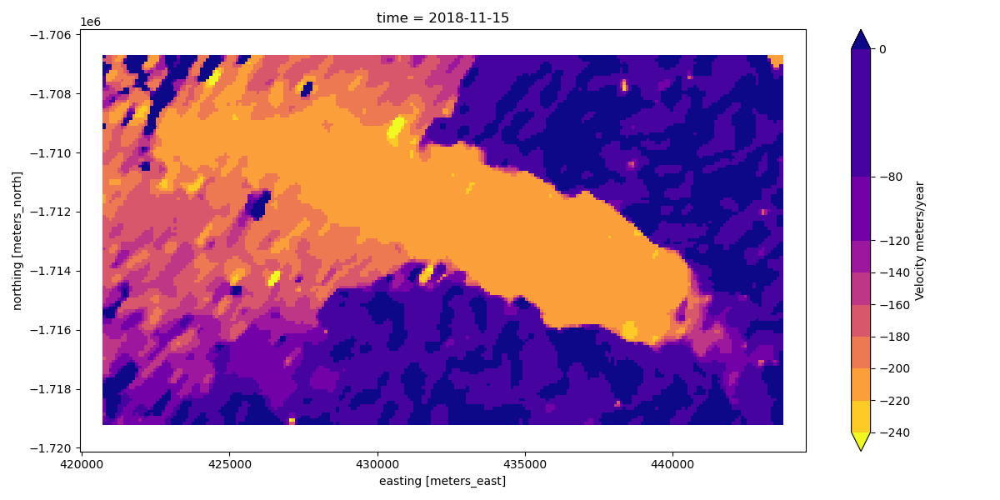

<IPython.core.display.Javascript object>


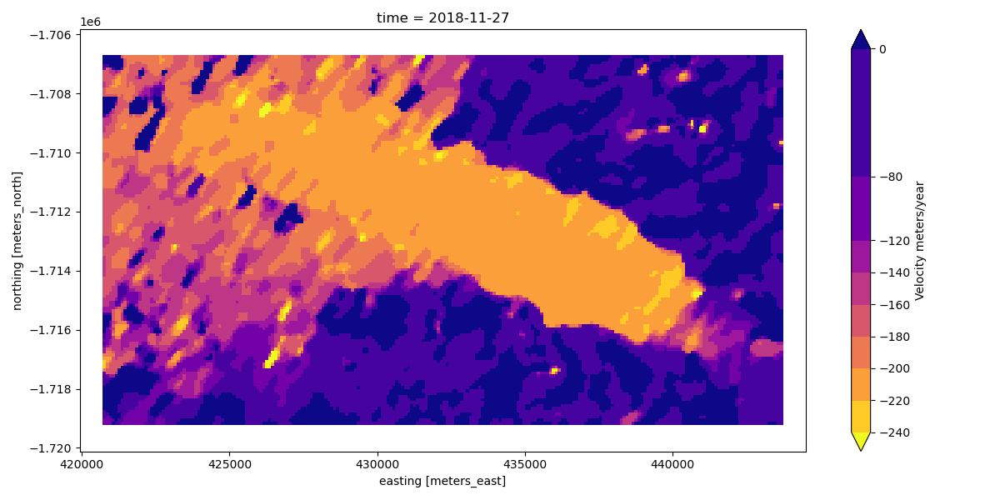

<IPython.core.display.Javascript object>


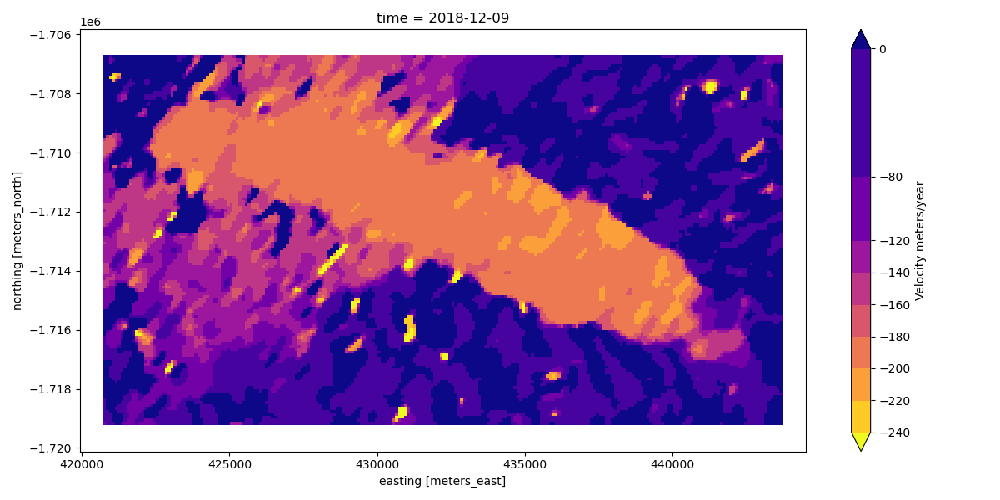

<IPython.core.display.Javascript object>


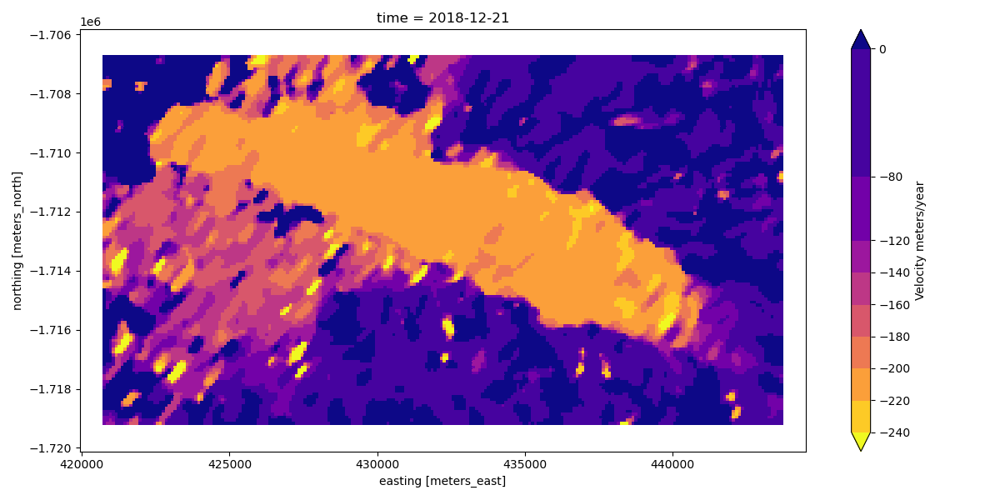

<IPython.core.display.Javascript object>


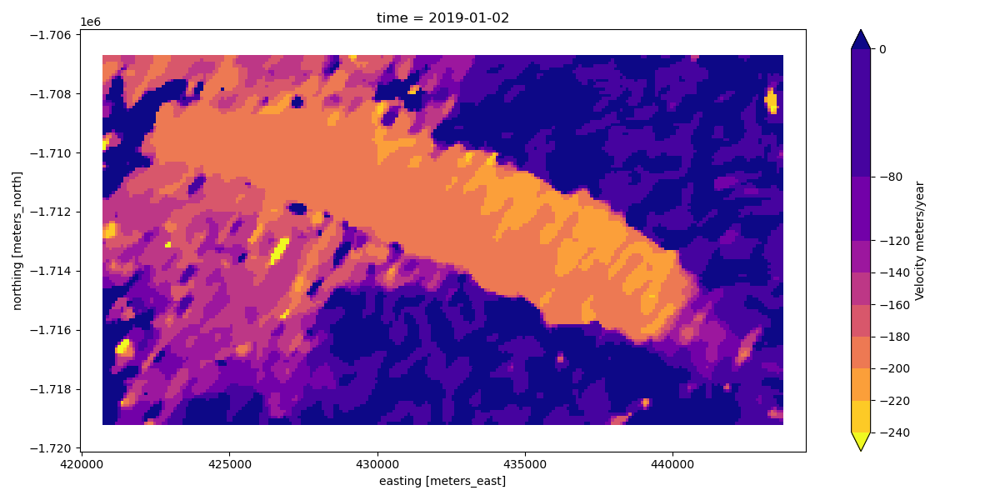

<IPython.core.display.Javascript object>


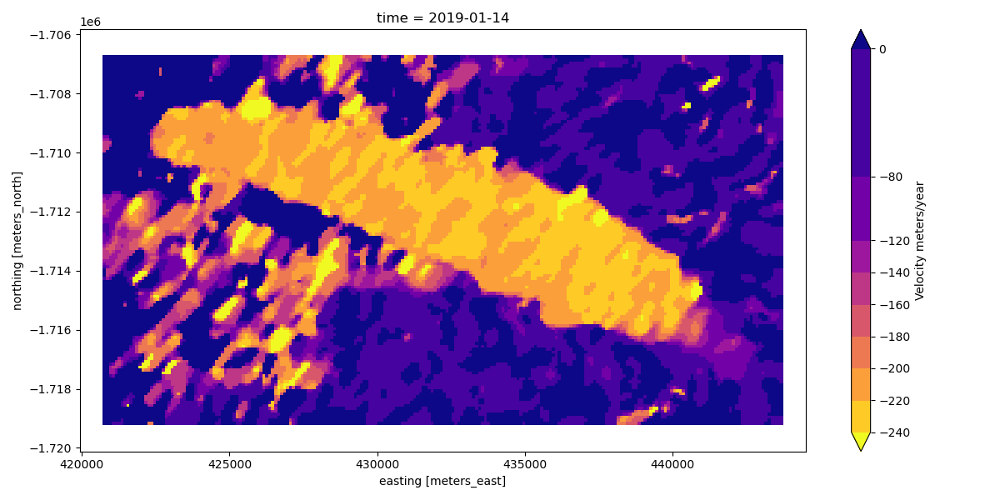

<IPython.core.display.Javascript object>


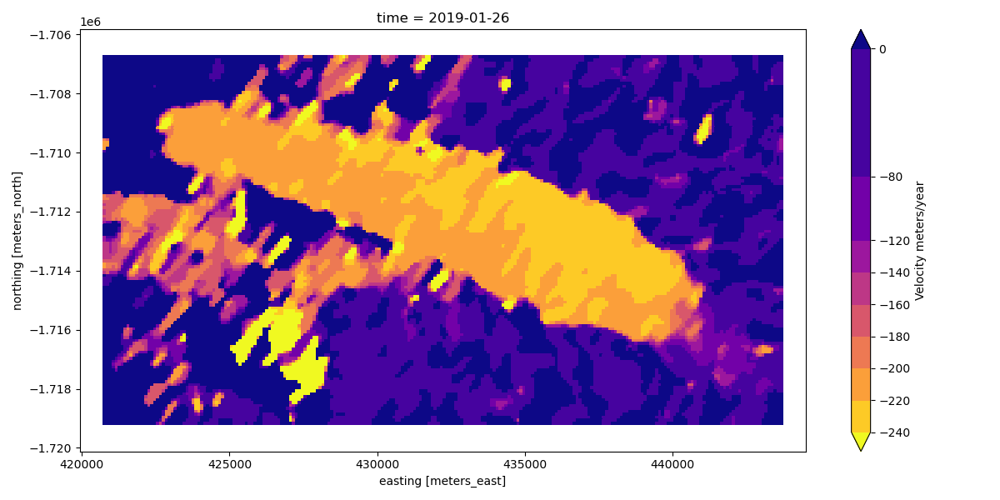

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


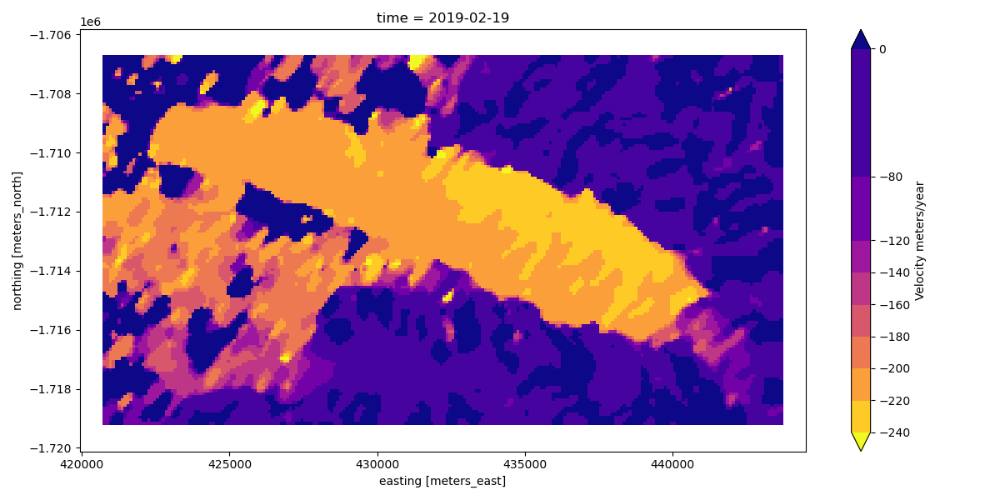

<IPython.core.display.Javascript object>


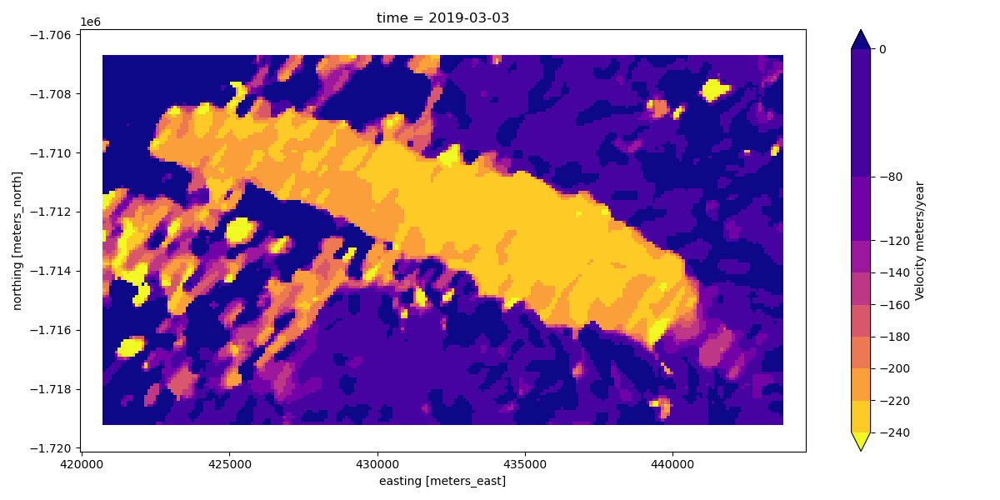

<IPython.core.display.Javascript object>


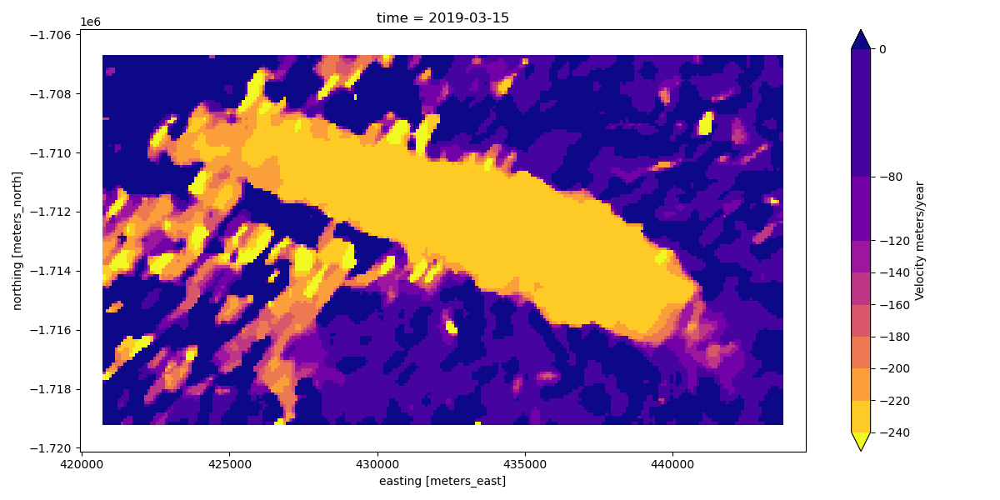

<IPython.core.display.Javascript object>


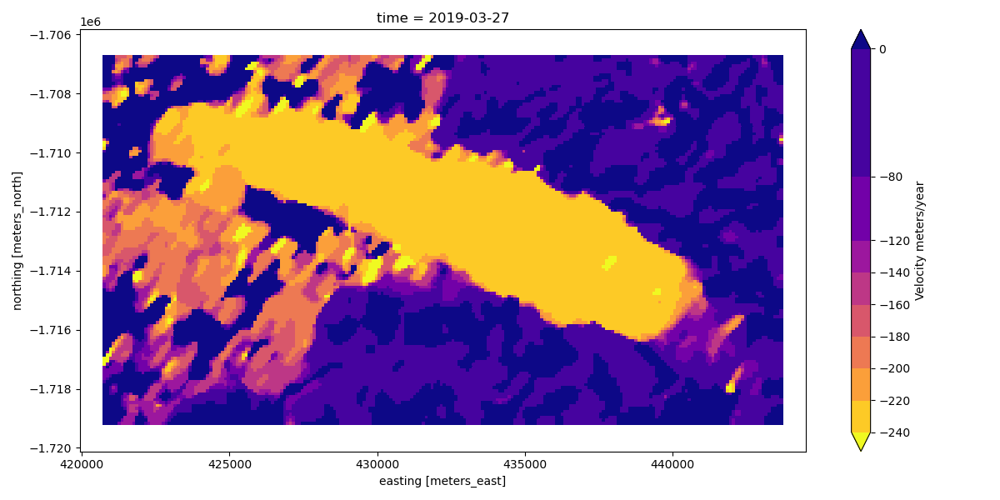

<IPython.core.display.Javascript object>


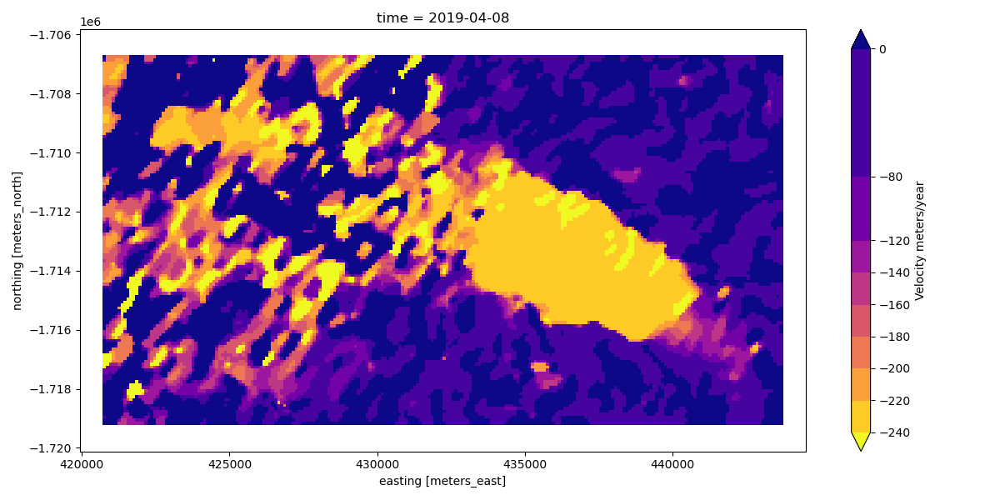

<IPython.core.display.Javascript object>


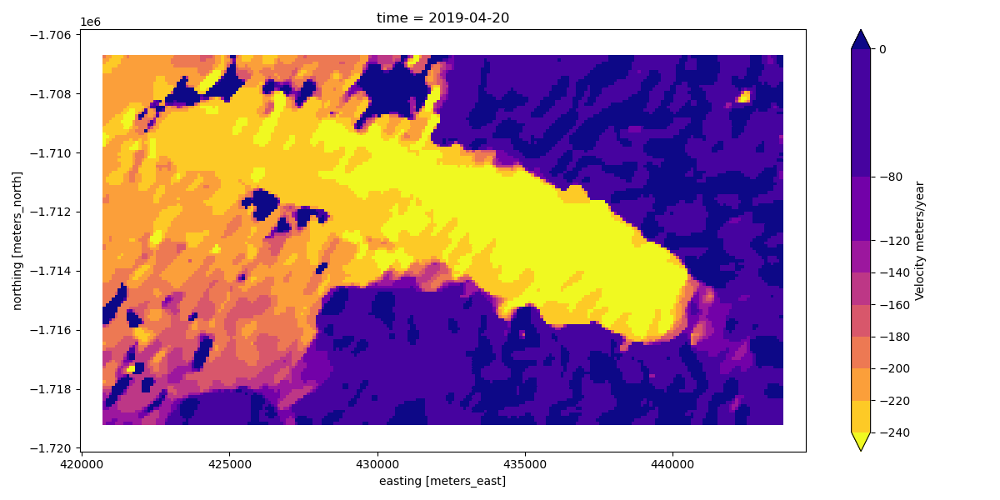

<IPython.core.display.Javascript object>


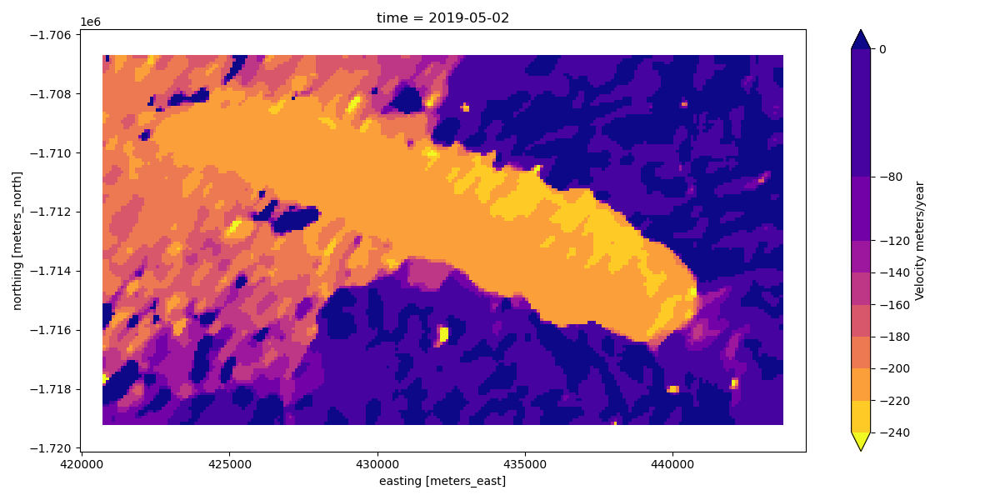

<IPython.core.display.Javascript object>


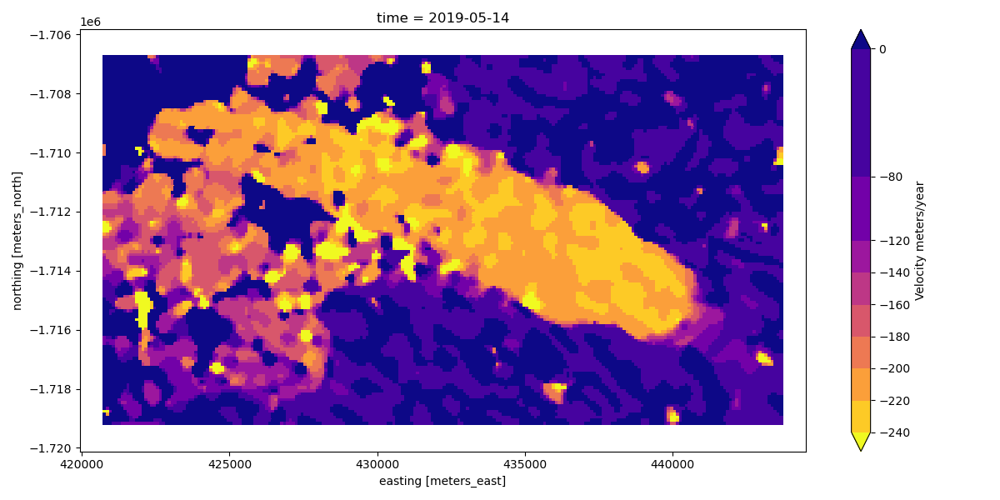

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


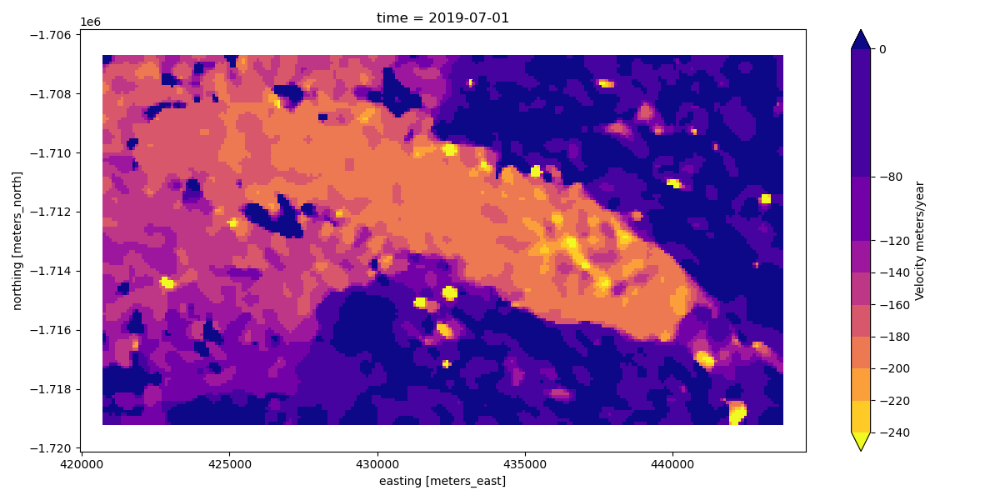

<IPython.core.display.Javascript object>


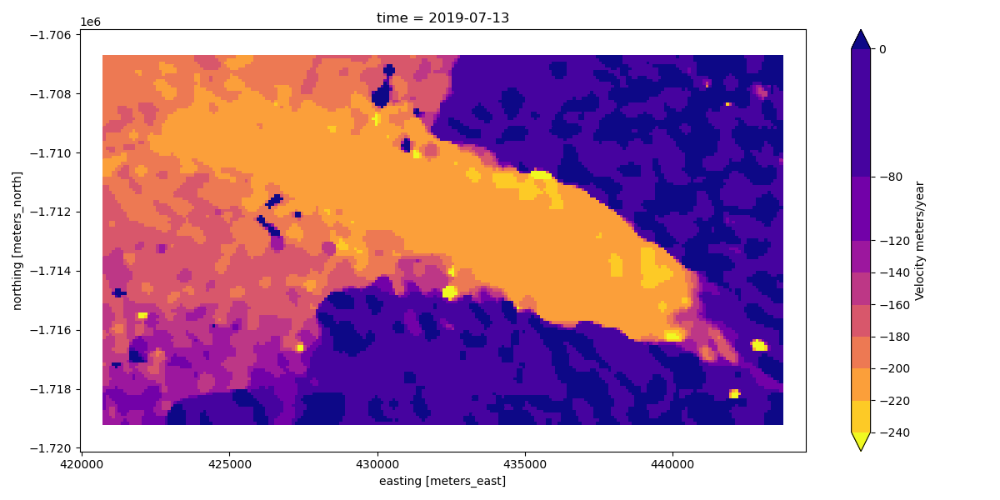

<IPython.core.display.Javascript object>


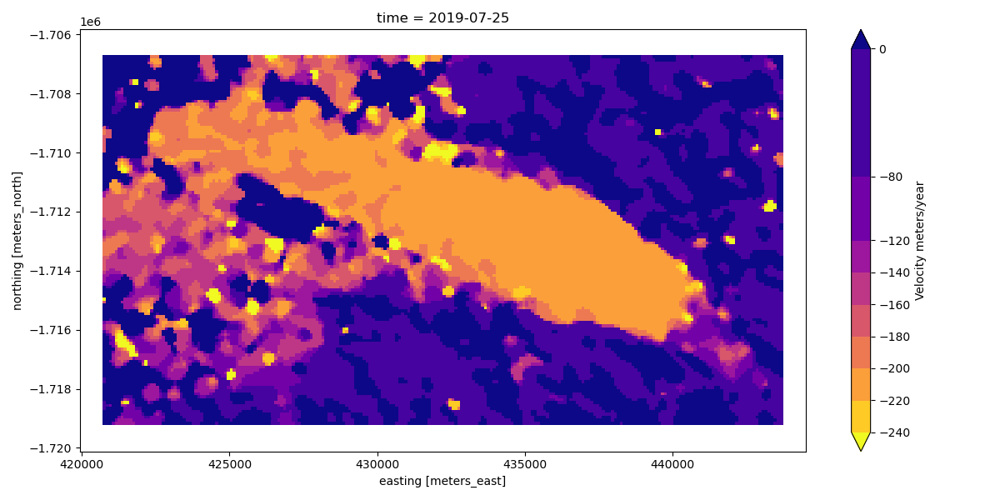

<IPython.core.display.Javascript object>


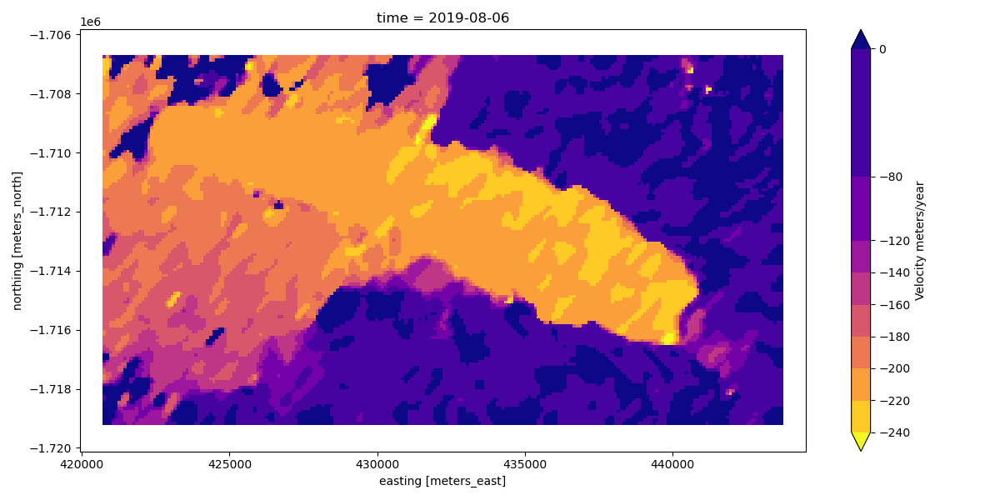

<IPython.core.display.Javascript object>


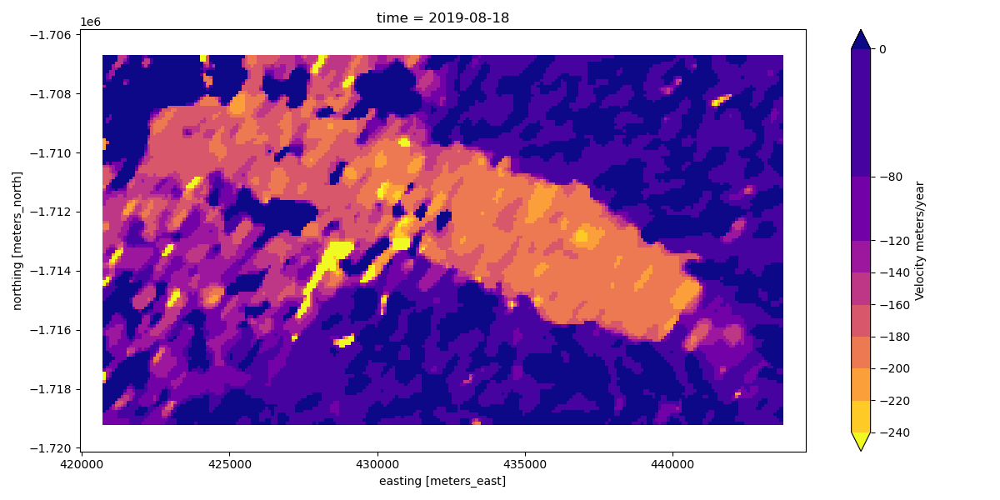

<IPython.core.display.Javascript object>


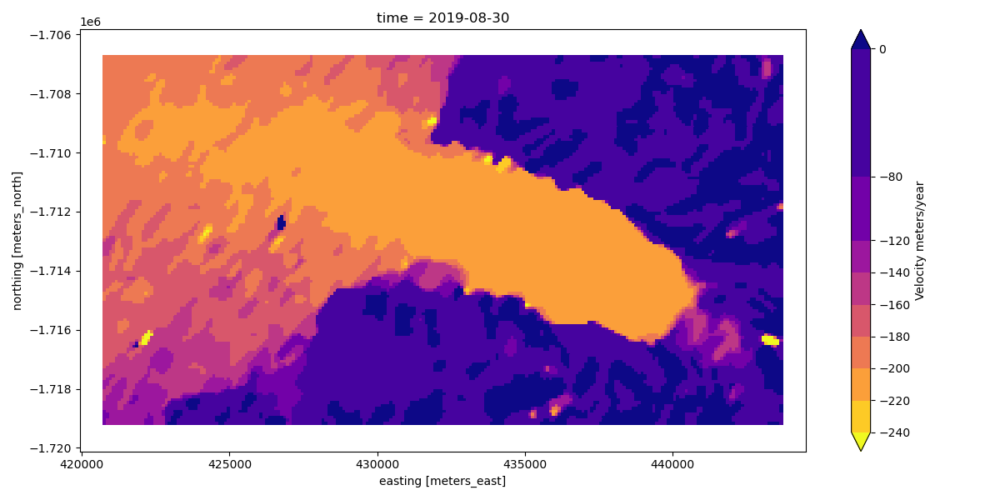

<IPython.core.display.Javascript object>


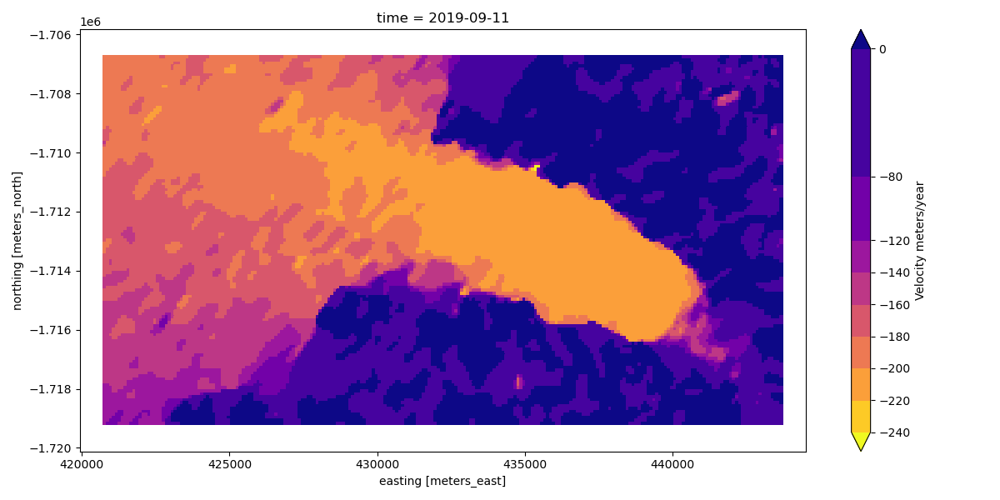

<IPython.core.display.Javascript object>


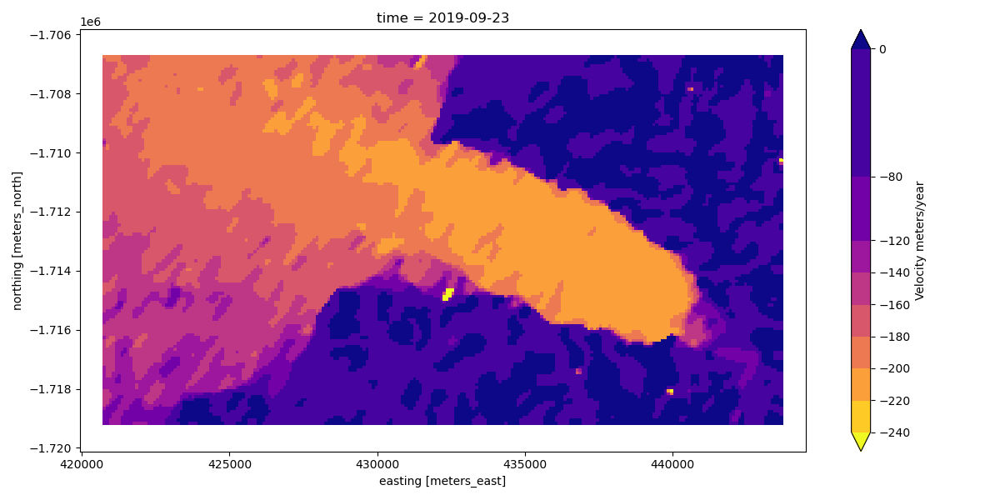

<IPython.core.display.Javascript object>


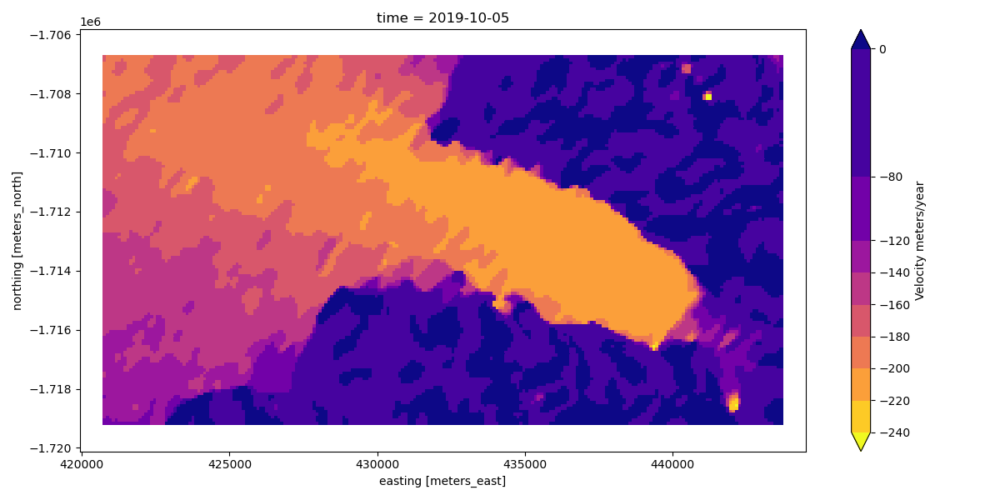

<IPython.core.display.Javascript object>


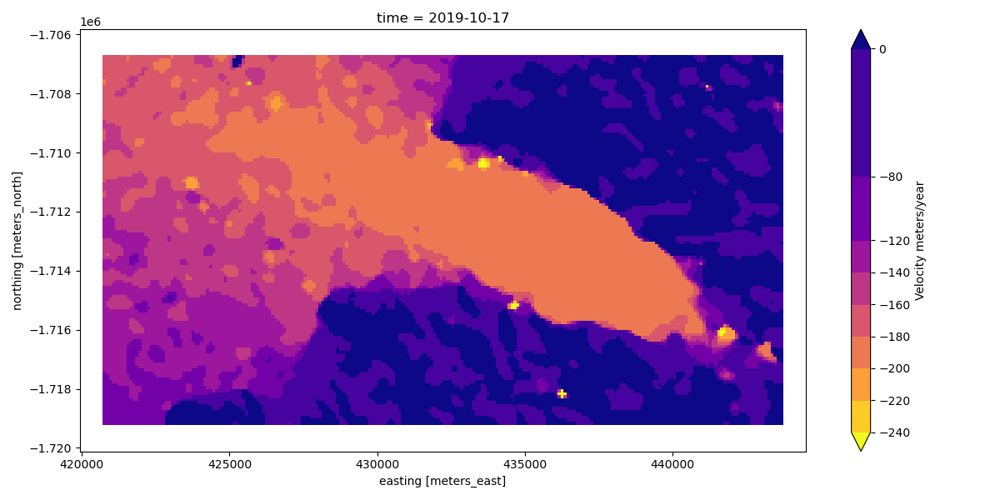

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


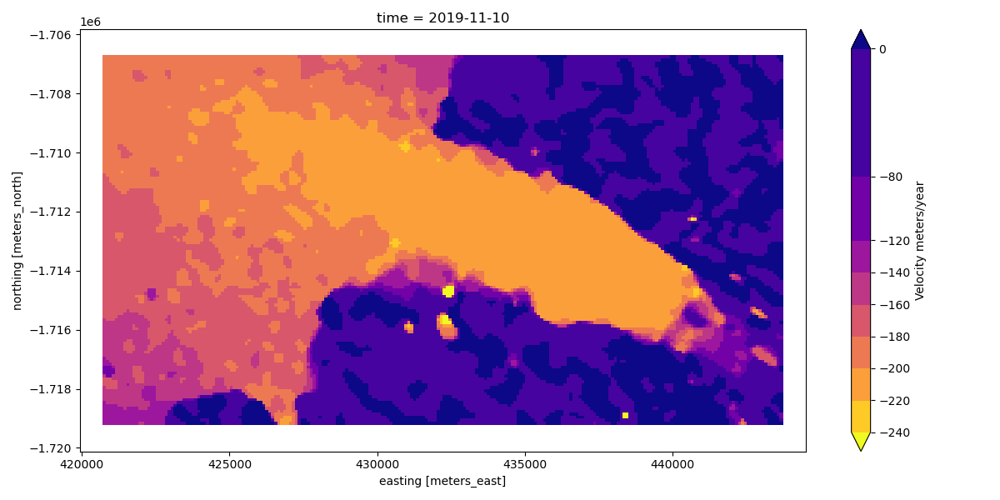

<IPython.core.display.Javascript object>


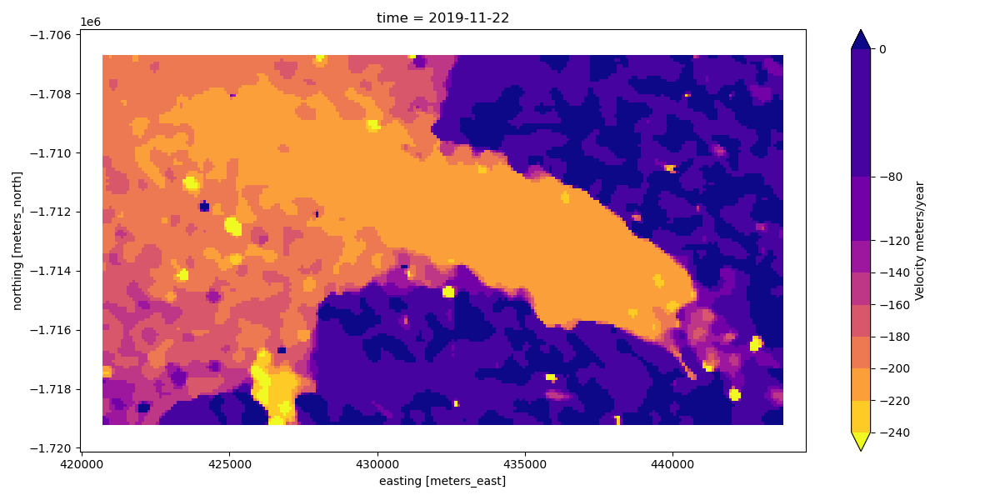

<IPython.core.display.Javascript object>


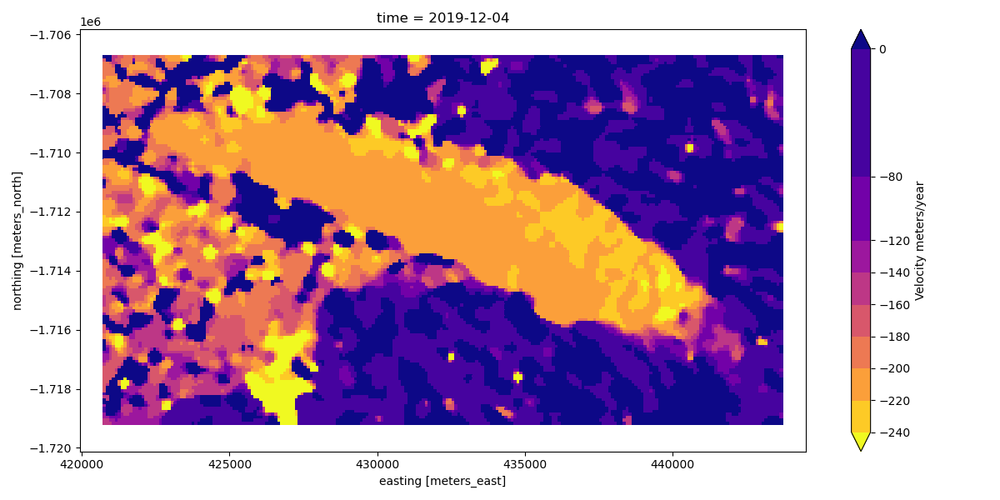

<IPython.core.display.Javascript object>


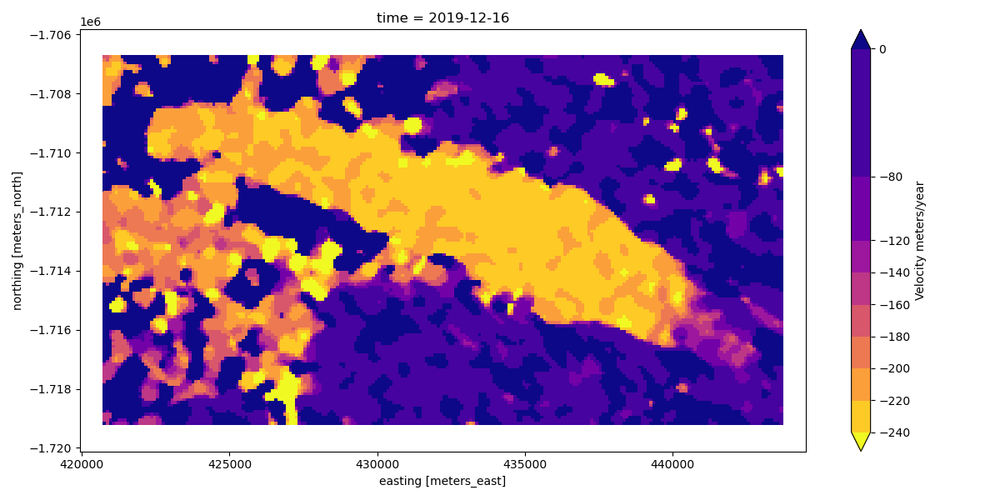

<IPython.core.display.Javascript object>


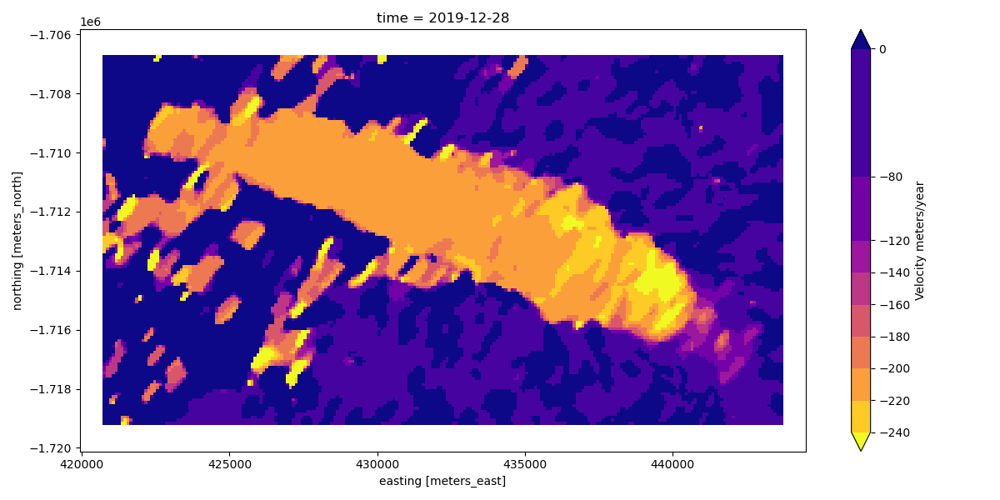

<IPython.core.display.Javascript object>


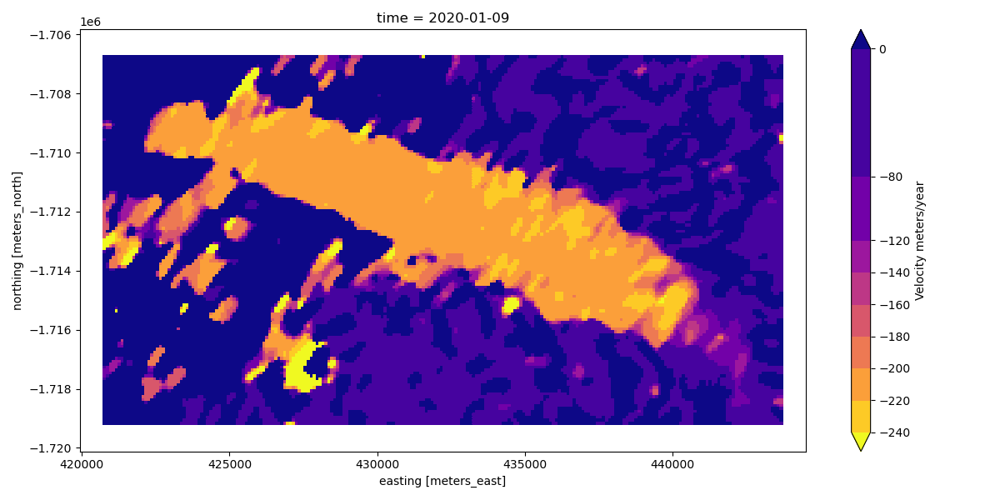

<IPython.core.display.Javascript object>


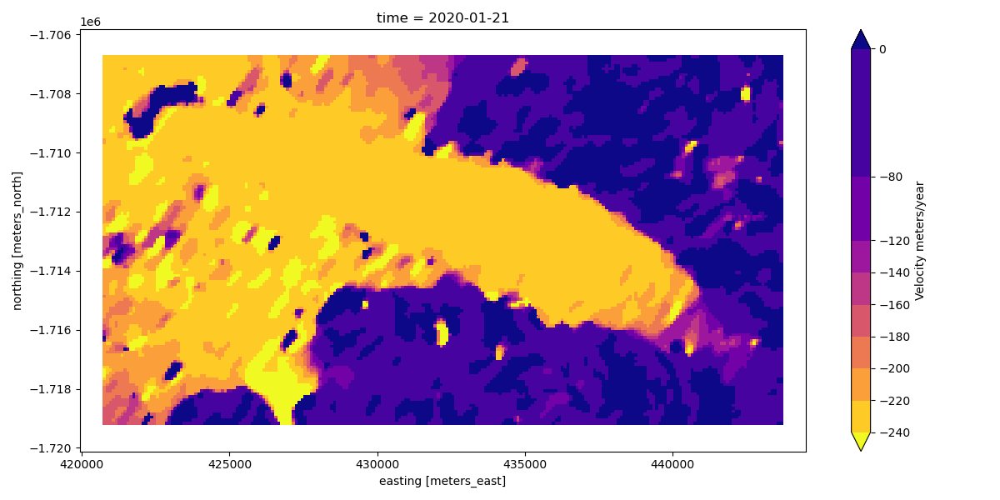

<IPython.core.display.Javascript object>


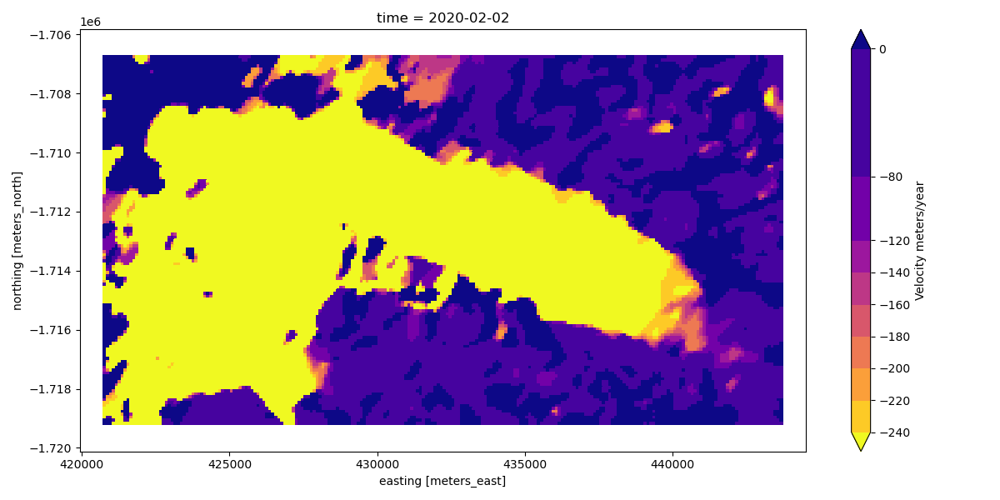

<IPython.core.display.Javascript object>


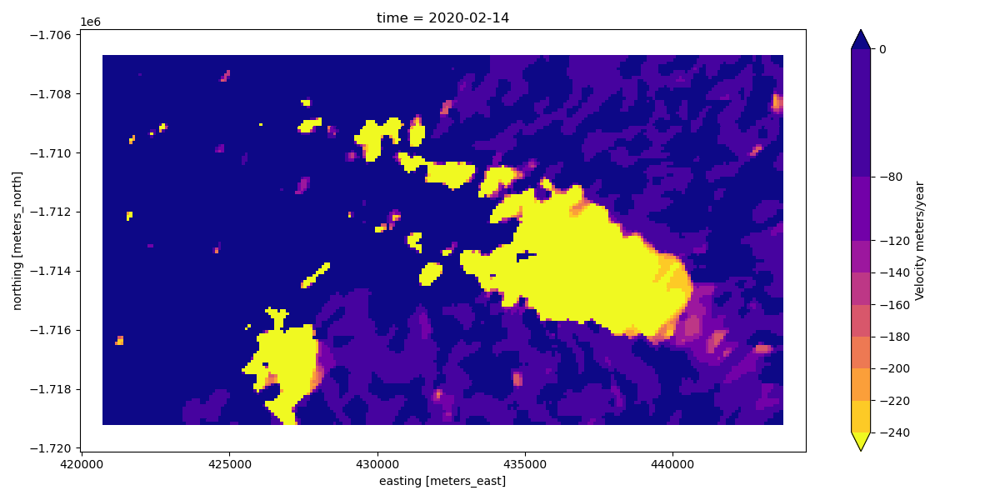

<IPython.core.display.Javascript object>


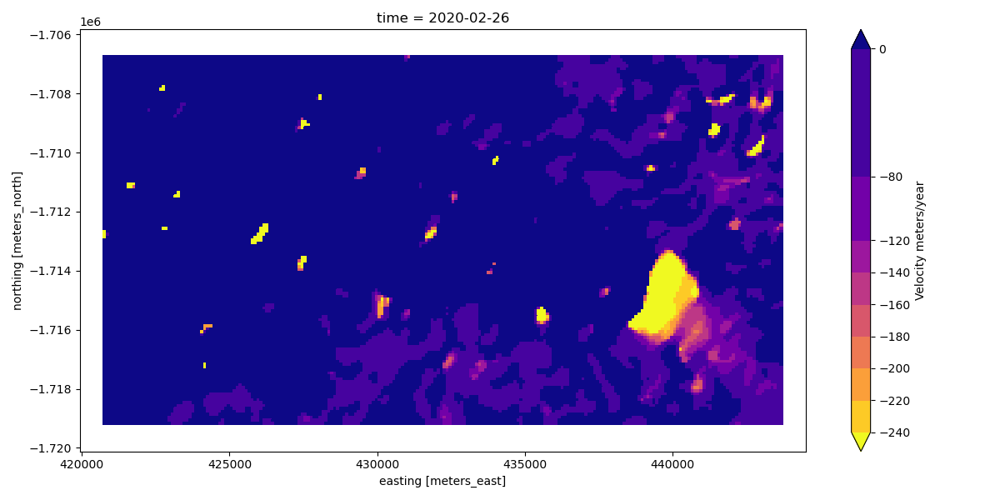

<IPython.core.display.Javascript object>


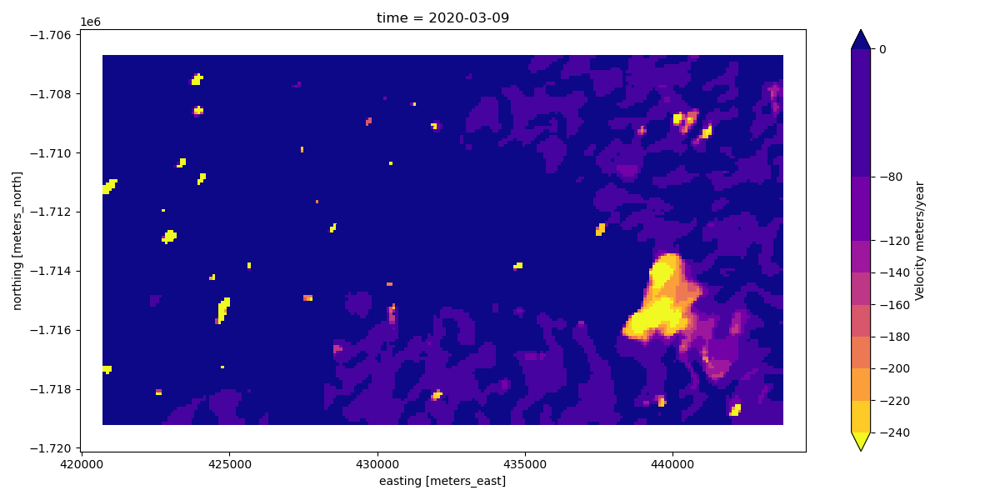

<IPython.core.display.Javascript object>


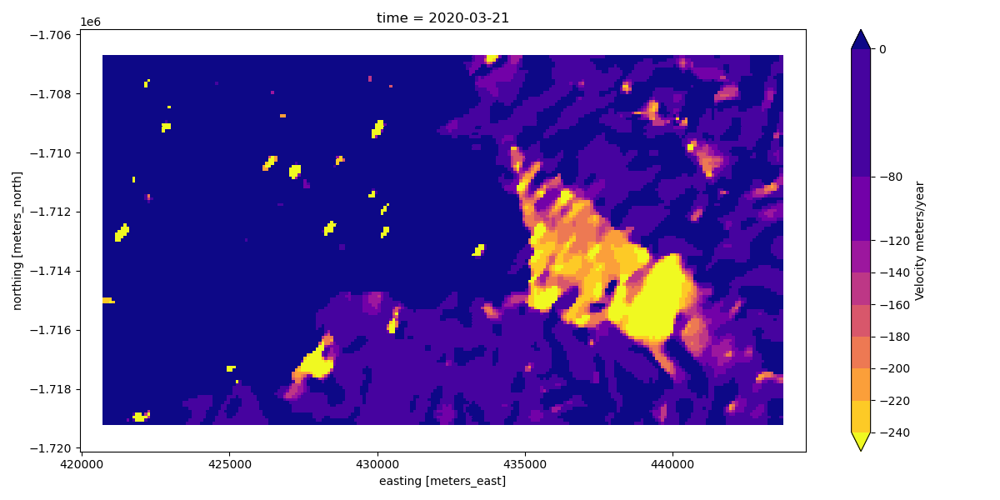

<IPython.core.display.Javascript object>


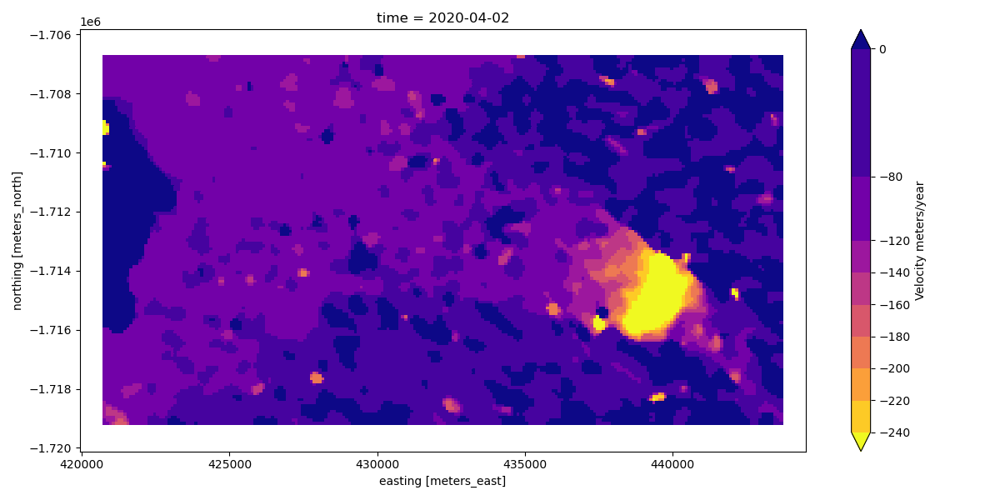

<IPython.core.display.Javascript object>


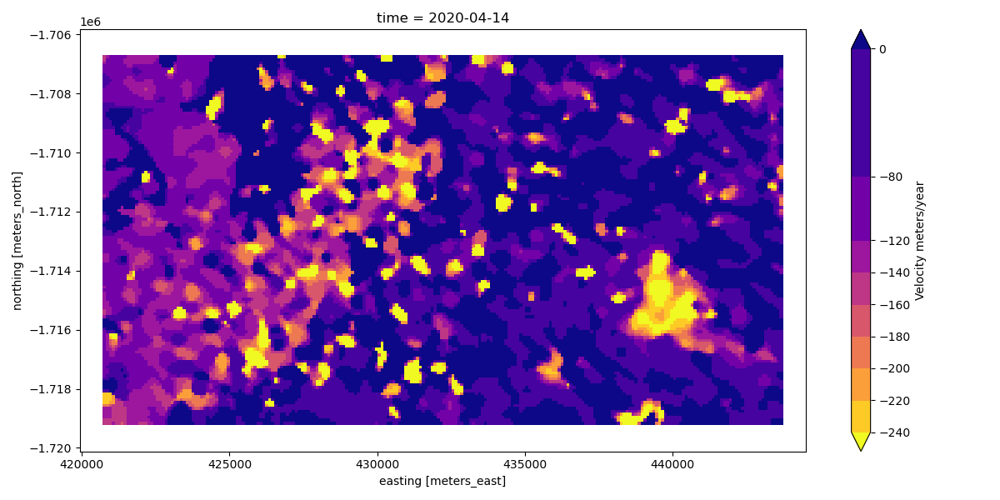

<IPython.core.display.Javascript object>


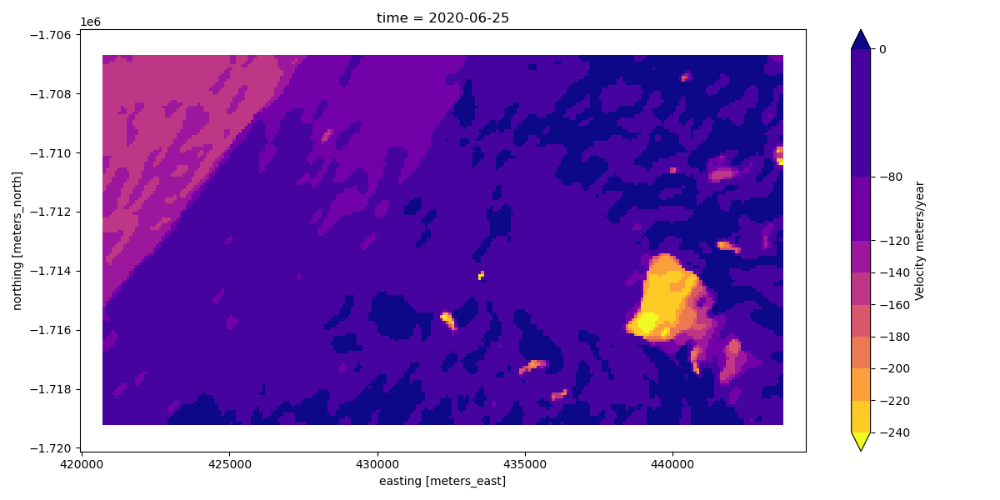

<IPython.core.display.Javascript object>


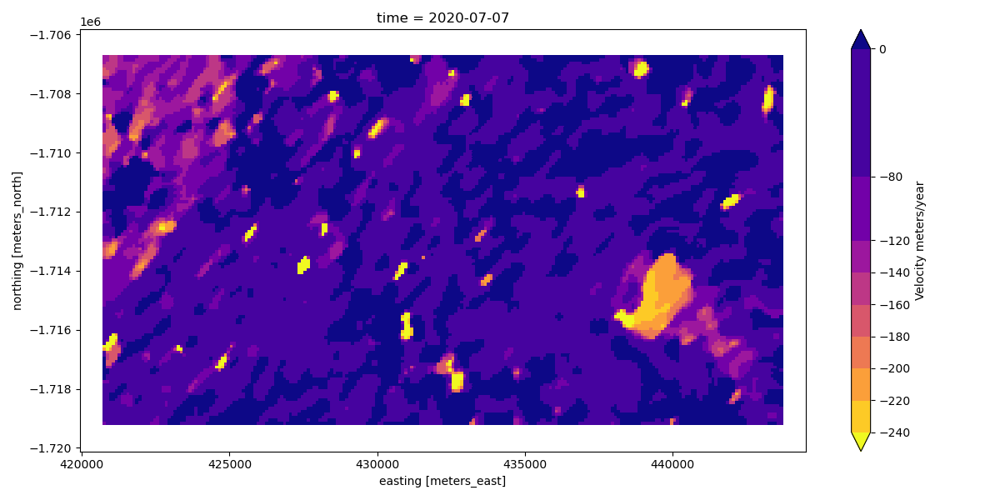

<IPython.core.display.Javascript object>


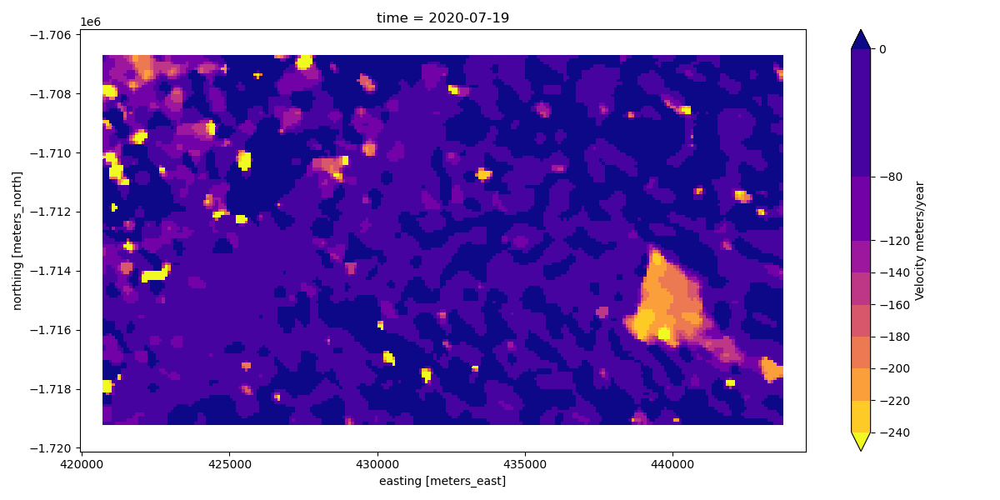

In [21]:
for i, img in enumerate(ds.time):
    date = np.datetime_as_string(img.values)[0:10]

    cmap = mpl.cm.plasma_r
    levels = [0,-80,-120,-140,-160,-180,-200,-220,-240]

    fig= plt.figure(figsize=(12,6))

    ax = plt.gca()
    ds.gr.isel(time=i).plot(levels=levels, 
                            cmap = cmap,
                            cbar_kwargs={'ticks': levels,
                                           'spacing': 'proportional',
                                             'label':'Velocity meters/year'})

    plt.axis('equal')
    plt.tight_layout()

    
    #plt.savefig(f'/media/rag110/RGFell_UC1/RGF/RGF_phd/Results/Borchgrevink_north/Parker_IT/gr/{date}_gr_Parker_IT.png')

In [11]:
ds.attrs['nodata'] = np.nan


In [12]:
from rasterio.features import geometry_mask
import geopandas as gpd
mfn = '/mnt/data1/masks/Parker_IT_mask.tif'

<IPython.core.display.Javascript object>


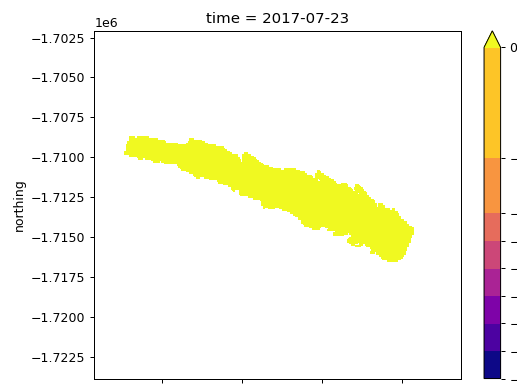

In [13]:

vfn = '/home/UOCNT/rag110/Dropbox/UC_files/VLC_images/polygons/Parker_IT_2018.geojson'
mfn = '/mnt/data1/masks/Parker_IT_mask.tif'

img = rasterio.open(mfn)
raster = img.read(1)
raster_masked = np.ma.masked_where(raster==0, raster)
ds_masked = ds*raster
ds_masked = xr.where(ds_masked.gr == 0, np.nan, ds_masked)
ds_masked = xr.where(ds_masked.az == 0, np.nan, ds_masked)
ds_masked = xr.where(ds_masked.vel == 0, np.nan, ds_masked)
ds_masked = xr.where(ds_masked.vel > 300, np.nan, ds_masked)


cmap = mpl.cm.plasma
levels = [0,-80,-120,-140,-160,-180,-200,-220,-240]

fig= plt.figure()

ax = plt.gca()
ds_masked.vel.isel(time=14).plot(levels=levels,
                         cmap = cmap,
                         cbar_kwargs={'ticks': levels,
                                     'spacing': 'proportional',
                                     'label':'Velocity meters/year'})

plt.axis('equal')
plt.tight_layout()

plt.show()

In [12]:
ds.gr.rolling(time=4).mean().plot()

(array([1.170000e+02, 1.615000e+03, 6.434000e+03, 1.053910e+06,
        1.716247e+06, 3.813900e+04, 8.820000e+02, 5.400000e+01,
        1.900000e+01, 8.300000e+01]),
 array([-809.64367676, -639.1954895 , -468.74730225, -298.29911499,
        -127.85092773,   42.59725952,  213.04544678,  383.49363403,
         553.94182129,  724.39000854,  894.8381958 ]),
 <BarContainer object of 10 artists>)

In [13]:
ds.sel(easting=435000, northing=-1714000, method='nearest').az.rolling(time=3).mean().plot()

In [ ]:
ds.close()

<IPython.core.display.Javascript object>


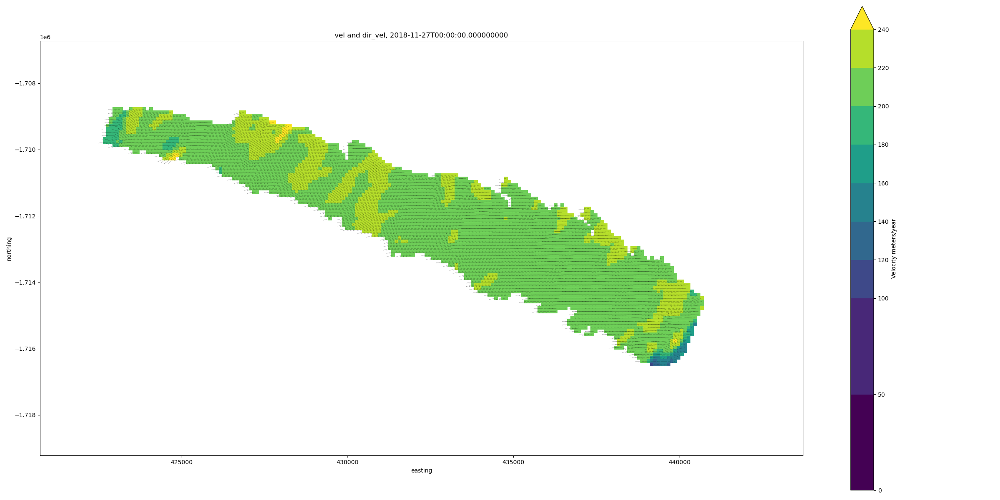

In [25]:
fig= plt.figure(figsize=(24,12))

cmap = mpl.cm.viridis
levels = [0,50,100,120,140,160,180,200,220,240]

ax = plt.gca()

ax = plt.gca()
ds_masked.vel.isel(time=55).plot(levels=levels, 
                                cbar_kwargs={'ticks': levels,
                                             'spacing': 'proportional',
                                             'label':'Velocity meters/year'})

plt.axis('scaled')
plt.tight_layout()

plt.title(f'vel and dir_vel, {ds_masked.time[55].values}')
plt.ylabel('northing')
plt.xlabel('easting')
x = ds.vel.coords['easting'].values
y = ds.vel.coords['northing'].values
plt.quiver(x, y, ds_masked.gr.values[55], ds_masked.az.values[55],  
           angles='xy', scale_units='xy', scale=1, headwidth=5,
          headlength=10, minshaft=8)

<IPython.core.display.Javascript object>


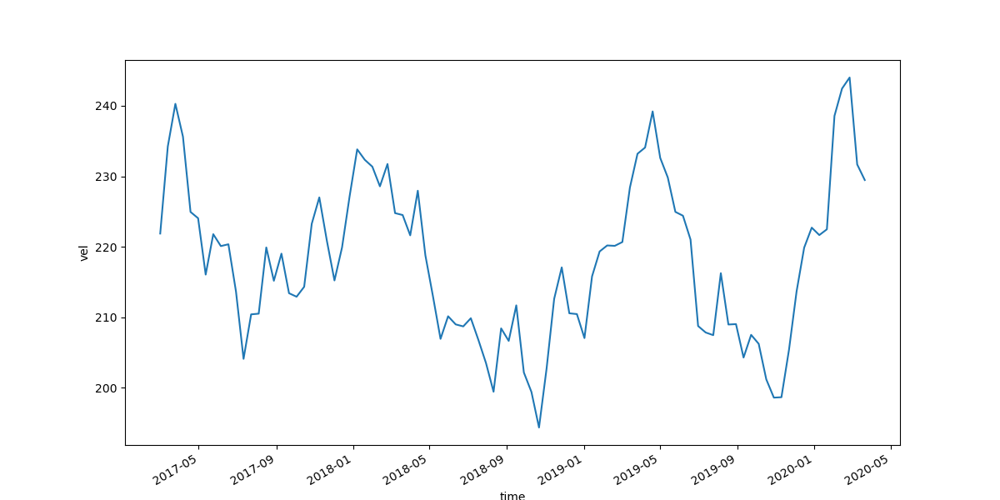

In [26]:
plt.figure(figsize=(12, 6))

(ds_masked.vel.sel(time=slice('2017-01', '2020-03')).mean(dim=['northing', 'easting'])).rolling(time=3).mean().plot()

plt.show()

<IPython.core.display.Javascript object>


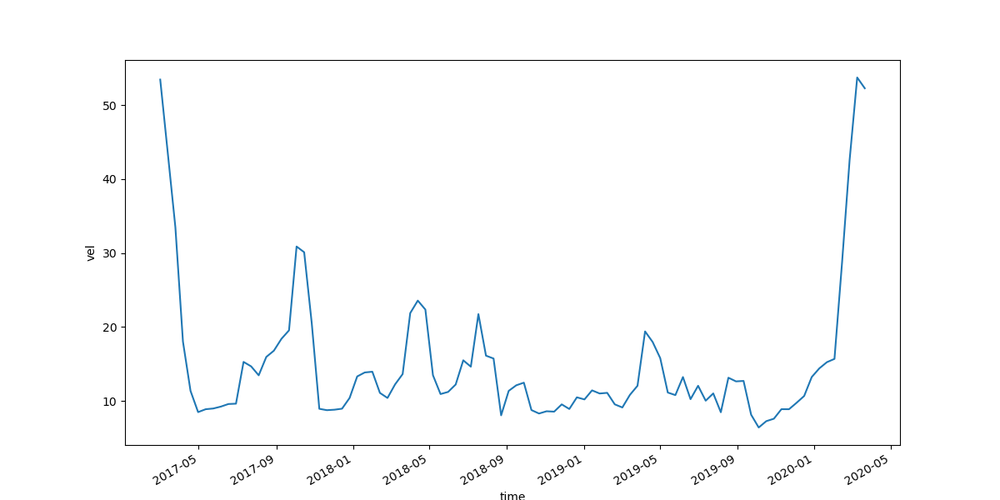

In [29]:
plt.figure(figsize=(12, 6))

(ds_masked.vel.sel(time=slice('2017-01', '2020-03')).std(dim=['northing', 'easting'])).rolling(time=3).mean().plot()
plt.show()

In [28]:

(ds_masked.groupby(ds.time.dt.month)
   .mean(dim=['time', 'easting', 'northing'])
   .vel
   .plot())

In [ ]:
ds_masked

In [ ]:
ds_masked.isel(time=4).plot.quiver(x='easting', y='northing', u='gr', v='az')

In [ ]:
ds_masked.isel(time=90).plot.streamplot(x='easting', y='northing', u='gr', v='az')

<IPython.core.display.Javascript object>


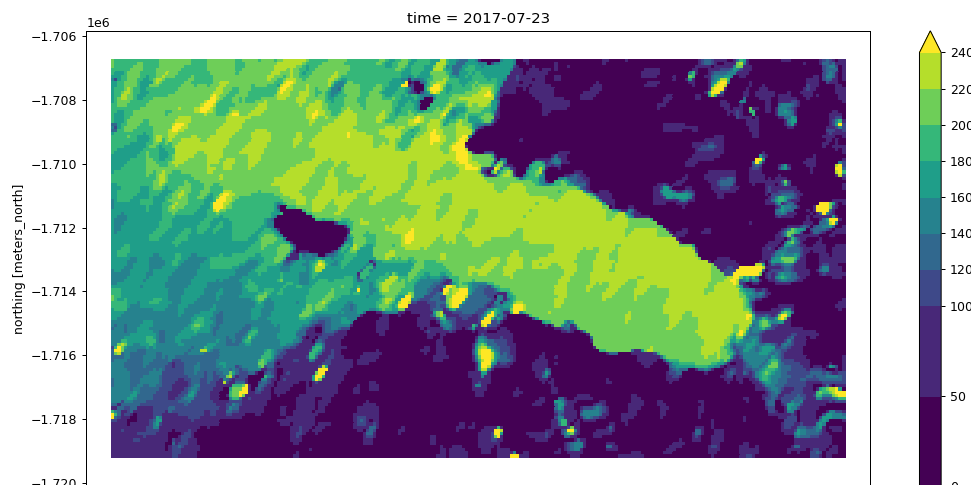

In [14]:


levels = [0,50,100,120,140,160,180,200,220,240]


fig= plt.figure(figsize=(12,6))

ax = plt.gca()
ds.vel.isel(time=14).plot(levels=levels, cbar_kwargs={'ticks': levels,
                                               'spacing': 'proportional',
                                                     'label':'Velocity meters/year'})

plt.axis('equal')
plt.tight_layout()

In [15]:

import pandas as pd
file_path = r'/media/rag110/RGFell_UC1/RGF/RGF_phd/sea_ice_area/ParkerIT/crop/fast_ice_area_of_Parker.csv'
df = pd.read_csv(file_path, index_col='date_1' )
df.index = pd.to_datetime(df.index)

In [16]:
print((df.loc[df.index == '2018-05-31'].Area.values+df.loc[df.index == '2018-07-06'].Area.values)/2)
print((df.loc[df.index == '2018-07-30'].Area.values+df.loc[df.index == '2018-07-06'].Area.values)/2)

[1076.7159375]
[1082.01875]


In [17]:
# The fast ice area for these dates are understimated, they are corrected using the mean of the previious and after values
df.loc['2018-06-12', 'Area'] = (df.loc[df.index == '2018-05-31'].Area.values+df.loc[df.index == '2018-07-06'].Area.values)/2
df.loc['2018-06-24', 'Area'] = (df.loc[df.index == '2018-05-31'].Area.values+df.loc[df.index == '2018-07-06'].Area.values)/2
df.loc['2018-07-18', 'Area'] = (df.loc[df.index == '2018-07-30'].Area.values+df.loc[df.index == '2018-07-06'].Area.values)/2

<IPython.core.display.Javascript object>


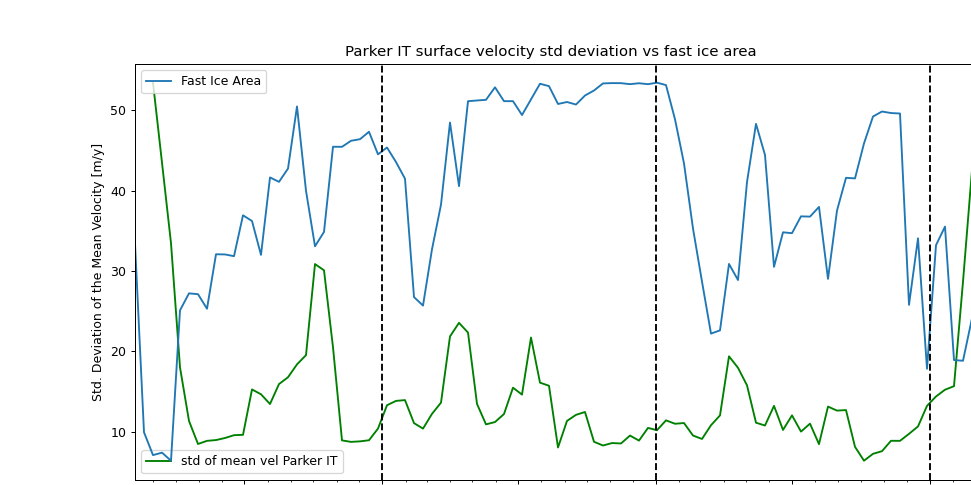

In [18]:
plt.figure(figsize=(12, 6))

ax = plt.gca()
#ax.plot(df_vel.index, df_vel.velocity_EIT)
(ds_masked.vel.sel(time=slice('2017-01', '2020-02')).std(dim=['northing', 'easting'])).rolling(time=3).mean().plot(ax=ax, color='green',  label='std of mean vel Parker IT')

ax.legend(loc=3)

ax2 = ax.twinx()
df["2017-01":'2020-02'].Area.plot(ax=ax2,  label='Fast Ice Area')
ax2.legend(loc=0)

axvposition = ['2018-01-01', '2019-01-01', '2020-01-01']
for xc in axvposition:
    plt.axvline(x=xc, color='k', linestyle='--')
plt.setp( ax.xaxis.get_majorticklabels(), rotation=30, ha="right", rotation_mode="anchor") 
ax.set_xticks(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])
ax.set_xticklabels(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])

ax.set_xlabel('Date')
ax.set_ylabel(r'Std. Deviation of the Mean Velocity [m/y]')
ax2.set_ylabel(r'Fast ice area [km2]')

plt.title('Parker IT surface velocity std deviation vs fast ice area ')
#plt.savefig('vel_std_and_fi_area_2.png')
plt.show()


<IPython.core.display.Javascript object>


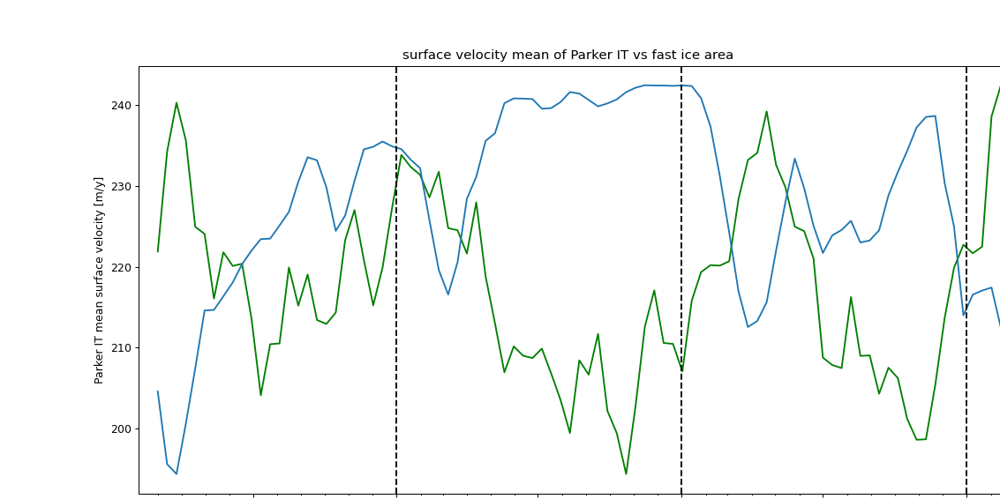

In [19]:
plt.figure(figsize=(14, 7))

ax = plt.gca()

(ds_masked.vel.sel(time=slice('2017-01', '2020-02-15')).mean(dim=['northing', 'easting'])).rolling(time=3).mean().plot(ax=ax, color='green',label='Mean of ParkerIT Vel')

ax2 = ax.twinx()
df["2017-01":'2020-02-15'].Area.rolling(3).mean().plot(ax=ax2, label='Fast Ice Area')
ax.set_xlabel(' ')
ax.set_ylabel('Parker IT mean surface velocity [m/y]')
#ax.legend(loc=3)

ax2.set_ylabel('Fast ice area [km2]')
plt.title('surface velocity mean of Parker IT vs fast ice area ')

#ax2.legend(loc=0)

axvposition = ['2018-01-01', '2019-01-01', '2020-01-01']
for xc in axvposition:
    plt.axvline(x=xc, color='k', linestyle='--')
plt.setp( ax.xaxis.get_majorticklabels(), rotation=30, ha="right", rotation_mode="anchor") 
ax.set_xticks(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])
ax.set_xticklabels(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])



plt.savefig('vel_mean_and_fi_area_2_d300.png', dpi=300)

plt.show()

<IPython.core.display.Javascript object>


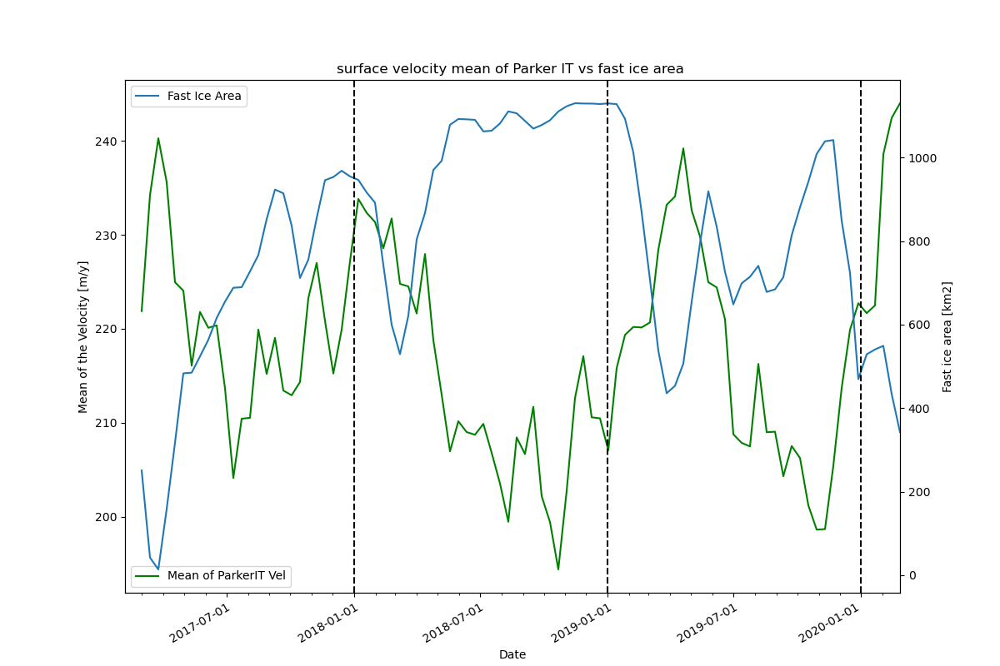

In [35]:
plt.figure(figsize=(12, 8))

ax = plt.gca()

(ds_masked.vel.sel(time=slice('2017-01', '2020-02')).mean(dim=['northing', 'easting'])).rolling(time=3).mean().plot(ax=ax, color='green',label='Mean of ParkerIT Vel')

ax2 = ax.twinx()
df["2017-01":'2020-02'].Area.rolling(3).mean().plot(ax=ax2, label='Fast Ice Area')
ax.set_xlabel('Date')
ax.set_ylabel('Mean of the Velocity [m/y]')
ax.legend(loc=3)

ax2.set_ylabel('Fast ice area [km2]')
plt.title('surface velocity mean of Parker IT vs fast ice area ')

ax2.legend(loc=0)

axvposition = ['2018-01-01', '2019-01-01', '2020-01-01']
for xc in axvposition:
    plt.axvline(x=xc, color='k', linestyle='--')
plt.setp( ax.xaxis.get_majorticklabels(), rotation=30, ha="right", rotation_mode="anchor") 
ax.set_xticks(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])
ax.set_xticklabels(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])

#plt.savefig('vel_mean_and_fi_area_2_rollmean3.png')

plt.show()

In [23]:
vel_mean = ds_masked.vel.sel(time=slice('2017-01', '2020-02-14')).mean(dim=['northing', 'easting'], skipna=True).rolling(time=3).mean().values

vel_std = ds_masked.vel.sel(time=slice('2017-01', '2020-02-14')).std(dim=['northing', 'easting'], skipna=True).rolling(time=3).mean().values
area_fi = df["2017-01":'2020-02-14'].Area.values

df_plot = pd.DataFrame(data = [vel_mean, vel_std, area_fi]).T
df_plot = df_plot.rename(columns={0:'vel_mean', 1:'vel_std', 2:'area_fi'})

<IPython.core.display.Javascript object>


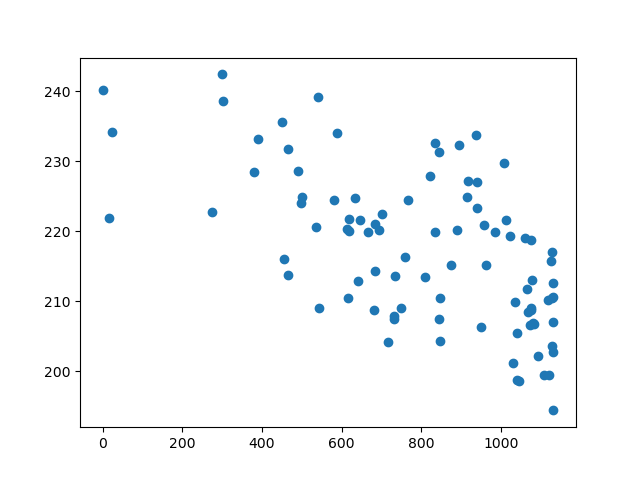

<function matplotlib.pyplot.show(block=None)>

In [24]:
plt.figure()
plt.scatter(area_fi, vel_mean)
plt.show

<IPython.core.display.Javascript object>


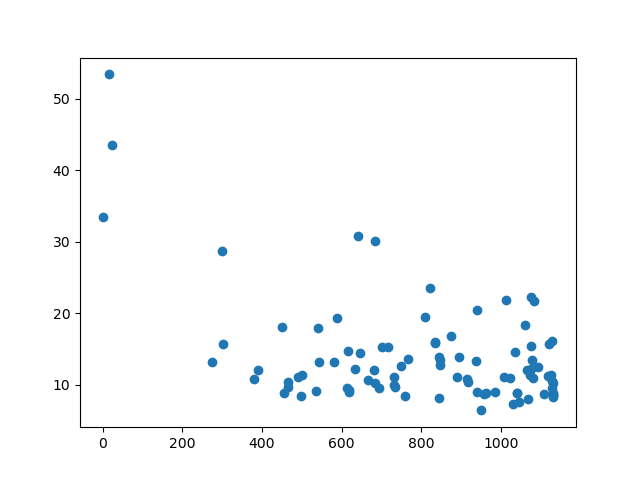

<function matplotlib.pyplot.show(block=None)>

In [25]:
plt.figure()
plt.scatter(area_fi, vel_std)
plt.show

In [70]:
df_plot

,vel_mean,vel_std,area_fi
0,NaN,NaN,650.322500
1,NaN,NaN,85.068125
2,221.883179,53.443614,16.773125
3,234.231730,43.490580,24.135000
4,240.278809,33.478739,0.018125
...,...,...,...
88,222.721924,13.231208,275.315625
89,221.669108,14.400703,645.343750
90,222.486369,15.238302,700.991250
91,238.566406,15.682205,301.441250


<IPython.core.display.Javascript object>


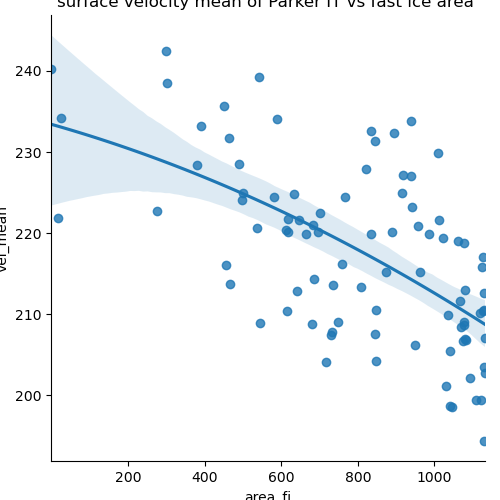

In [26]:
import seaborn as sns

fig_mean = sns.lmplot(x = 'area_fi', y = 'vel_mean', order=2, data=df_plot)

plt.title('surface velocity mean of Parker IT vs fast ice area ')


fig_mean.savefig('vel_mean_fi_area.png')

<IPython.core.display.Javascript object>


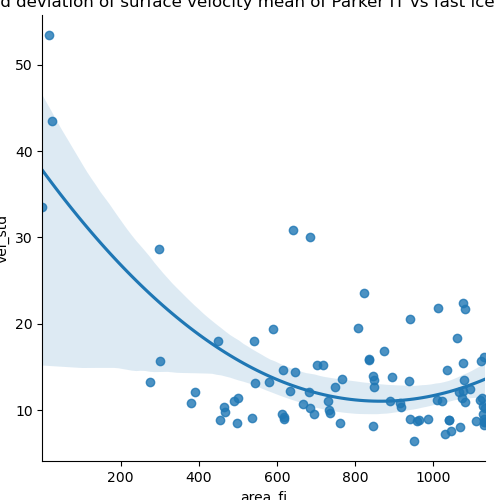

In [27]:
fig_std=sns.lmplot(x = 'area_fi', y = 'vel_std', order=2, data=df_plot)
plt.title('std deviation of surface velocity mean of Parker IT vs fast ice area ')

fig_std.savefig('vel_std_fi_area.png')

<IPython.core.display.Javascript object>


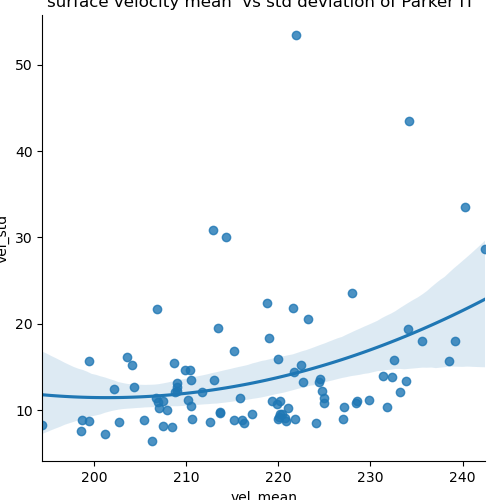

In [28]:
fig_std_mean=sns.lmplot(x = 'vel_mean', y = 'vel_std',order=2, data=df_plot)

plt.title('surface velocity mean  vs std deviation of Parker IT ')

fig_std_mean.savefig('vel_std_mean.png')

In [29]:
monthly_means = ds_masked.groupby("time.month").mean()
# xarray's groupby reductions drop attributes. Let's assign them back so we get nice labels.
monthly_means.vel.attrs = ds.vel.attrs
monthly_means


<xarray.Dataset>
Dimensions:   (easting: 230, month: 12, northing: 125)
Coordinates:
  * northing  (northing) float32 -1.707e+06 -1.707e+06 ... -1.719e+06 -1.719e+06
  * easting   (easting) float32 4.208e+05 4.209e+05 ... 4.436e+05 4.437e+05
  * month     (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
Data variables:
    gr        (month, northing, easting) float32 nan nan nan nan ... nan nan nan
    az        (month, northing, easting) float32 nan nan nan nan ... nan nan nan
    vel       (month, northing, easting) float32 nan nan nan nan ... nan nan nan

In [30]:
(ds_masked.sel(time=slice('2017-01', '2020-02-15')))


<xarray.Dataset>
Dimensions:   (easting: 230, northing: 125, time: 93)
Coordinates:
  * time      (time) datetime64[ns] 2017-02-05 2017-02-17 ... 2020-02-14
  * northing  (northing) float32 -1.707e+06 -1.707e+06 ... -1.719e+06 -1.719e+06
  * easting   (easting) float32 4.208e+05 4.209e+05 ... 4.436e+05 4.437e+05
Data variables:
    gr        (time, northing, easting) float32 nan nan nan nan ... nan nan nan
    az        (time, northing, easting) float32 nan nan nan nan ... nan nan nan
    vel       (time, northing, easting) float32 nan nan nan nan ... nan nan nan

<IPython.core.display.Javascript object>


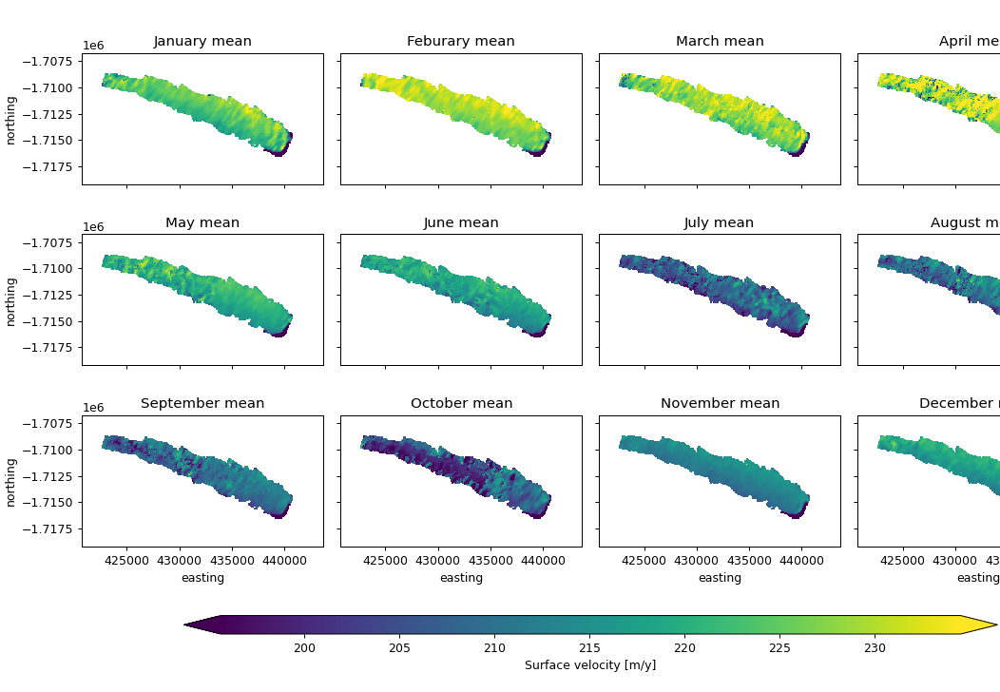

In [20]:
monthly_means = ds_masked.sel(time=slice('2017-01', '2020-02-15')).rolling(time=3).mean().groupby("time.month").mean()
# xarray's groupby reductions drop attributes. Let's assign them back so we get nice labels.
monthly_means.vel.attrs = ds_masked.vel.attrs
monthly_means

months = ['January', 'Feburary', 'March', 'April', 'May', 'June',
         'July', 'August', 'September', 'October', 'November', 'December' ]

fg = monthly_means.vel.plot(
    col="month",
    col_wrap=4,  # each row has a maximum of 4 columns\
    robust =True,
    cbar_kwargs={
        "orientation": "horizontal",
        "shrink": 0.8,
        "aspect": 40,
        "pad": 0.1,
        "label":"Surface velocity [m/y]"
    },
    
)

for i, ax in enumerate(fg.axes.flat):
        ax.set_title(f"{months[i]} mean" )


[axis.set_aspect('equal') for axis in fg.axes.ravel()]

plt.savefig('monthly_mean_Parker_IT_rollmean3_d300.png', dpi=300)


In [ ]:
monthly_means.plot.quiver(x='easting', y='northing', u='az', v='gr')

In [102]:
for i in range(12):
    print(monthly_means.vel[i].mean())
    

<xarray.DataArray 'vel' ()>
array(222.96988703)
Coordinates:
    month    int64 1
<xarray.DataArray 'vel' ()>
array(227.8947294)
Coordinates:
    month    int64 2
<xarray.DataArray 'vel' ()>
array(227.08148221)
Coordinates:
    month    int64 3
<xarray.DataArray 'vel' ()>
array(228.51758015)
Coordinates:
    month    int64 4
<xarray.DataArray 'vel' ()>
array(219.20981763)
Coordinates:
    month    int64 5
<xarray.DataArray 'vel' ()>
array(216.9865548)
Coordinates:
    month    int64 6
<xarray.DataArray 'vel' ()>
array(207.1588476)
Coordinates:
    month    int64 7
<xarray.DataArray 'vel' ()>
array(210.5994247)
Coordinates:
    month    int64 8
<xarray.DataArray 'vel' ()>
array(208.87182158)
Coordinates:
    month    int64 9
<xarray.DataArray 'vel' ()>
array(204.32926271)
Coordinates:
    month    int64 10
<xarray.DataArray 'vel' ()>
array(212.06039627)
Coordinates:
    month    int64 11
<xarray.DataArray 'vel' ()>
array(217.44267977)
Coordinates:
    month    int64 12


In [104]:
204/227

0.8986784140969163

In [33]:
#MEAN VELOCITY FOR THE WHOLE PERIOD
print('mean velocity for Parker:', str(monthly_means.vel.mean().values))
print('standard deviationof the mean velocity for Parker:', str(monthly_means.vel.std().values))

mean velocity for Parker: 216.92687365343326
standard deviationof the mean velocity for Parker: 11.103999127539081


In [34]:
str(monthly_means.vel.mean().values)

'216.92687365343326'

In [35]:
monthly_examples =  ds_masked.sel(time=[])

In [36]:
date = [dt.datetime(year, month, day)]
time[i] = date2num(date, time.units)

january =  xr.DataArray(['2018-01', '2019-01', '2020-01'], dims="time")

NameError: name 'dt' is not defined

In [37]:
month =  ds_masked.sel(time='2019-01')

In [38]:
january

NameError: name 'january' is not defined

<IPython.core.display.Javascript object>


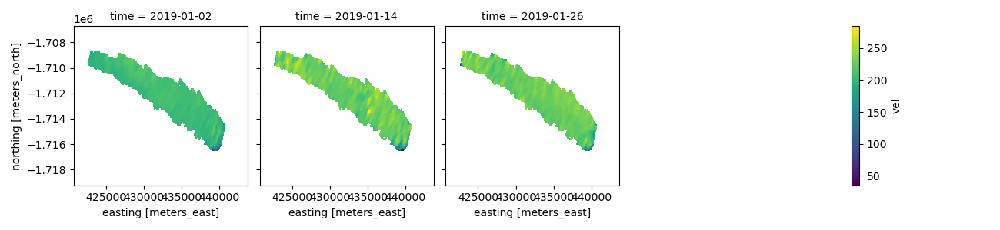

In [39]:
fg2 = month.vel.plot(
    col="time",
    col_wrap=4,  # each row has a maximum of 4 columns
)

In [40]:
ds_masked.vel.mean()

<xarray.DataArray 'vel' ()>
array(212.2709, dtype=float32)

In [41]:
vel_means = (ds_masked.vel.sel(time=slice('2017-01', '2020-02')).mean(dim=['northing', 'easting'])).rolling(time=3).mean().values


In [42]:
print(np.nanmin(vel_means), np.nanmax(vel_means), np.nanstd(vel_means))


194.38346354166666 244.0106404622396 11.105296095504265


In [43]:
file_path = r'/media/rag110/RGFell_UC1/RGF/RGF_phd/Results/Borchgrevink_north/Parker_IT/Parker_db_TS_IT.csv'
df_db = pd.read_csv(file_path, index_col='date' )
df_db.index = pd.to_datetime(df_db.index)

<IPython.core.display.Javascript object>


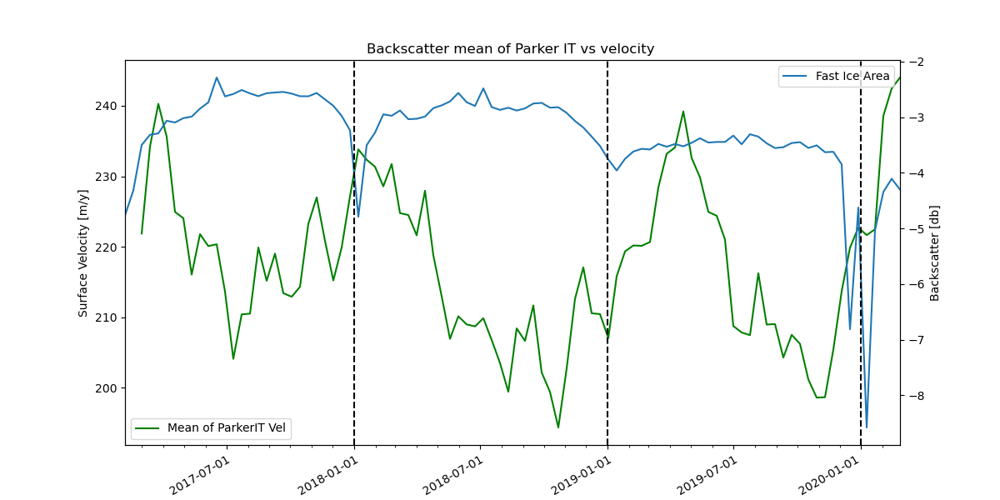

In [44]:
plt.figure(figsize=(12, 6))

ax = plt.gca()

(ds_masked.vel.sel(time=slice('2017-01', '2020-02')).mean(dim=['northing', 'easting'])).rolling(time=3).mean().plot(ax=ax, color='green',label='Mean of ParkerIT Vel')

ax2 = ax.twinx()
df_db["2017-01":'2020-02'].Mean_db.plot(ax=ax2, label='Fast Ice Area')
ax.set_xlabel('Date')
ax.set_ylabel('Surface Velocity [m/y]')
ax.legend(loc=3)

ax2.set_ylabel('Backscatter [db]')
plt.title('Backscatter mean of Parker IT vs velocity ')

ax2.legend(loc=1)

axvposition = ['2018-01-01', '2019-01-01', '2020-01-01']
for xc in axvposition:
    plt.axvline(x=xc, color='k', linestyle='--')
plt.setp( ax.xaxis.get_majorticklabels(), rotation=30, ha="right", rotation_mode="anchor") 
ax.set_xticks(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])
ax.set_xticklabels(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])

#plt.savefig('db_mean_and_vel.png')

plt.show()

In [45]:
file_path = r'/media/rag110/RGFell_UC1/RGF/RGF_phd/Results/Borchgrevink_north/Parker_IT/Parker_db_TS_fast_ice.csv'
df_db_fi = pd.read_csv(file_path, index_col='date' )
df_db_fi.index = pd.to_datetime(df_db_fi.index)

<IPython.core.display.Javascript object>


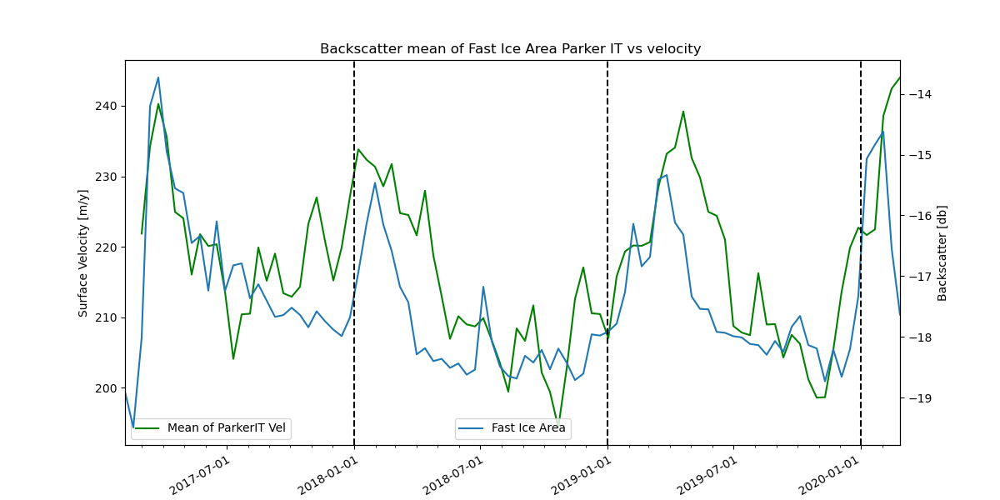

In [46]:
plt.figure(figsize=(12, 6))

ax = plt.gca()

(ds_masked.vel.sel(time=slice('2017-01', '2020-02')).mean(dim=['northing', 'easting'])).rolling(time=3).mean().plot(ax=ax, color='green',label='Mean of ParkerIT Vel')

ax2 = ax.twinx()
df_db_fi["2017-01":'2020-02'].Mean_db.plot(ax=ax2, label='Fast Ice Area')
ax.set_xlabel('Date')
ax.set_ylabel('Surface Velocity [m/y]')
ax.legend(loc=3)

ax2.set_ylabel('Backscatter [db]')
plt.title('Backscatter mean of Fast Ice Area Parker IT vs velocity ')

ax2.legend(loc=0)

axvposition = ['2018-01-01', '2019-01-01', '2020-01-01']
for xc in axvposition:
    plt.axvline(x=xc, color='k', linestyle='--')
plt.setp( ax.xaxis.get_majorticklabels(), rotation=30, ha="right", rotation_mode="anchor") 
ax.set_xticks(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])
ax.set_xticklabels(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])

#plt.savefig('db_mean_fi_and_vel.png')

plt.show()

<IPython.core.display.Javascript object>


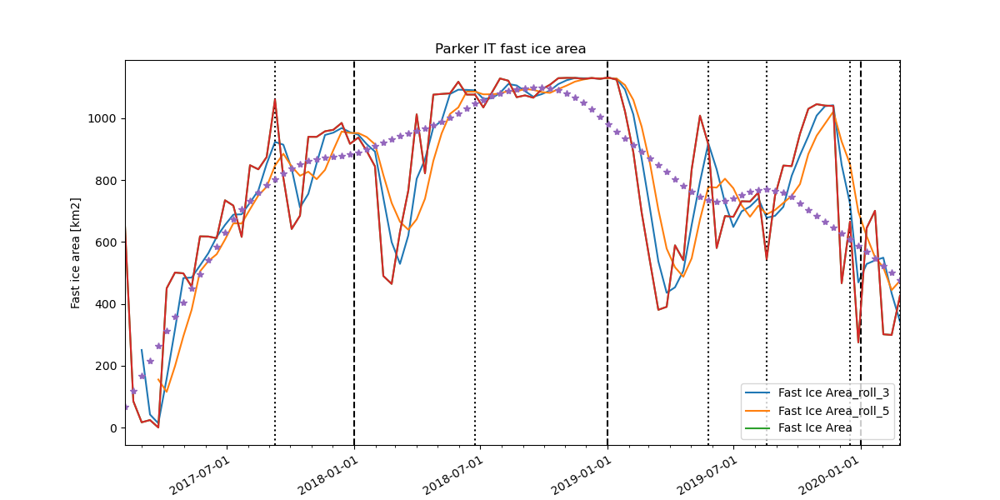

In [47]:
plt.figure(figsize=(12, 6))

ax = plt.gca()



df["2017-01":'2020-02'].Area.rolling(3).mean().plot(ax=ax,  label='Fast Ice Area_roll_3')
df["2017-01":'2020-02'].Area.rolling(5).mean().plot(ax=ax,  label='Fast Ice Area_roll_5')

df["2017-01":'2020-02'].Area.plot(ax=ax,  label='Fast Ice Area')

axvposition = ['2017-09-09', '2018-06-24','2019-05-26','2019-08-18','2019-12-16' ,'2020-02-26', '2020-03-09']
for xc in axvposition:
    plt.axvline(x=xc, color='k', linestyle='dotted')


axvposition = ['2018-01-01', '2019-01-01', '2020-01-01']
for xc in axvposition:
    plt.axvline(x=xc, color='k', linestyle='--')
plt.setp( ax.xaxis.get_majorticklabels(), rotation=30, ha="right", rotation_mode="anchor") 
ax.set_xticks(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])
ax.set_xticklabels(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])


ax.set_xlabel('Date')
ax.set_ylabel(r'Fast ice area [km2]')
plt.legend(loc='lower right')
plt.title('Parker IT fast ice area ')
#plt.savefig('Fast_area_with_rolling_mean.png')
plt.show()


In [49]:
df["2017-01":'2020-02']

,Area,date_2
date_1,,
2017-02-05,650.322500,2017-02-17
2017-02-17,85.068125,2017-03-01
2017-03-01,16.773125,2017-03-13
2017-03-13,24.135000,2017-03-25
2017-03-25,0.018125,2017-04-06
...,...,...
2020-01-09,645.343750,2020-01-21
2020-01-21,700.991250,2020-02-02
2020-02-02,301.441250,2020-02-14


In [48]:
#import matplotlib.pyplot as plt
#%matplotlib inline
from scipy.interpolate import interp1d
import statsmodels.api as sm

In [50]:
lowess = sm.nonparametric.lowess(df["2017-01":'2020-02'].Area, df["2017-01":'2020-02'].index, frac=.3)

In [51]:
lowess_x = list(zip(*lowess))[0]
lowess_y = list(zip(*lowess))[1]

In [52]:
f = interp1d(lowess_x, lowess_y, bounds_error=False)

In [53]:
xnew = [i/10. for i in range(400)]

In [54]:
ynew = f(xnew)

<IPython.core.display.Javascript object>


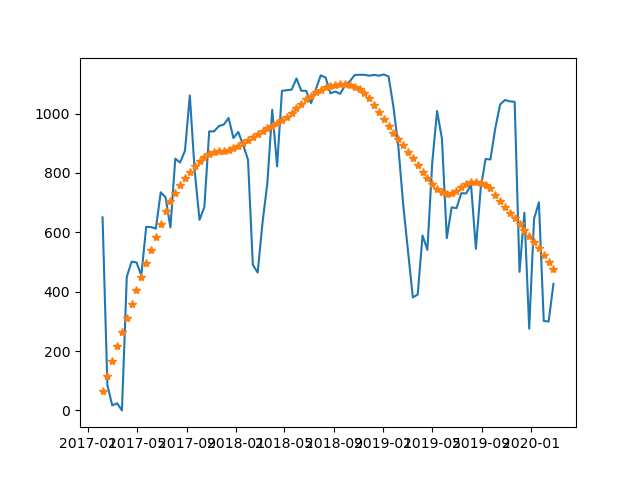

In [56]:
plt.figure()

plt.plot(df["2017-01":'2020-02'].index, df["2017-01":'2020-02'].Area)
plt.plot(df["2017-01":'2020-02'].index, lowess_y, '*')
#plt.plot(xnew, ynew, '-')
#plt.savefig('fast_ice_Area_LOESS.png')
plt.show()

<IPython.core.display.Javascript object>


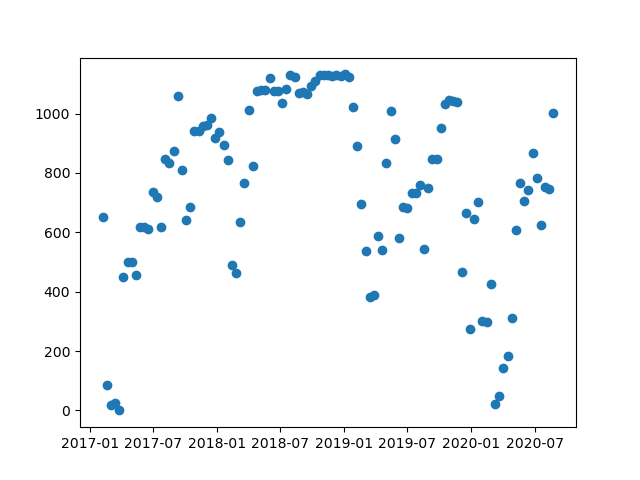

In [57]:
plt.figure()

plt.plot( df.index, df.Area, 'o')

In [58]:
vel_mean_arr = ds_masked.vel.sel(time=slice('2017-01', '2020-02')).mean(dim=['northing', 'easting'])

In [59]:
lowess_v = sm.nonparametric.lowess(vel_mean_arr, df["2017-01":'2020-02'].index, frac=.3)

In [60]:
lowess_v_x = list(zip(*lowess_v))[0]
lowess_v_y = list(zip(*lowess_v))[1]

In [61]:
f = interp1d(lowess_v_x, lowess_v_y, bounds_error=False)

In [62]:
xnew_v = [i/10. for i in range(400)]

In [63]:
ynew_v = f(xnew_v)

<IPython.core.display.Javascript object>


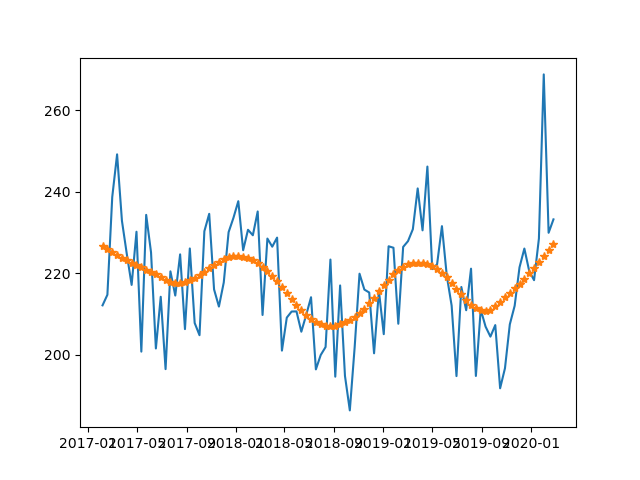

In [64]:
plt.figure()


plt.plot(df["2017-01":'2020-02'].index, vel_mean_arr)
plt.plot(df["2017-01":'2020-02'].index, lowess_v_y, '*')
#plt.plot(xnew, ynew, '-')
plt.savefig('Parker_IT_vel_LOESS.png')

plt.figure()
plt.show()

/home/UOCNT/rag110/anaconda3/envs/GIS/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


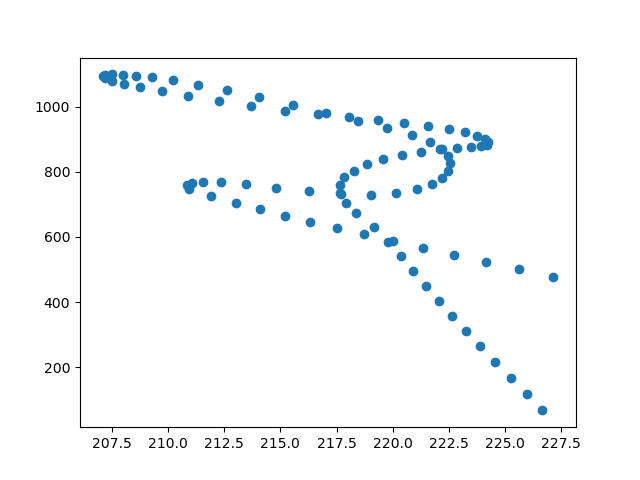

In [65]:
plt.figure()

plt.plot(lowess_v_y, lowess_y, 'o')
#plt.savefig('fast_ice_Area_LOESS vs Parker_IT_vel_LOESS.png')

<IPython.core.display.Javascript object>


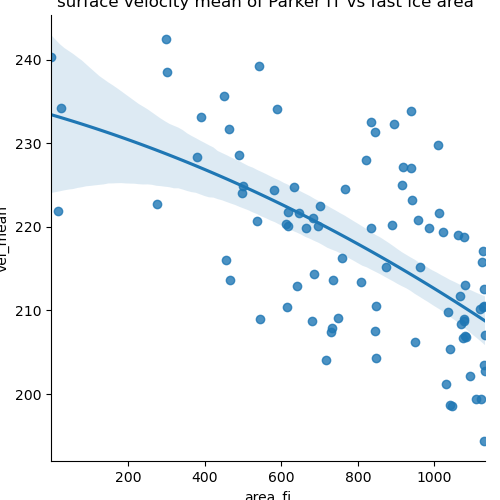

Text(0.5, 1.0, 'surface velocity mean of Parker IT vs fast ice area ')

In [66]:
fig_mean = sns.lmplot(x = 'area_fi', y = 'vel_mean', order=2, data=df_plot)

plt.title('surface velocity mean of Parker IT vs fast ice area ')


#fig_mean.savefig('vel_mean_fi_area.png')

In [67]:
np.corrcoef(vel_mean_arr.values, df["2017-01":'2020-02'].Area)

array([[ 1.        , -0.49534316],
       [-0.49534316,  1.        ]])

In [71]:
import statsmodels.api as sm
df_plot['area_roll3'] = df_plot.area_fi.rolling(3).mean()

In [77]:
np.corrcoef(df_plot.vel_mean[2:], df_plot.area_fi[2:])

array([[ 1.        , -0.60895276],
       [-0.60895276,  1.        ]])

In [76]:
np.corrcoef(df_plot.vel_mean[2:], df_plot.area_roll3[2:])

array([[ 1.        , -0.62433468],
       [-0.62433468,  1.        ]])

In [85]:
Y = df_plot[2:].vel_mean
X = df_plot[2:].area_roll3

In [86]:
X = sm.add_constant(X) # adding a constant

In [87]:
model = sm.OLS(Y, X).fit()
predictions = model.predict(X) 
print_model = model.summary()
print(print_model)


                            OLS Regression Results                            
Dep. Variable:               vel_mean   R-squared:                       0.390
Model:                            OLS   Adj. R-squared:                  0.383
Method:                 Least Squares   F-statistic:                     56.85
Date:                Thu, 17 Jun 2021   Prob (F-statistic):           3.78e-11
Time:                        11:54:35   Log-Likelihood:                -323.31
No. Observations:                  91   AIC:                             650.6
Df Residuals:                      89   BIC:                             655.6
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        238.0879      2.893     82.298      0.0

In [88]:
model.pvalues

const         9.011660e-86
area_roll3    3.776907e-11
dtype: float64

<IPython.core.display.Javascript object>


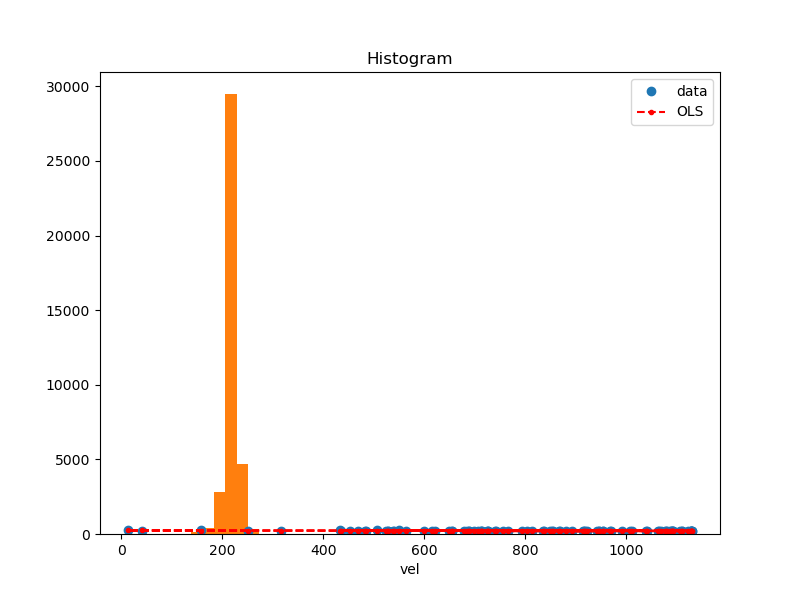

In [89]:
from statsmodels.sandbox.regression.predstd import wls_prediction_std

prstd, iv_l, iv_u = wls_prediction_std(model)

fig, ax = plt.subplots(figsize=(8,6))

ax.plot(X.area_roll3, Y, 'o', label="data")
#ax.plot(x, y_true, 'b-', label="True")
ax.plot(X.area_roll3, model.fittedvalues, 'r--.', label="OLS")
ax.plot(X.area_roll3, iv_u, 'r--')
ax.plot(X.area_roll3, iv_l, 'r--')
ax.legend(loc='best');



<IPython.core.display.Javascript object>


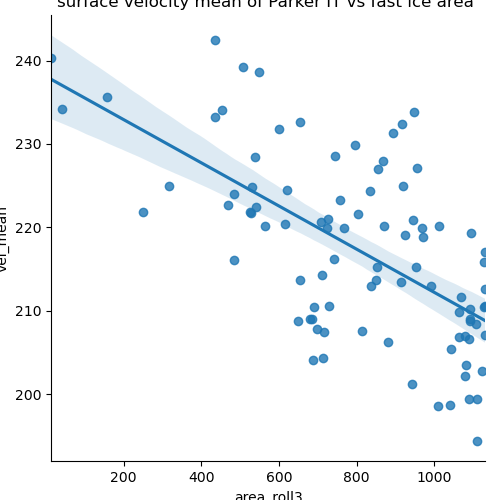

In [155]:
import seaborn as sns

fig_mean = sns.lmplot(x = 'area_roll3', y = 'vel_mean', order=1, data=df_plot)

plt.title('surface velocity mean of Parker IT vs fast ice area ')


fig_mean.savefig('vel_mean_fi_area.png')

<IPython.core.display.Javascript object>


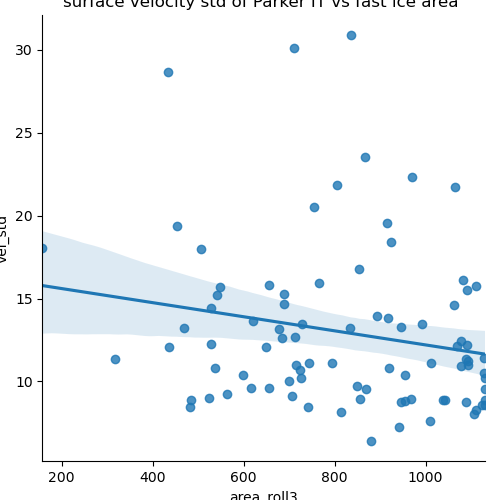

Text(0.5, 1.0, 'surface velocity std of Parker IT vs fast ice area ')

In [159]:

fig_std = sns.lmplot(x = 'area_roll3', y = 'vel_std', order=1, data=df_plot[df_plot['area_fi'] > 200])

plt.title('surface velocity std of Parker IT vs fast ice area ')


#fig_mean.savefig('vel_mean_fi_area.png')

<IPython.core.display.Javascript object>


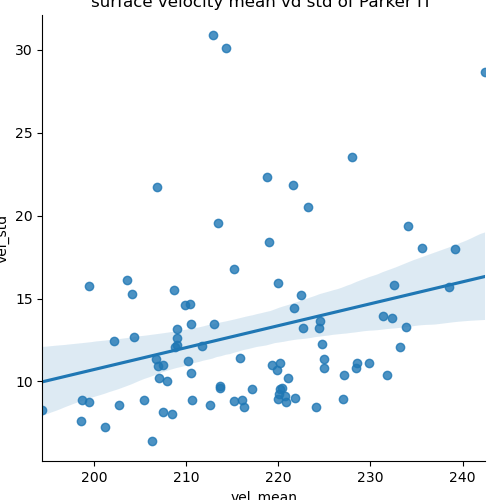

Text(0.5, 1.0, 'surface velocity mean vd std of Parker IT ')

In [160]:

fig_std = sns.lmplot(x = 'vel_mean', y = 'vel_std', order=1, data=df_plot[df_plot['area_fi'] > 200])

plt.title('surface velocity mean vd std of Parker IT ')


#fig_mean.savefig('vel_mean_fi_area.png')

In [127]:
np.nanmin(vel_mean)

194.38346354166666

In [128]:
np.nanmax(vel_mean)

242.44132486979166

In [129]:
np.nanmin(X.area_roll3)

13.642083333333352

In [130]:
np.nanmax(X.area_roll3)

1130.394583333333

In [131]:
np.nanmean(X.area_roll3)

801.1231662087906

In [132]:
df_plot['area_roll3'] = df_plot.area_fi.rolling(3).mean()

In [133]:
df_plot.index = df["2017-01":'2020-02-15'].index

In [134]:
df_plot[df_plot['area_roll3'] > 1000]

,vel_mean,vel_std,area_fi,area_roll3
date_1,,,,
2018-05-19,206.951497,10.927860,1080.680625,1078.651458
2018-05-31,210.156087,11.216881,1118.221250,1092.556250
2018-06-12,209.003866,12.217224,1076.715938,1091.872604
2018-06-24,208.718892,15.492594,1076.715938,1090.551042
2018-07-06,209.877584,14.631084,1035.210625,1062.880833
2018-07-18,206.795268,21.734985,1082.018750,1064.648437
2018-07-30,203.524516,16.118612,1128.826875,1082.018750
2018-08-11,199.453796,15.731970,1121.638750,1110.828125
2018-08-23,208.436442,8.052966,1068.255000,1106.240208


In [135]:
df_plot.area_roll3.plot()

plt.axhline(y=600, color='k', linestyle='--')

In [136]:
df_plot.loc[df_plot['area_roll3']>1000]

,vel_mean,vel_std,area_fi,area_roll3
date_1,,,,
2018-05-19,206.951497,10.927860,1080.680625,1078.651458
2018-05-31,210.156087,11.216881,1118.221250,1092.556250
2018-06-12,209.003866,12.217224,1076.715938,1091.872604
2018-06-24,208.718892,15.492594,1076.715938,1090.551042
2018-07-06,209.877584,14.631084,1035.210625,1062.880833
2018-07-18,206.795268,21.734985,1082.018750,1064.648437
2018-07-30,203.524516,16.118612,1128.826875,1082.018750
2018-08-11,199.453796,15.731970,1121.638750,1110.828125
2018-08-23,208.436442,8.052966,1068.255000,1106.240208


<IPython.core.display.Javascript object>


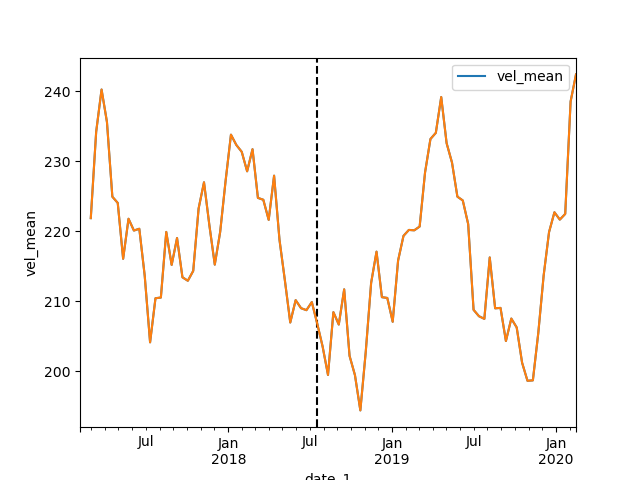

In [149]:
plt.figure()

df_plot.vel_mean.plot()
#plt.axhline(y=230, color='k', linestyle='--')

plt.axvline(x='2018-07-18', color='k', linestyle='--')

plt.show()

In [138]:
df_plot[df_plot['vel_mean']>230]

,vel_mean,vel_std,area_fi,area_roll3
date_1,,,,
2017-03-13,234.231730,43.490580,24.135000,41.992083
2017-03-25,240.278809,33.478739,0.018125,13.642083
2017-04-06,235.625326,18.019816,450.281250,158.144792
2018-01-07,233.822062,13.308927,937.889375,946.786042
2018-01-19,232.343140,13.848755,894.411250,916.589375
2018-01-31,231.366170,13.947817,844.456250,892.252292
2018-02-24,231.747355,10.401198,464.521875,599.670000
2019-03-27,233.196248,12.046248,390.302500,435.743125
2019-04-08,234.080037,19.397441,589.227500,453.383750


In [139]:
df_plot[df_plot['vel_mean']<200]

,vel_mean,vel_std,area_fi,area_roll3
date_1,,,,
2018-08-11,199.453796,15.731970,1121.63875,1110.828125
2018-10-10,199.425741,8.763818,1108.67375,1089.622292
2018-10-22,194.383464,8.297109,1129.84000,1110.705833
2019-10-29,198.619548,7.593407,1045.68875,1008.851250
2019-11-10,198.678243,8.884661,1041.11875,1039.171458


In [140]:
print('Mean:',np.nanmean(df_plot.vel_mean), np.nanstd(df_plot.vel_mean))
print('max/min',np.nanmax(df_plot.vel_mean), np.nanmin(df_plot.vel_mean))

Mean: 217.34578428163638 10.814547177667132
max/min 242.44132486979166 194.38346354166666


In [141]:
(ds_masked.groupby(ds.time.dt.month)
   .mean(dim=['time', 'easting', 'northing'])
    .vel)

<xarray.DataArray 'vel' (month: 12)>
array([224.86838, 232.60275, 230.98544, 208.29019, 217.55203, 196.63226,
       186.85802, 212.06206, 207.53656, 206.81679, 214.10773, 220.7166 ],
      dtype=float32)
Coordinates:
  * month    (month) int64 1 2 3 4 5 6 7 8 9 10 11 12

In [142]:
print(np.mean(df_plot.area_roll3))

801.1231662087906


In [143]:
df_plot['2018']


,vel_mean,vel_std,area_fi,area_roll3
date_1,,,,
2018-01-07,233.822062,13.308927,937.889375,946.786042
2018-01-19,232.343140,13.848755,894.411250,916.589375
2018-01-31,231.366170,13.947817,844.456250,892.252292
2018-02-12,228.578695,11.084010,490.031875,742.966458
2018-02-24,231.747355,10.401198,464.521875,599.670000
2018-03-08,224.780029,12.237213,633.114375,529.222708
2018-03-20,224.510518,13.631269,766.873125,621.503125
2018-04-01,221.630391,21.873250,1012.811250,804.266250
2018-04-13,227.957987,23.562475,822.205000,867.296458


In [144]:
np.nanmean(df_plot['2018'].area_fi)

997.6523958333332

<IPython.core.display.Javascript object>


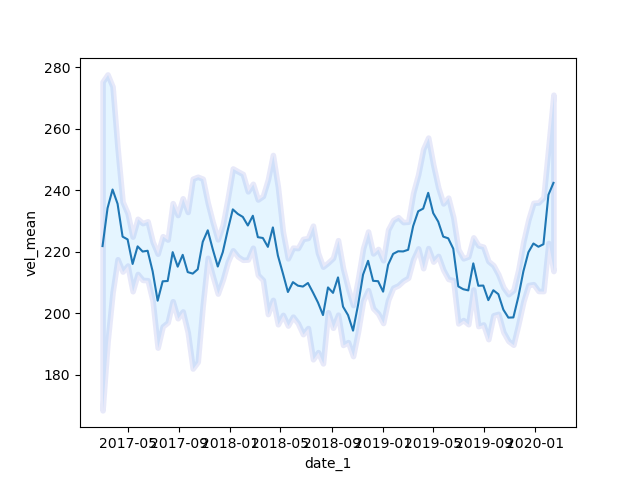

In [147]:
plt.figure()

# plot time series with seaborn
ax = sns.lineplot(data=df_plot.vel_mean) #, err_style="unit_traces")

# Add std deviation bars to the previous plot
mean = df_plot.vel_mean
std  = df_plot.vel_std
#ax.errorbar(df_plot.index, mean, yerr=std) #fmt=None to plot bars only
plt.fill_between(df_plot.index, mean-std, mean+std,
    alpha=0.1, edgecolor='#1B2ACC', facecolor='#089FFF',
    linewidth=4, antialiased=True)
plt.show()

In [150]:
ax = sns.lineplot(data=df_plot.vel_mean, ci='sd') #, err_style="unit_traces")


<IPython.core.display.Javascript object>


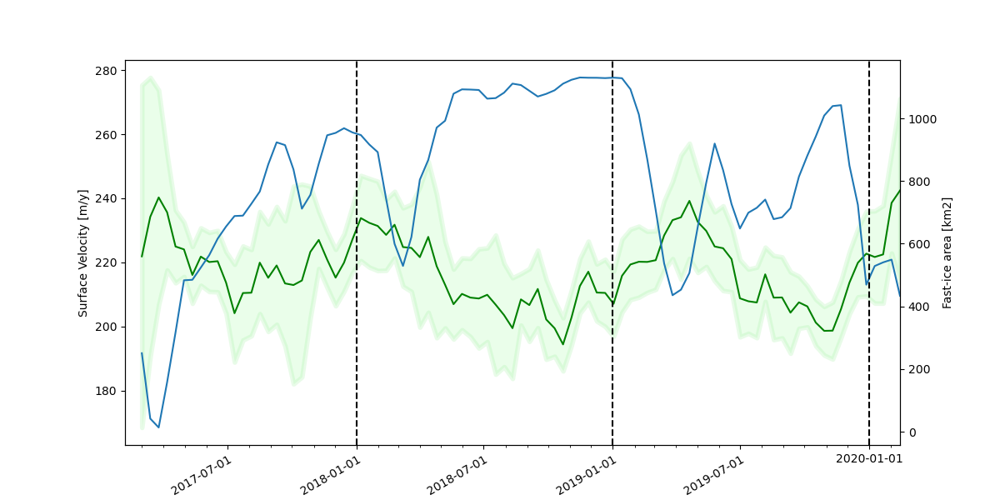

In [151]:
plt.figure(figsize=(12, 6))

ax = plt.gca()
ax = sns.lineplot(data=df_plot.vel_mean, color='green') #, err_style="unit_traces")

# Add std deviation bars to the previous plot
mean = df_plot.vel_mean
std  = df_plot.vel_std
#ax.errorbar(df_plot.index, mean, yerr=std) #fmt=None to plot bars only
plt.fill_between(df_plot.index, mean-std, mean+std,
    alpha=0.2, edgecolor='lightgreen', facecolor='palegreen',
    linewidth=4, antialiased=True)

ax2 = ax.twinx()
ax2 = df_plot.area_roll3.plot()
ax.set_xlabel('Date')
ax.set_ylabel('Surface Velocity [m/y]')
#ax.legend(loc=3)

ax2.set_ylabel('Fast-ice area [km2]')
#plt.title('Fast Ice Area vs velocity ')

#ax2.legend(loc=0)

axvposition = ['2018-01-01', '2019-01-01', '2020-01-01']
for xc in axvposition:
    plt.axvline(x=xc, color='k', linestyle='--')
plt.setp( ax.xaxis.get_majorticklabels(), rotation=30, ha="right", rotation_mode="anchor") 
ax.set_xticks(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])
ax.set_xticklabels(['2017-07-01','2018-01-01','2018-07-01', '2019-01-01','2019-07-01', '2020-01-01'])

plt.savefig('fi_area_and_vel_with_band.png')

plt.show()

In [ ]:
5/len(df_plot.area_roll3)

In [ ]:
df_plot

In [ ]:
294/128

In [ ]:
2.29*64


In [109]:
y_2017 = ds_masked.sel(time=slice('2017-01', '2017-12')).rolling(time=3).mean().groupby("time.month").mean()
y_2018 = ds_masked.sel(time=slice('2018-01', '2018-12')).rolling(time=3).mean().groupby("time.month").mean()
y_2019 = ds_masked.sel(time=slice('2019-01', '2019-12')).rolling(time=3).mean().groupby("time.month").mean()

<IPython.core.display.Javascript object>


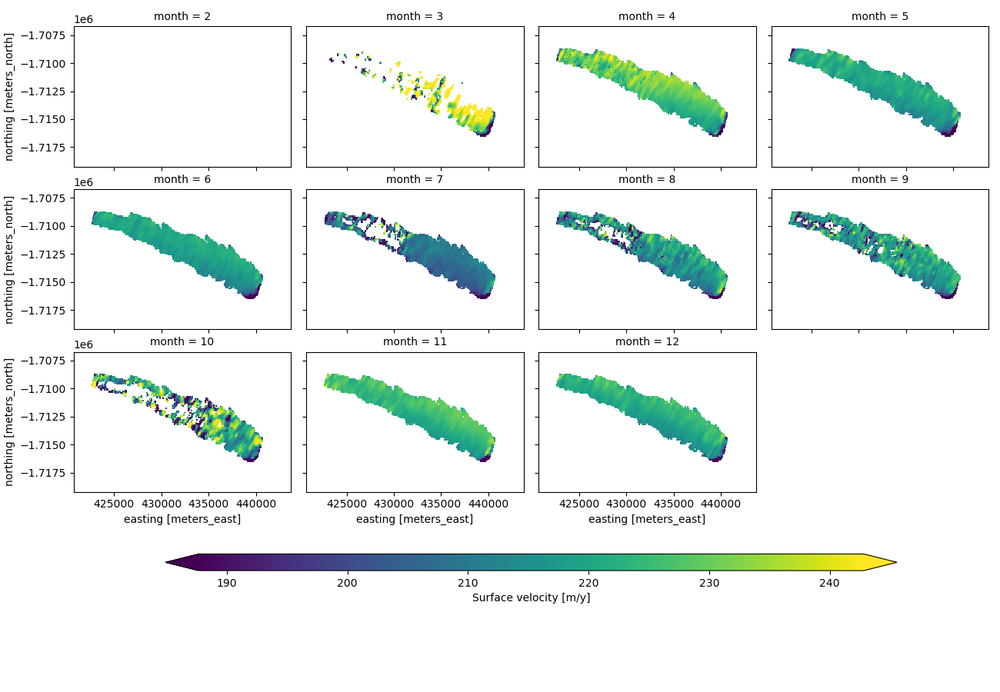

In [113]:
fg = y_2017.vel.plot(
    col="month",
    col_wrap=4,  # each row has a maximum of 4 columns\
    robust =True,
    cbar_kwargs={
        "orientation": "horizontal",
        "shrink": 0.8,
        "aspect": 40,
        "pad": 0.1,
        "label":"Surface velocity [m/y]"
    },
    
)

<IPython.core.display.Javascript object>


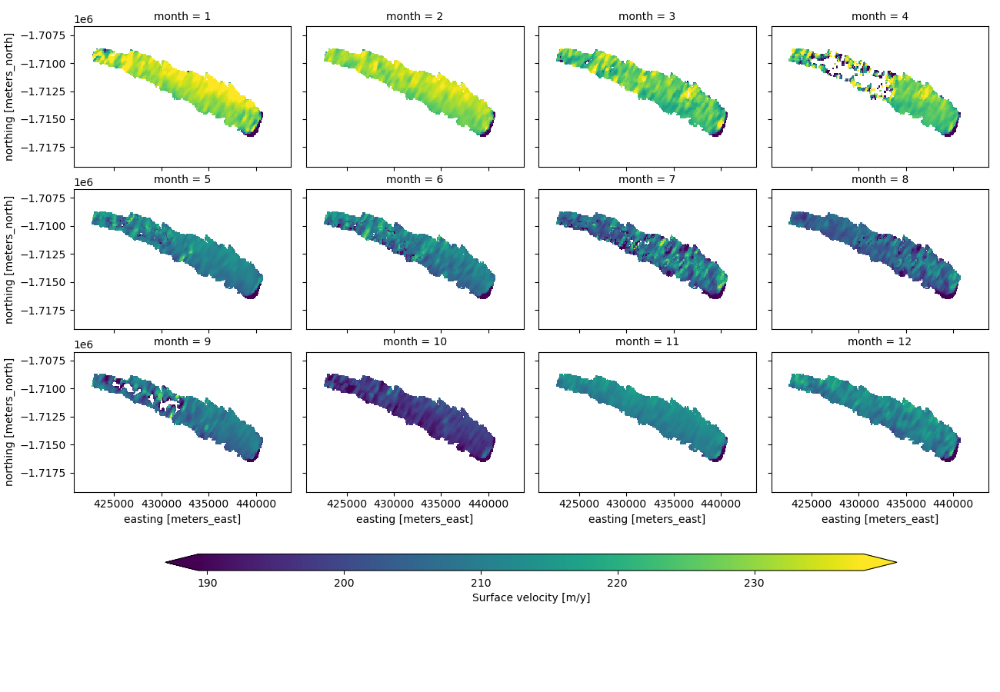

In [114]:
fg = y_2018.vel.plot(
    col="month",
    col_wrap=4,  # each row has a maximum of 4 columns\
    robust =True,
    cbar_kwargs={
        "orientation": "horizontal",
        "shrink": 0.8,
        "aspect": 40,
        "pad": 0.1,
        "label":"Surface velocity [m/y]"
    },
    
)

<IPython.core.display.Javascript object>


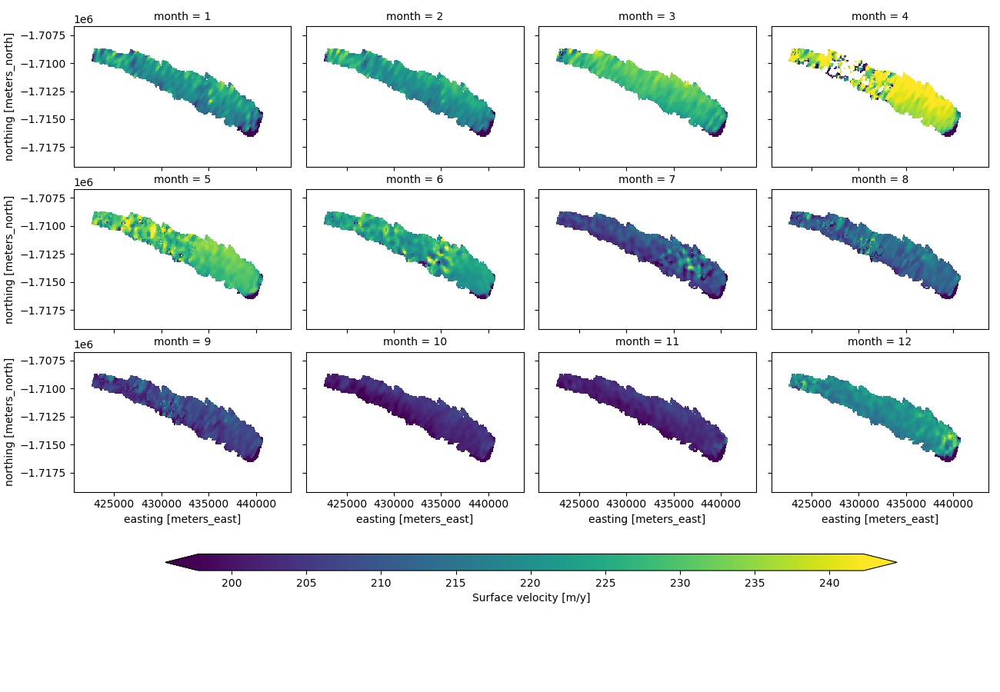

In [115]:
fg = y_2019.vel.plot(
    col="month",
    col_wrap=4,  # each row has a maximum of 4 columns\
    robust =True,
    cbar_kwargs={
        "orientation": "horizontal",
        "shrink": 0.8,
        "aspect": 40,
        "pad": 0.1,
        "label":"Surface velocity [m/y]"
    },
    
)

In [122]:
for i in range(11):
    print(y_2017.vel[i].mean())
    

<xarray.DataArray 'vel' ()>
array(nan)
Coordinates:
    month    int64 2
<xarray.DataArray 'vel' ()>
array(235.98523036)
Coordinates:
    month    int64 3
<xarray.DataArray 'vel' ()>
array(227.46489556)
Coordinates:
    month    int64 4
<xarray.DataArray 'vel' ()>
array(218.93716927)
Coordinates:
    month    int64 5
<xarray.DataArray 'vel' ()>
array(218.04667031)
Coordinates:
    month    int64 6
<xarray.DataArray 'vel' ()>
array(206.93297389)
Coordinates:
    month    int64 7
<xarray.DataArray 'vel' ()>
array(214.74759452)
Coordinates:
    month    int64 8
<xarray.DataArray 'vel' ()>
array(215.94156298)
Coordinates:
    month    int64 9
<xarray.DataArray 'vel' ()>
array(217.53117447)
Coordinates:
    month    int64 10
<xarray.DataArray 'vel' ()>
array(223.93362528)
Coordinates:
    month    int64 11
<xarray.DataArray 'vel' ()>
array(220.77171566)
Coordinates:
    month    int64 12
